AIM: look at target position/direction across firing rates for neurons

Questions I want to answer:
(1) What are the best time-bins to consider? Around Go Cue? Around Reach Peripheral Target?
    (1.a) What time bins have some correlation with direction? 

In [1]:
# to use cd, etc
import sys
import os

import numpy as np
from numpy import linalg, matlib
# save, import and load data
from numpy import asarray, save, load
# needed for some matrix manipulations
import cvxpy as cp
import math 

import scipy
from scipy.io import loadmat  # this is the SciPy module that loads mat-files
# from datetime import datetime, date, time
# import pandas as pd
# import statsmodels.api as sm

import mat73

import matplotlib.pyplot as plt
# for plots
import seaborn
# set up seaborn for the plots
seaborn.set()

# # to save data plots
# from matplotlib.backends.backend_pdf import PdfPages

In [2]:
import matplotlib.pylab as pylab
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
pylab.rcParams.update(params)

In [3]:
# decDir = 'decoderParams_jeev072312_080412.mat'
# nDir is trial-aligned to the go cue and uses all the trial data
nDir = 'catNeuralDat_jeev072312_080412_trE5_B100.mat'
pathDir = '/Volumes/GoogleDrive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev072312_080412'
os.chdir(pathDir)
os.getcwd()

'/Volumes/GoogleDrive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev072312_080412'

In [4]:
n_path = pathDir + '/' + nDir

In [5]:
n_dict = mat73.loadmat(n_path,use_attrdict=True)
n_dict.keys()

dict_keys(['N_bmi', 'N_mc', 'N_norm_bmi', 'N_vfb', 'binvector', 'bmiDay', 'bmiDecoderInd', 'bmiDecoders', 'bmiSessions', 'bmiUnitInds', 'bmiUnitInds_all', 'bmiUnits', 'bmiUnits_all', 'day', 'days', 'mFRs', 'mcDay', 'mcSessions', 'params', 'sdFRs', 'sessID_bmi', 'sessID_mc', 'sessID_vfb', 'sessions', 'trEs_bmi', 'trEs_mc', 'trEs_vfb', 'trTs_bmi', 'trTs_mc', 'trTs_vfb', 'vfbDay', 'vfbSessions'])

In [6]:
# # saving plots
# outpath = "/Users/mmadduri/Documents/PhD/ResearchMaterials/Code/BMI_Model/data/jeev_analysis"
# pp = PdfPages(outpath + 'multipage.pdf')

## Functions

findBMIUnitsOnly: takes in all of neural data dict and the n_bmi matrix in the neural dictionary to output only the n_bmi of units that were in the decoder

In [7]:
def findBmiUnitsOnly(neuronData_dict, neural_bmi_matx):
    # divide by .1 to get firing rates not spike counts (spike counts binned in 100 ms)
#     n_bmi = neuronData_dict['N_bmi']/.1;
#     n_bmi = neuronData_dict['N_norm_bmi']/.1;
    n_bmi = neural_bmi_matx
    # n_bmi = num time bins x num neurons total x trials (total)

    # off by one, python to matlab
   

    # find the units that I care about (bmiUnitsInds_all)
    n_units = neuronData_dict['bmiUnitInds_all'] - 1
    n_units = n_units.astype('int')
#     print(n_units)
    print("Units that we care about:", n_units)

    # should be the same as the number of units in bmiUnitsInds_all
    n_bmiUnits = n_bmi[:, n_units, : ];

    n_shape = n_bmiUnits.shape
    print("shape of n_bmiUnits:", n_shape)
    if n_shape[1] != neuronData_dict['bmiUnitInds_all'].size:
        print("error in converting n_bmiUnits")
        return 0
    else:
        return n_bmiUnits

getTrialByDecoder: 

RETURNS

bmiDecTrial: bmiDecTrial is a trial num x 1 vector that assigs each trial to a decoder

trialsByDecoder: number of trials in each decoder

trialsBySession: number of trials in each session

In [8]:
def getTrialsByDecoder(n_dict):
    # separate into decoders
    sessID_bmi = n_dict['sessID_bmi'] 
    bmiDecInd = n_dict['bmiDecoderInd']
    numTrials = n_dict['trEs_bmi'].shape[0]
    
    print(sessID_bmi)
    print(sessID_bmi.shape)
    print(bmiDecInd)
    print(bmiDecInd.shape)
    print(numTrials)
    numberSession = int(max(sessID_bmi))
    print("Number of Sessions:", numberSession)
    numberDecoders = int(max(bmiDecInd))
    print("Number of Decoders:", numberDecoders)
    bmiDecTrial = np.zeros(numTrials)
    # take value of sessID_bmi --> val_sessID
    # replace with the value of bmiDecInd at index of (val_sessID)

    sessID_bmiOff = sessID_bmi - 1
    bmiDecTrial = bmiDecInd[sessID_bmiOff.astype(int)]

    # print number of trials in each session
    trialsBySession = np.zeros(numberSession)
    trialsByDecoder = np.zeros(numberDecoders)
    for iT in range(numberSession):
        print("Session ID:", iT + 1) # off by one for matlab
        print("Decoder Used: ", int(bmiDecInd[iT]))
    #     print(np.where(sessID_bmiOff == iT)) # also off by one in matlab
        print("Total Number of Trials in Sessions: ", sum(sessID_bmiOff == iT))
        trialsBySession[iT] = sum(sessID_bmiOff == iT)
    #     print(int(bmiDecInd[iT]))
        trialsByDecoder[int(bmiDecInd[iT]) - 1] = trialsByDecoder[int(bmiDecInd[iT]) - 1] + sum(sessID_bmiOff == iT)

    print(trialsByDecoder)

    # bmiDecTrial is a trial num x 1 vector that assigs each trial to a decoder
    plt.plot(bmiDecTrial, '.')
    plt.title("Trials by Decoder Visualization")
    plt.xlabel("Trial Number")
    
    return (bmiDecTrial, trialsByDecoder, trialsBySession)


returnDecoderIndices: 

helper function that returns the starting trial and end trial of each decoder

INPUT:
decoderTrials - output of (n_bmiUnitsDec, bmiTrialsPerDecoder, bmiTrialsPerSession = getTrialsByDecoder(n_dict))

In [9]:
def returnDecoderIndices(decoderTrials, decNumber):
    if decNumber == 1:
        start = 0
    else:
        start = decoderTrials[decNumber-2]
    
    end = start + decoderTrials[decNumber-1]
    return (int(start),int(end))

Return n_BMI with only decoder that we care about

In [10]:
def return_nBMI_decoder(nData, decoderTrials, decNumber):
    startInd, endInd = returnDecoderIndices(decoderTrials, decNumber)
    return nData[:,:, startInd:endInd]

sorts the n_bmi matrix by target

In [11]:
# assume input = time x units x trials (total)
def sortTargetNeuralData(neuralData_timeUnitsTrials, targetsVector):
    print("Starting nData dims", neuralData_timeUnitsTrials.ndim)
    if neuralData_timeUnitsTrials.ndim != 3:
        # assume it's been time-binned
        neuralData_timeUnitsTrials = np.expand_dims(neuralData_timeUnitsTrials, axis = 0)
    print("nData shape", neuralData_timeUnitsTrials.shape)    
    
    # TODO: maybe more efficient way to do this?
    targ1 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 1)[0]]    
    targ2 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 2)[0]]
    targ3 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 3)[0]]
    targ4 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 4)[0]]
    targ5 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 5)[0]]
    targ6 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 6)[0]]    
    targ7 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 7)[0]]
    targ8 = neuralData_timeUnitsTrials[:, :, np.where(targetsVector == 8)[0]]
    
    return (targ1, targ2, targ3, targ4, targ5, targ6, targ7, targ8)

inputs:

(1) time x neurons x trials vector

(2) targVector (1 x trials)

outputs:

targPositionVector = 3 x trials

In [12]:
def TargPositionVector(neuralData_timeUnitsTrials, targetsVector):
    print("Starting nData dims", neuralData_timeUnitsTrials.ndim)
    numTrials = neuralData_timeUnitsTrials.shape[-1]
    targPositionVector = np.zeros((3, numTrials))
    
    for iT in range(8):
        print("target:", iT + 1)
        print("x:",  np.cos(np.pi/4 * iT))
        print("y:",  np.sin(np.pi/4 * iT))
        
        targPositionVector[0, np.where(targetsVector == (iT + 1))[0]] = iT + 1
        targPositionVector[1, np.where(targetsVector == (iT + 1))[0]] = np.cos(np.pi/4 * iT)
        targPositionVector[2, np.where(targetsVector == (iT + 1))[0]] = np.sin(np.pi/4 * iT)
   
    return targPositionVector

Least-squares

In [13]:
# assuming: b = m x 1, x = n x 1
# for brain: Wt = f; A = W, t = x, f = b; m = neurons x 1; n = dims x 1
def findA_leastSquares(b, x, m, n):
    A = cp.Variable((m, n)) # A.value = none here
    cost = cp.sum_squares(A @ x - b)
    prob = cp.Problem(cp.Minimize(cost))
    optimalValue = prob.solve()
    # A.value = something here
    resdVect = A@x-b
#     resdNorm = cp.norm(A @ x - b, p=2).value
    return (A, optimalValue, resdVect)

def findW_leastSquares(firingRate, targPosition, numNeurons, numDim):
    return findA_leastSquares(firingRate, targPosition, numNeurons, numDim)

# def findW_leastSquares(firingRate, targPosition, numNeurons, numDim):
#     return scipy.stats.linregress(targPosition[0,:], firingRate) 

R-squared Function

In [14]:
# n = num neurons, m = number of trials
# y = firing rates measures
# y_estimate = firing rates found from least squares
# def findRsquared(y, y_estimate, n, m):
def findRsquared(y, y_estimate, n):
    # ybar 
    ybar = np.average(y, axis=1) # should be n x 1
    SStot = []
    SSres = []
    for iN in range(n):
        res_avg = y_estimate[iN,:] - ybar[iN]
        res_est = y_estimate[iN,:] - y[iN, :]
        SStot.append(np.dot(res_avg, res_avg))
        SSres.append(np.dot(res_est, res_est))
    SStot = np.asarray(SStot)
    SSres = np.asarray(SSres)
    R2 = 1 - SSres / SStot
    return (R2, SStot, SSres)

Find W matrix from Neural Data

In [15]:
# input: nData, nTargData, numNeurons, numTargDim, trialWindow)
# output:  return (rsquared_, w_estimate)
def findWfromNeuralData(nData, nTargData, numNeurons, numTargDim, trialWindow):
    iterations = int(nData.shape[-1]/trialWindow)
    print("number of iter ", iterations)
    rsquared_ = np.zeros((numNeurons, iterations))

    for iT in range(iterations):
        # window start and stop
        iS = iT*n_tr
        iE = (iT+1)*n_tr

        fr = standardizeArray(nData[:, iS:iE])
        targ = nTargData[:, iS:iE][1:]

        w_estimate, solve, resdVect = findW_leastSquares(fr, targ, numNeurons, numTargDim)
        w_estimate = w_estimate.value
        fs_estimate = w_estimate@targ
#         (R2, SStot, SSres) = findRsquared(fr, fs_estimate, numNeurons, trialWindow)
        (R2, SStot, SSres) = findRsquared(fr, fs_estimate, numNeurons) #, trialWindow)
        R2[R2 < 0] = 0
        rsquared_[:, iT] = R2

    seaborn.heatmap(rsquared_)
    plt.ylabel("Neurons")
    plt.xlabel("Trials in Session")
    plt.title("R-squared of Firing Rates Estimate, # of trials =" + str(n_tr))
    
    return (rsquared_, w_estimate)

Return only successful trials

In [16]:
def findSuccessfulTrials(trEvents, succCol):
#     successIdx = np.where(trEvents[:, 6] == (8 | 9))[0]
    successIdx = np.where( (trEvents[:, succCol] == 8) | (trEvents[:, succCol] == 9) )[0]
    print("success indx shape:", successIdx.shape, "out of total events:", len(trEvents) )
#     return n_bmi[:, :, successIdx]
    return successIdx

In [17]:
def normalizeArray(array_in):
    return (array_in - np.min(array_in))/ (np.max(array_in) - np.min(array_in))    

In [18]:
def standardizeArray(array_in):
    return (array_in - np.mean(array_in))/ (np.max(array_in) - np.min(array_in))    

# Code using functions

In [19]:
n_bmiUnits = findBmiUnitsOnly(n_dict, n_dict['N_norm_bmi']/.1) # divide by .1 to convert spikes/100 ms to Hz

Units that we care about: [ 50  85 105 140 145 215 220 225 270 300 355 395 440 520 545 590 595 610
 635]
shape of n_bmiUnits: (40, 19, 9828)


In [20]:
# NEED TO USE THIS TO SEE THE SUCCESS COLUMN
n_dict['trEs_bmi'][1:10,:]

array([[ 2., 70., 15.,  5.,  6.,  7.,  9., 11.],
       [ 2., 64., 15.,  5.,  6., 12.,  2., 64.],
       [ 2., 64., 15.,  5.,  6., 12.,  2., 64.],
       [ 2., 64., 15.,  5.,  6., 12.,  2., 64.],
       [ 2., 64., 15.,  5.,  6.,  7.,  8.,  2.],
       [ 2., 64., 15.,  5.,  6., 12.,  2., 64.],
       [ 2., 64., 15.,  5.,  6., 12.,  2., 64.],
       [ 2., 67., 15.,  5.,  6., 12.,  2., 67.],
       [ 2., 67., 15.,  5.,  6., 12.,  2., 67.]])

In [21]:
succCol = 6
n_dict['trEs_bmi'][:, succCol]

array([2., 9., 2., ..., 9., 9., 8.])

[ 1.  1.  1. ... 30. 30. 30.]
(9828,)
[1. 1. 1. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 4. 5. 5. 5. 6. 7. 7. 7. 7. 7. 7.
 7. 8. 8. 8. 8. 9.]
(30,)
9828
Number of Sessions: 30
Number of Decoders: 9
Session ID: 1
Decoder Used:  1
Total Number of Trials in Sessions:  17
Session ID: 2
Decoder Used:  1
Total Number of Trials in Sessions:  8
Session ID: 3
Decoder Used:  1
Total Number of Trials in Sessions:  16
Session ID: 4
Decoder Used:  2
Total Number of Trials in Sessions:  337
Session ID: 5
Decoder Used:  2
Total Number of Trials in Sessions:  304
Session ID: 6
Decoder Used:  2
Total Number of Trials in Sessions:  264
Session ID: 7
Decoder Used:  2
Total Number of Trials in Sessions:  432
Session ID: 8
Decoder Used:  2
Total Number of Trials in Sessions:  327
Session ID: 9
Decoder Used:  2
Total Number of Trials in Sessions:  327
Session ID: 10
Decoder Used:  2
Total Number of Trials in Sessions:  65
Session ID: 11
Decoder Used:  3
Total Number of Trials in Sessions:  491
Session ID: 12
Decoder U

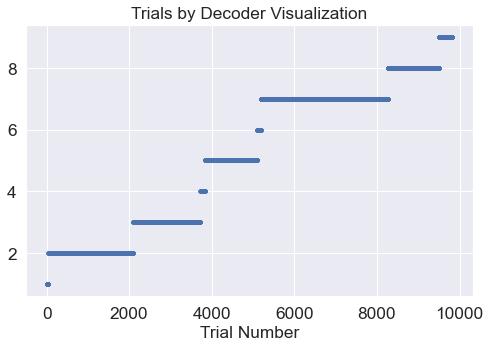

In [22]:
n_bmiUnitsDec, bmiTrialsPerDecoder, bmiTrialsPerSession = getTrialsByDecoder(n_dict)

In [23]:
n_bmiUnitsDec.shape

(9828,)

Dealing with Decoder 2 Only

In [24]:
# start and end trial indices
decNum = 2
startInd, endInd = returnDecoderIndices(bmiTrialsPerDecoder, decNum)
(startInd, endInd)

(41, 2097)

In [25]:
succIdx1 = np.where((n_dict['trEs_bmi'][startInd:endInd, succCol] == 8) | (n_dict['trEs_bmi'][startInd:endInd, succCol] == 9))[0]
succIdx1.shape

(2047,)

In [26]:
trEv = n_dict['trEs_bmi'][startInd:endInd, :]
trEv.shape
succIdx = findSuccessfulTrials(trEv, succCol)
# print(*succIdx)

success indx shape: (2047,) out of total events: 2056


In [27]:
# so looking only at successful neural data during decoder 2

# time bins x bmi units x trials for decoder 2

# nBMI_decoder2 = n_bmiUnits[:,:,startInd:endInd]
nBMI_decoder2 = n_bmiUnits[:,:,startInd+succIdx]

In [28]:
# print(*n_dict['trEs_bmi'][succIdx, targCol])

In [29]:
nBMI_decoder2.shape

(40, 19, 2047)

In [30]:
n_dict['trEs_bmi']

array([[ 2., 70., 15., ..., 12.,  2., 70.],
       [ 2., 70., 15., ...,  7.,  9., 11.],
       [ 2., 64., 15., ..., 12.,  2., 64.],
       ...,
       [ 2., 71., 15., ...,  7.,  9., 11.],
       [ 2., 66., 15., ...,  7.,  9., 11.],
       [ 2., 64., 15., ...,  7.,  8.,  2.]])

Len of targVect 2047
non-targets: [ 639  899 1657 1984]
non-targets: [2006]
Number of non-targets: 5
Num of Trials to Expect: 2042
1
Target 1 :  231.0
2
Target 2 :  202.0
3
Target 3 :  212.0
4
Target 4 :  283.0
5
Target 5 :  315.0
6
Target 6 :  313.0
7
Target 7 :  244.0
8
Target 8 :  242.0
expected number of trials


Text(0.5, 1.0, 'Number of Trials per Target in Decoder2')

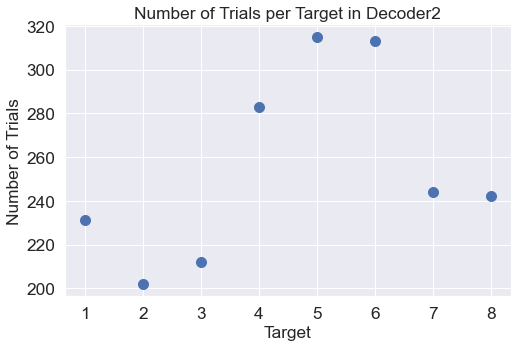

In [31]:
# get the targVector
targCol = 1
targVect = n_dict['trEs_bmi'][startInd+succIdx, targCol] - 63
# targVect = n_dict['trEs_bmi'][startInd:endInd, targCol] - 63
print("Len of targVect", len(targVect))
if (np.any(targVect > 8) or np.any(targVect < 1)):
    print("non-targets:", np.where(targVect > 8)[0])
    print("non-targets:", np.where(targVect < 1)[0])
    print("Number of non-targets:", len(np.where(targVect > 8)[0]) + len(np.where(targVect < 1)[0]))
    print("Num of Trials to Expect:", len(targVect)- (len(np.where(targVect > 8)[0]) + len(np.where(targVect < 1)[0])))
    
targNum = np.zeros(8) 
for iT in range(1, 9, 1):
    print(iT)
    targNum[iT-1] = len(np.where(targVect == iT)[0])
    print("Target", iT, ": ", targNum[iT-1])
sum(targNum)

if (sum(targNum) == len(targVect)- (len(np.where(targVect > 8)[0]) + len(np.where(targVect < 1)[0]))):
    print("expected number of trials")
else:
    print("error somewhere")

plt.plot(np.arange(1,9,1), targNum, '.', markersize = 20)
plt.xlabel("Target")
plt.ylabel("Number of Trials")
plt.title("Number of Trials per Target in Decoder" + str(decNum))

In [32]:
targVect.shape

(2047,)

Text(0.5, 1.0, 'Looking at the targets for trials')

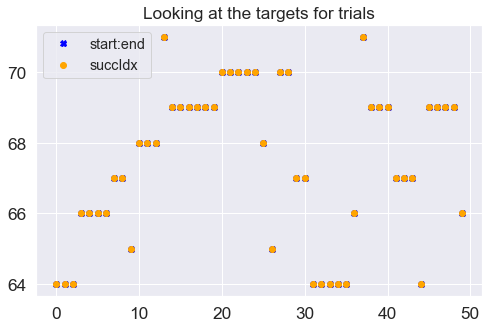

In [33]:
plt.plot(n_dict['trEs_bmi'][startInd:endInd, targCol][0:50], 'X', color='blue', label='start:end')
# plt.ylim((60,80))
# plt.show()
plt.plot(n_dict['trEs_bmi'][startInd+succIdx, targCol][0:50], 'o' , color='orange', label='succIdx')
plt.legend()
plt.title("Looking at the targets for trials")

In [34]:
(n_bmiUnitsT1, n_bmiUnitsT2, n_bmiUnitsT3, n_bmiUnitsT4, n_bmiUnitsT5, n_bmiUnitsT6, n_bmiUnitsT7, n_bmiUnitsT8) = sortTargetNeuralData(nBMI_decoder2[:,:,:], targVect)

# check to see these match
if (n_bmiUnitsT1.shape[-1] != targNum[0]):
    print("error in targ 1")
if (n_bmiUnitsT2.shape[-1] != targNum[1]):
    print("error in targ 2")
if (n_bmiUnitsT3.shape[-1] != targNum[2]):
    print("error in targ 3")
if (n_bmiUnitsT4.shape[-1] != targNum[3]):
    print("error in targ 4")
if (n_bmiUnitsT5.shape[-1] != targNum[4]):
    print("error in targ 5")
if (n_bmiUnitsT6.shape[-1] != targNum[5]):
    print("error in targ 6")
if (n_bmiUnitsT7.shape[-1] != targNum[6]):
    print("error in targ 7")
if (n_bmiUnitsT8.shape[-1] != targNum[7]):
    print("error in targ 8")

Starting nData dims 3
nData shape (40, 19, 2047)


In [35]:
# time bins x bmi neurons x trials in decoder 2n_bmiUnitsT1.shape
n_bmiUnitsT8.shape

(40, 19, 242)

In [36]:
n_dict['binvector']

array([-2.00000000e+00, -1.90000000e+00, -1.80000000e+00, -1.70000000e+00,
       -1.60000000e+00, -1.50000000e+00, -1.40000000e+00, -1.30000000e+00,
       -1.20000000e+00, -1.10000000e+00, -1.00000000e+00, -9.00000000e-01,
       -8.00000000e-01, -7.00000000e-01, -6.00000000e-01, -5.00000000e-01,
       -4.00000000e-01, -3.00000000e-01, -2.00000000e-01, -1.00000000e-01,
       -2.22044605e-16,  1.00000000e-01,  2.00000000e-01,  3.00000000e-01,
        4.00000000e-01,  5.00000000e-01,  6.00000000e-01,  7.00000000e-01,
        8.00000000e-01,  9.00000000e-01,  1.00000000e+00,  1.10000000e+00,
        1.20000000e+00,  1.30000000e+00,  1.40000000e+00,  1.50000000e+00,
        1.60000000e+00,  1.70000000e+00,  1.80000000e+00,  1.90000000e+00])

In [37]:
# Average per trial per time bin per neuron
# 1
n_bmiAvgT1 = np.mean(n_bmiUnitsT1, axis=2)
n_bmiAvgT2 = np.mean(n_bmiUnitsT2, axis=2)
n_bmiAvgT3 = np.mean(n_bmiUnitsT3, axis=2)
n_bmiAvgT4 = np.mean(n_bmiUnitsT4, axis=2)
n_bmiAvgT5 = np.mean(n_bmiUnitsT5, axis=2)
n_bmiAvgT6 = np.mean(n_bmiUnitsT6, axis=2)
n_bmiAvgT7 = np.mean(n_bmiUnitsT7, axis=2)
n_bmiAvgT8 = np.mean(n_bmiUnitsT8, axis=2)

In [38]:
import matplotlib.backends.backend_pdf
outDir = "/Users/mmadduri/Documents/PhD/ResearchMaterials/Code/BMI_Model/data/jeev_analysis/"
outFile = 'output' + nDir + '.pdf'
pdf = matplotlib.backends.backend_pdf.PdfPages(outDir + outFile)

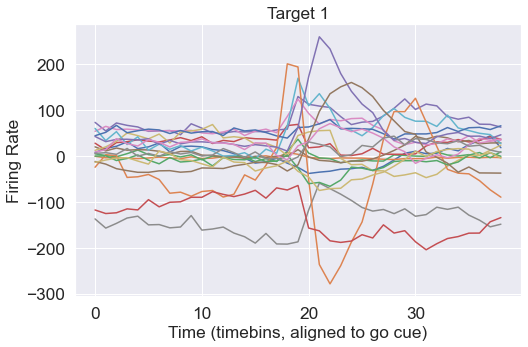

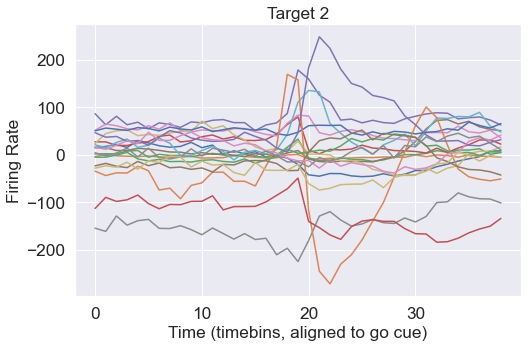

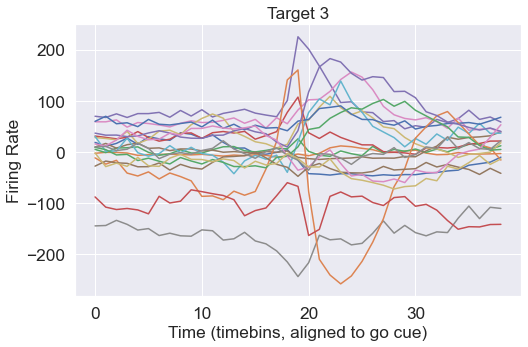

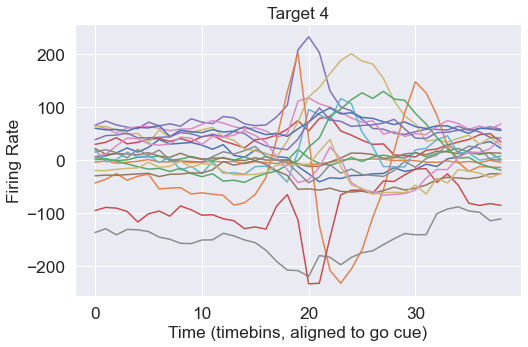

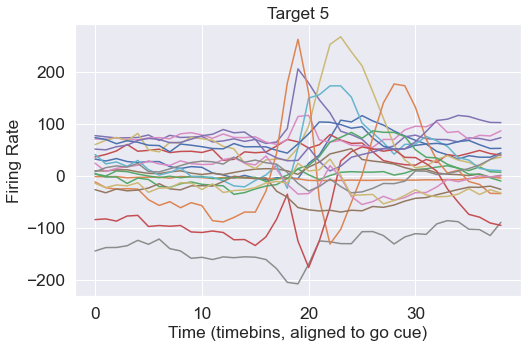

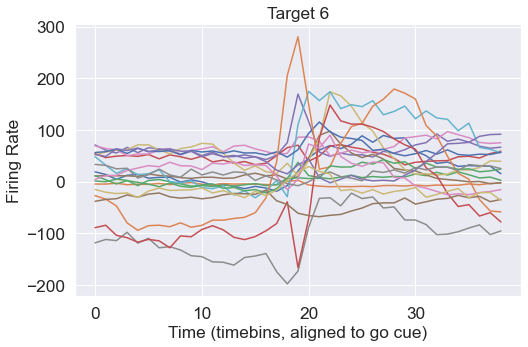

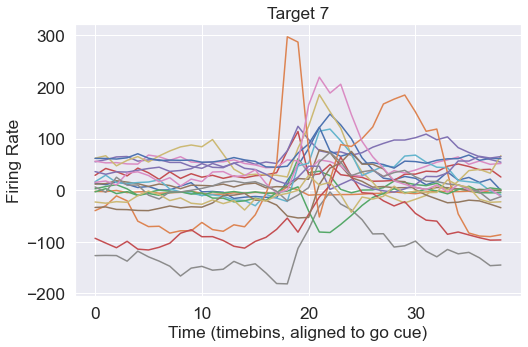

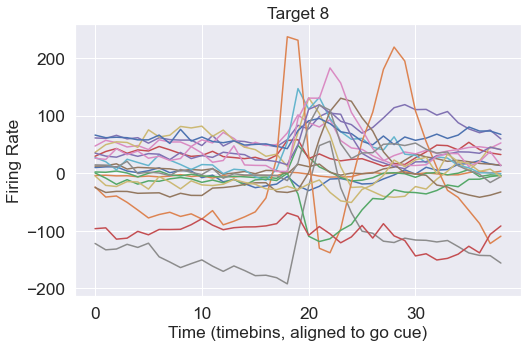

In [39]:
# Plot across time per neuron
plt.plot(n_bmiAvgT1[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 1")
plt.show()

plt.plot(n_bmiAvgT2[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 2")
plt.show()

plt.plot(n_bmiAvgT3[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 3")
plt.show()

plt.plot(n_bmiAvgT4[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 4")
plt.show()

plt.plot(n_bmiAvgT5[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 5")
plt.show()

plt.plot(n_bmiAvgT6[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 6")
plt.show()

plt.plot(n_bmiAvgT7[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 7")
plt.show()

plt.plot(n_bmiAvgT8[:-1,:])
plt.xlabel("Time (timebins, aligned to go cue)")
plt.ylabel("Firing Rate")
plt.title("Target 8")
plt.show()

In [40]:
n_bmiUnitsT8.shape
n_bmiUnitsT8[1,1,:].shape

(242,)

In [41]:
n_dict['binvector']

array([-2.00000000e+00, -1.90000000e+00, -1.80000000e+00, -1.70000000e+00,
       -1.60000000e+00, -1.50000000e+00, -1.40000000e+00, -1.30000000e+00,
       -1.20000000e+00, -1.10000000e+00, -1.00000000e+00, -9.00000000e-01,
       -8.00000000e-01, -7.00000000e-01, -6.00000000e-01, -5.00000000e-01,
       -4.00000000e-01, -3.00000000e-01, -2.00000000e-01, -1.00000000e-01,
       -2.22044605e-16,  1.00000000e-01,  2.00000000e-01,  3.00000000e-01,
        4.00000000e-01,  5.00000000e-01,  6.00000000e-01,  7.00000000e-01,
        8.00000000e-01,  9.00000000e-01,  1.00000000e+00,  1.10000000e+00,
        1.20000000e+00,  1.30000000e+00,  1.40000000e+00,  1.50000000e+00,
        1.60000000e+00,  1.70000000e+00,  1.80000000e+00,  1.90000000e+00])

In [42]:
alignCue = np.where((n_dict['binvector'] < .000001) & (n_dict['binvector'] > -.000001) == 1)[0][0]
print("align cue = ", alignCue)
print("max events = ", len(n_dict['binvector']) )

align cue =  20
max events =  40


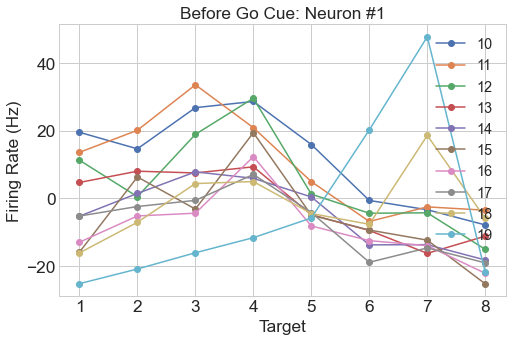

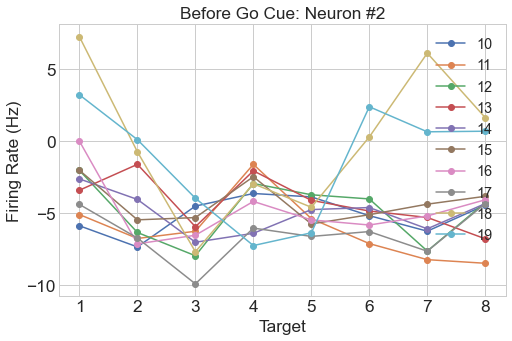

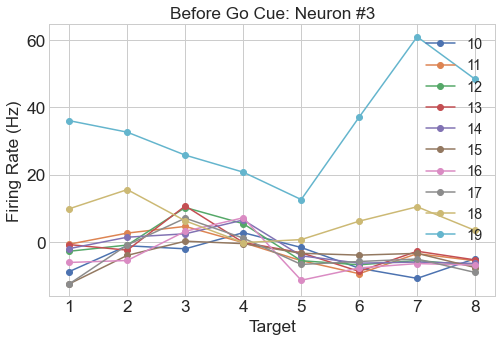

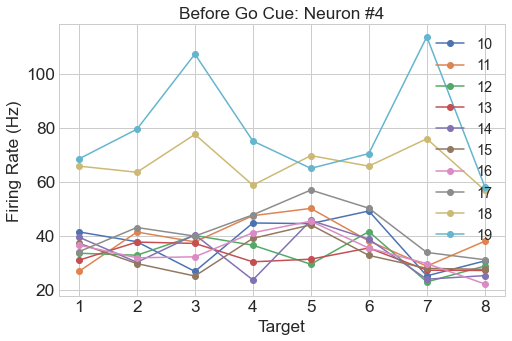

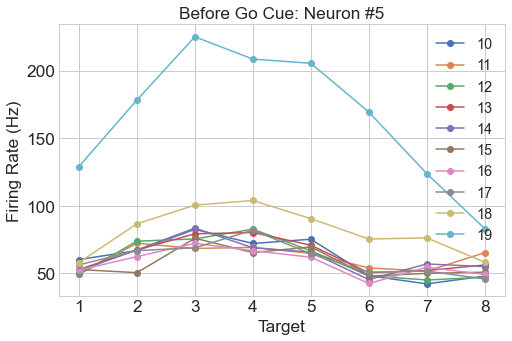

...

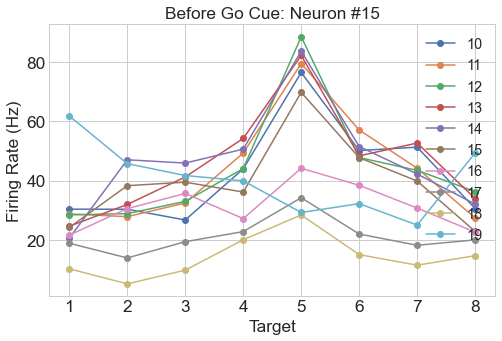

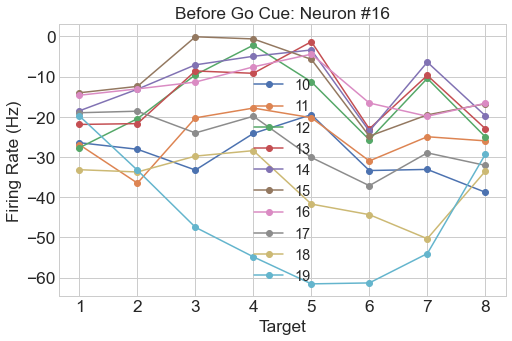

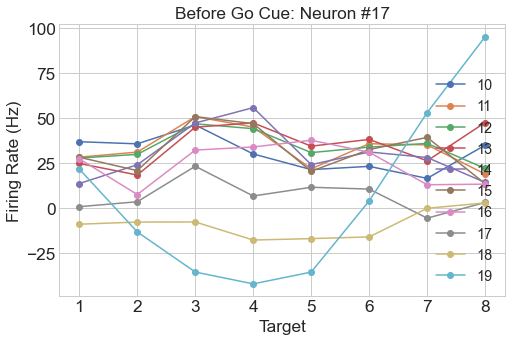

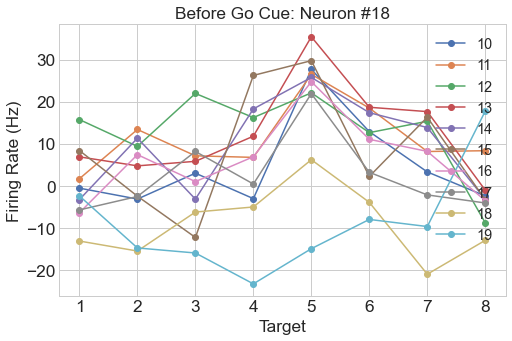

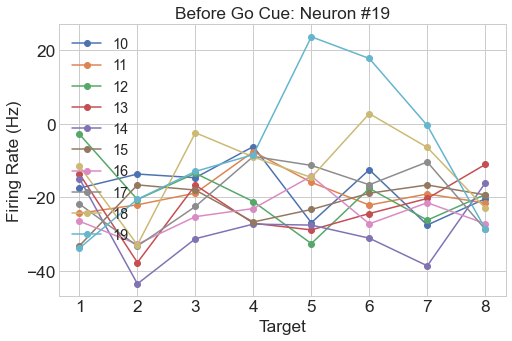

In [43]:
numNeurons = n_bmiUnitsT8.shape[1]

# 10 is the number of time bins
n_bmiTargTime = np.zeros(8)
plt.style.use(plt.style.available[24])


# going through each neuron
for iN in range(numNeurons):
    # for each time bin
    fig = plt.figure()
    for iT in range(alignCue - 10, alignCue, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime, '-o', label=iT)
    plt.title("Before Go Cue: Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Firing Rate (Hz)")
    plt.legend()
    pdf.savefig(fig)




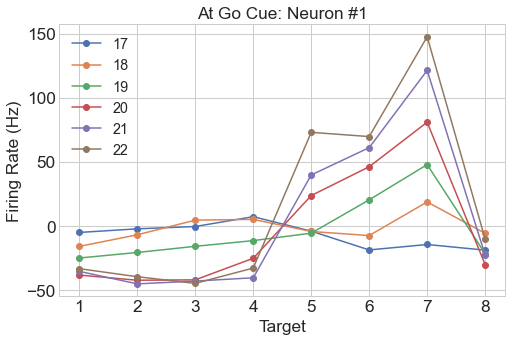

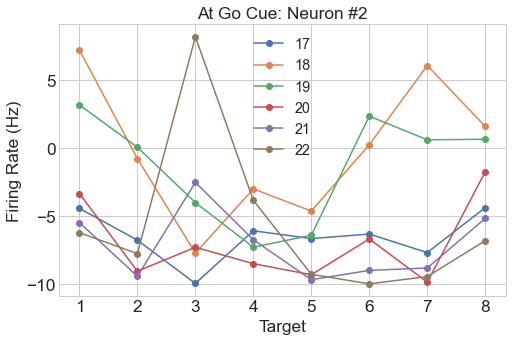

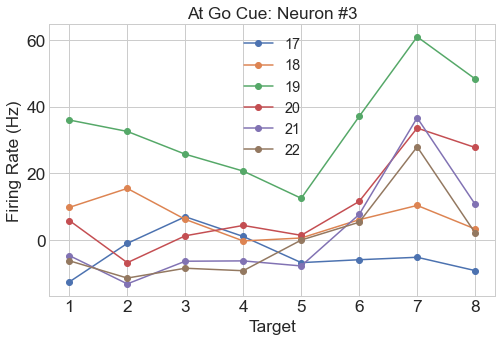

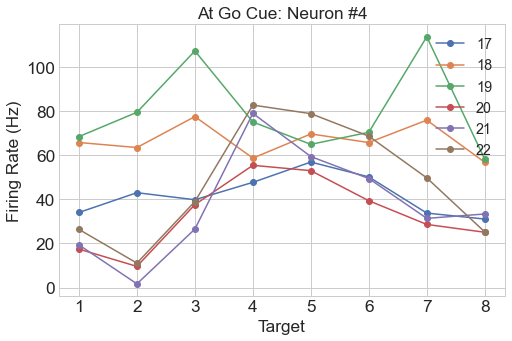

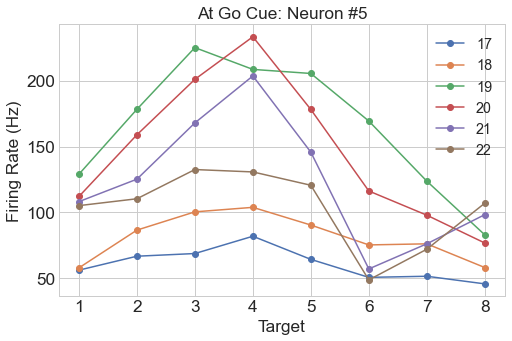

...

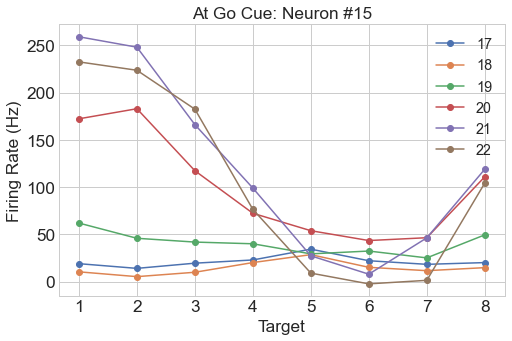

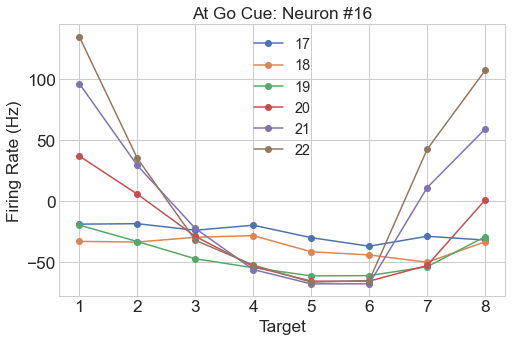

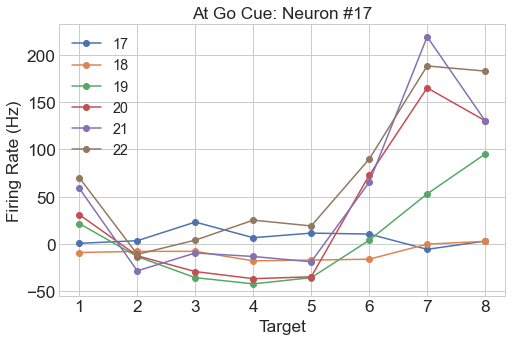

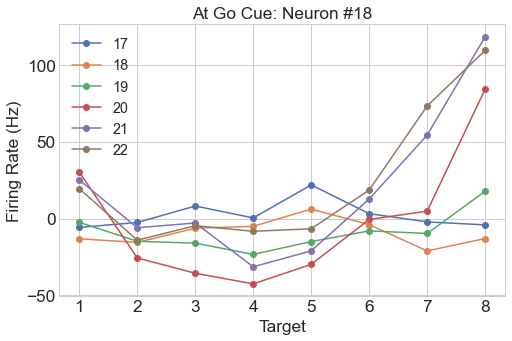

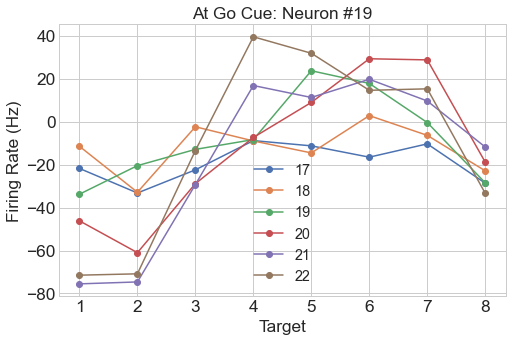

In [44]:
alignCue = np.where((n_dict['binvector'] < .000001) & (n_dict['binvector'] > -.000001) == 1)[0][0]
numNeurons = n_bmiUnitsT8.shape[1]

# 10 is the number of time bins
n_bmiTargTime = np.zeros(8)
plt.style.use(plt.style.available[24])


# going through each neuron
for iN in range(numNeurons):
    # for each time bin
    fig = plt.figure()
    for iT in range(alignCue - 3, alignCue + 3, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime, '-o', label=iT)
#         seaborn.lineplot(data=n_bmiTargTime, x="timepoint", y="signal", hue="event")
    plt.title("At Go Cue: Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Firing Rate (Hz)")
    plt.legend()
    pdf.savefig(fig)

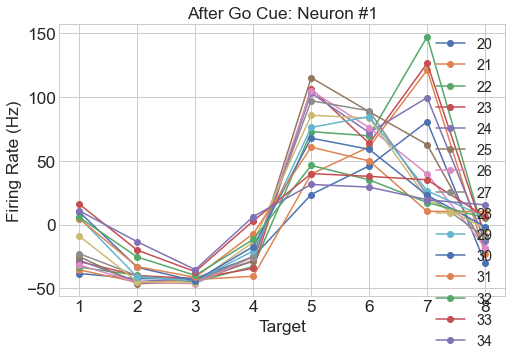

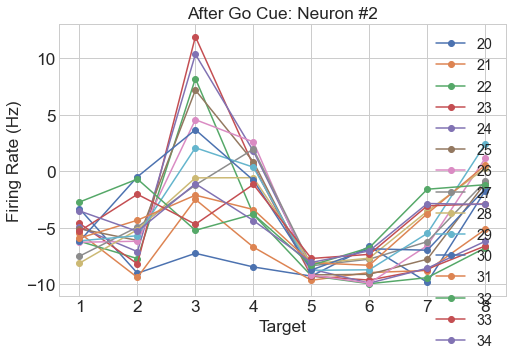

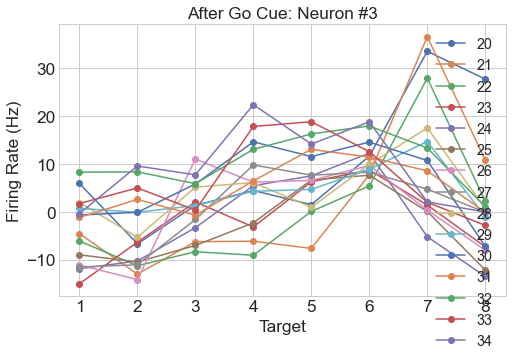

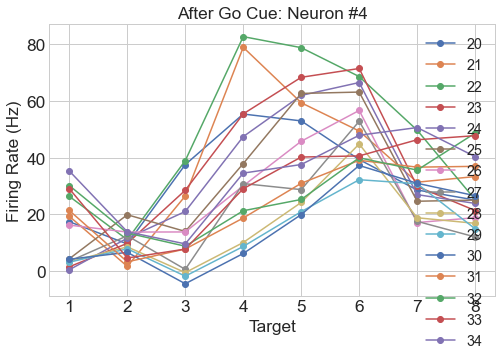

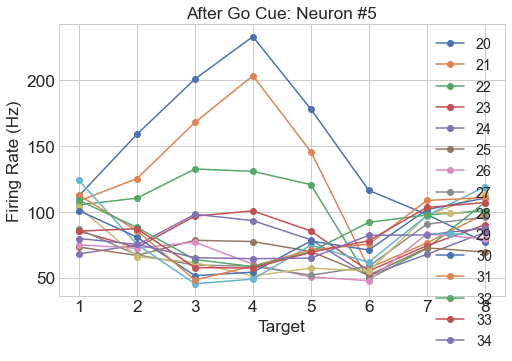

...

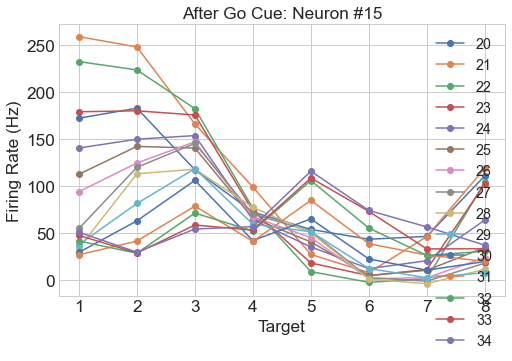

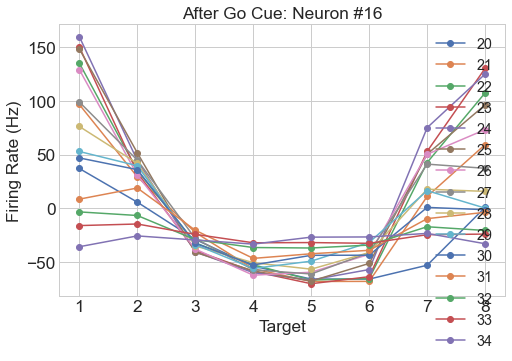

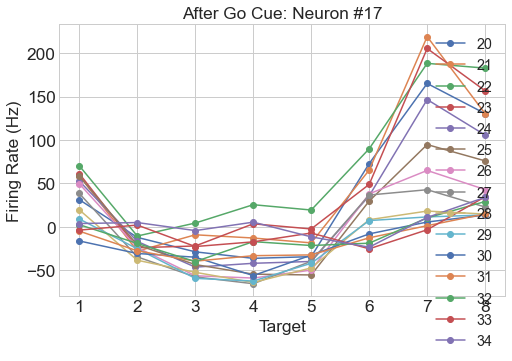

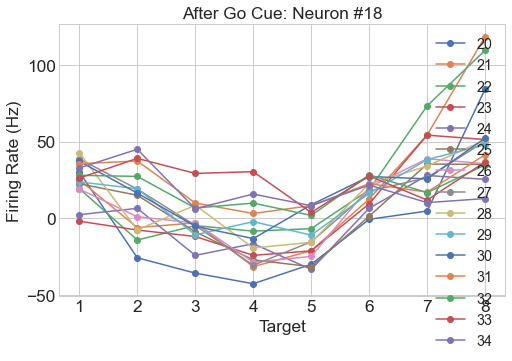

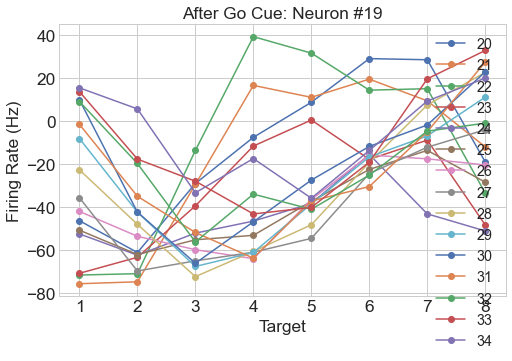

In [45]:
alignCue = np.where((n_dict['binvector'] < .000001) & (n_dict['binvector'] > -.000001) == 1)[0][0]
numNeurons = n_bmiUnitsT8.shape[1]

# 10 is the number of time bins
n_bmiTargTime = np.zeros(8)
plt.style.use(plt.style.available[24])


# going through each neuron
for iN in range(numNeurons):
    # for each time bin
    fig = plt.figure()
    for iT in range(alignCue, alignCue + 15, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime, '-o', label=iT)
#         seaborn.lineplot(data=n_bmiTargTime, x="timepoint", y="signal", hue="event")
    plt.title("After Go Cue: Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Firing Rate (Hz)")
    plt.legend()
    pdf.savefig(fig)

## Measuring Covariance

In [46]:
# time x neurons x trials
n_bmiUnitsT8.shape

(40, 19, 242)

In [47]:
from matplotlib import cm

alignCue = np.where((n_dict['binvector'] < .000001) & (n_dict['binvector'] > -.000001) == 1)[0][0]
numNeurons = n_bmiUnitsT8.shape[1]
numBins = n_bmiUnitsT8.shape[0]

start = 0
stop = 0.4
number_of_lines= numBins
cm_subsection = np.linspace(start, stop, number_of_lines) 

colors = [ cm.jet(x) for x in cm_subsection ]

In [48]:
# colors
numBins

40

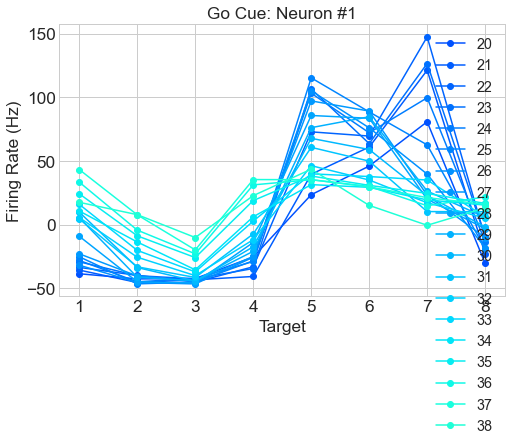

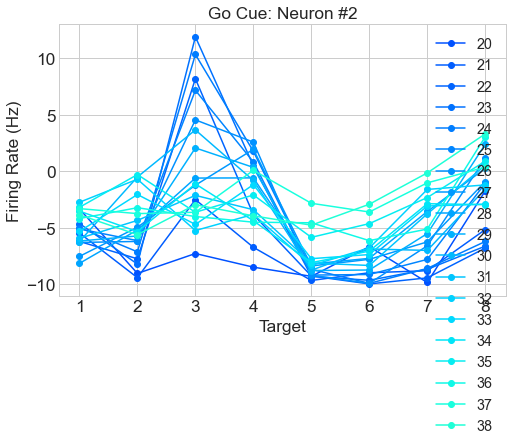

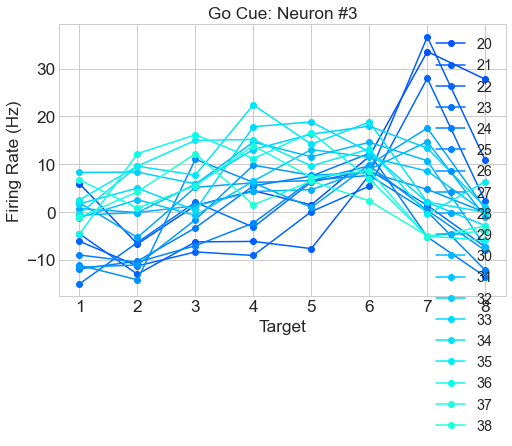

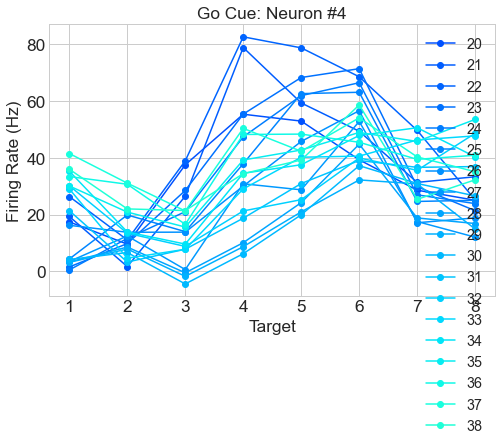

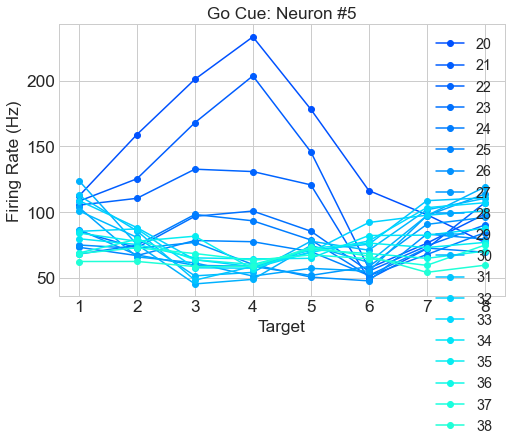

...

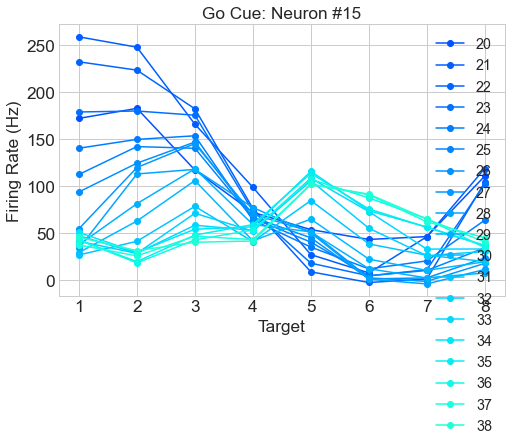

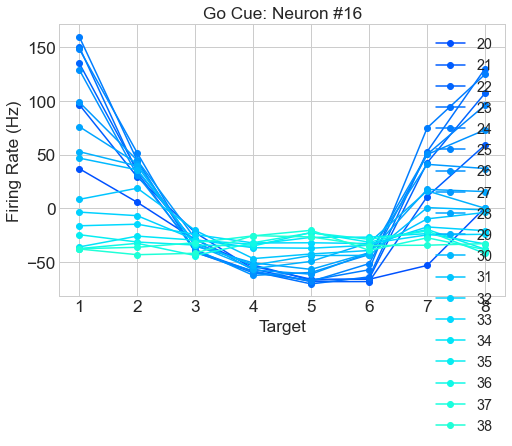

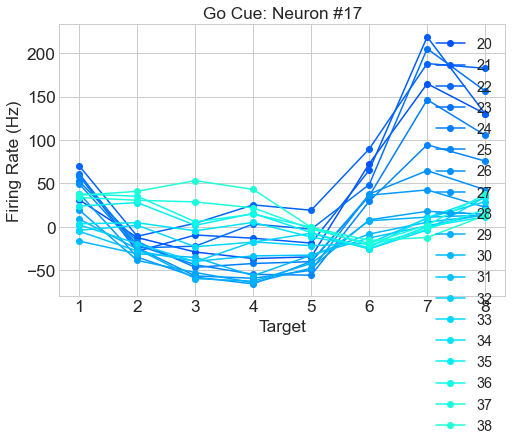

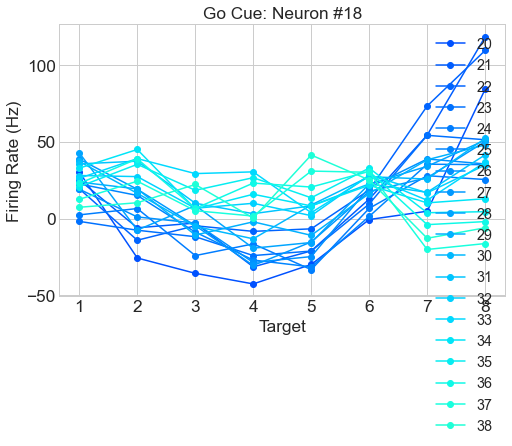

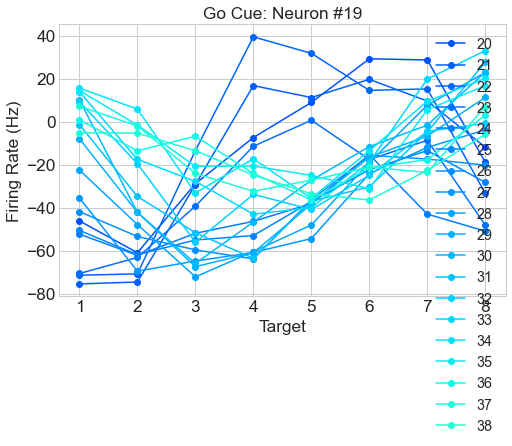

In [49]:
# 10 is the number of time bins
numTarg = 8
n_bmiTargTime = np.zeros(numTarg)
# plt.style.use(plt.style.available[24])


# going through each neuron
for iN in range(numNeurons):
    # for each time bin
    fig = plt.figure()
    for iT in range(alignCue, numBins-1, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime,'-o', color = colors[iT], label=iT)
        
    plt.title("Go Cue: Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Firing Rate (Hz)")
    plt.legend()

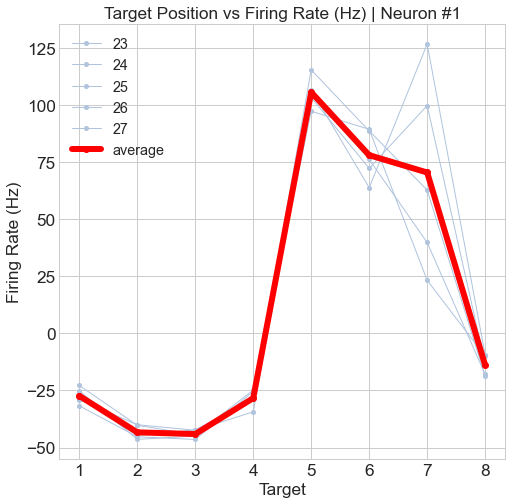

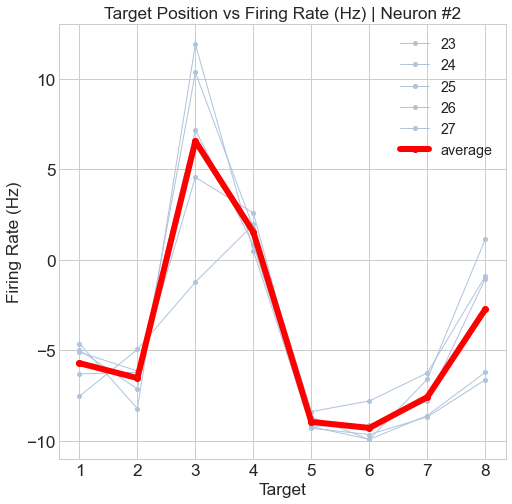

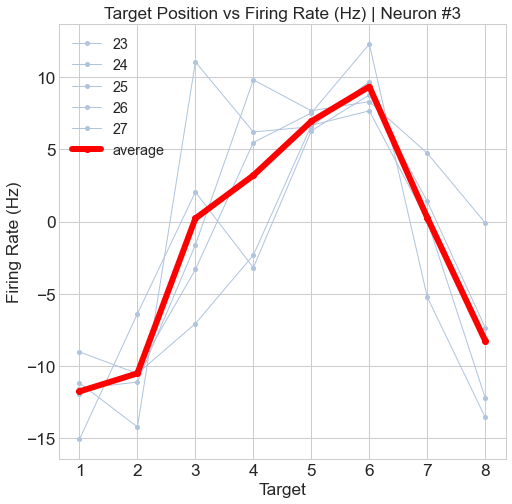

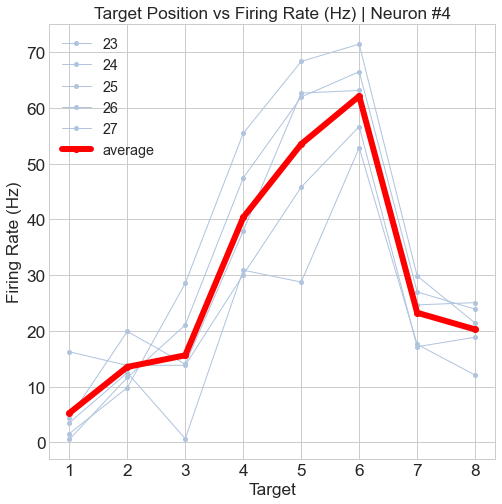

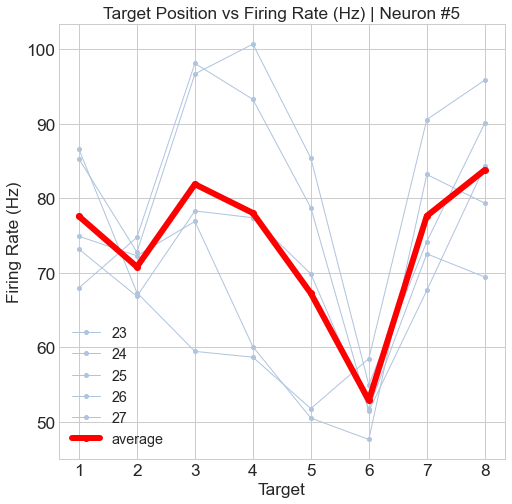

...

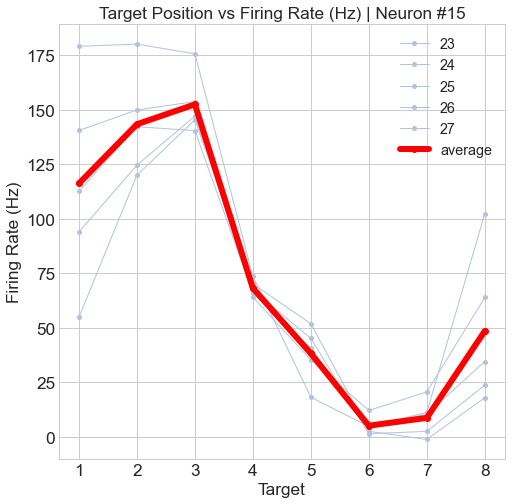

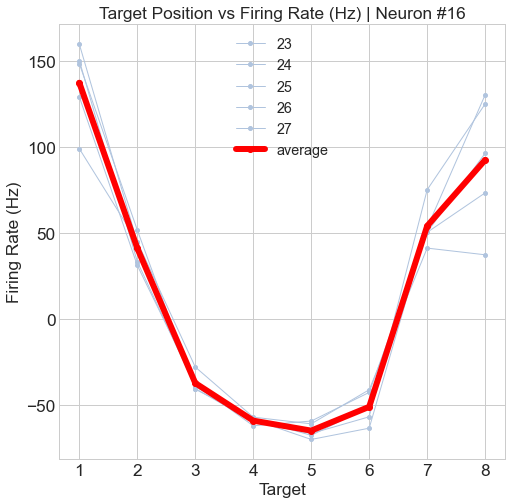

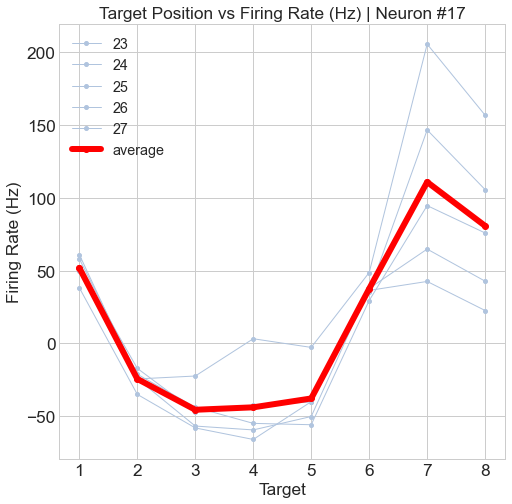

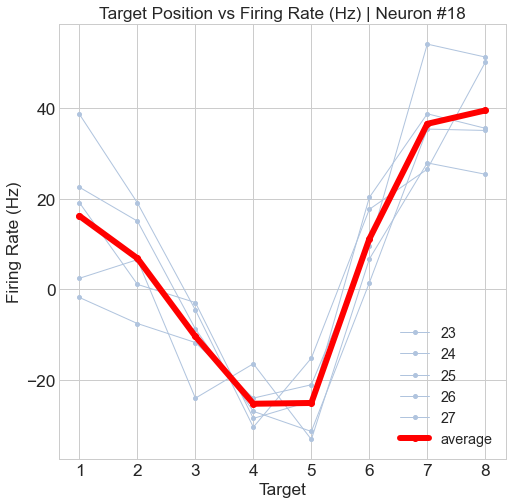

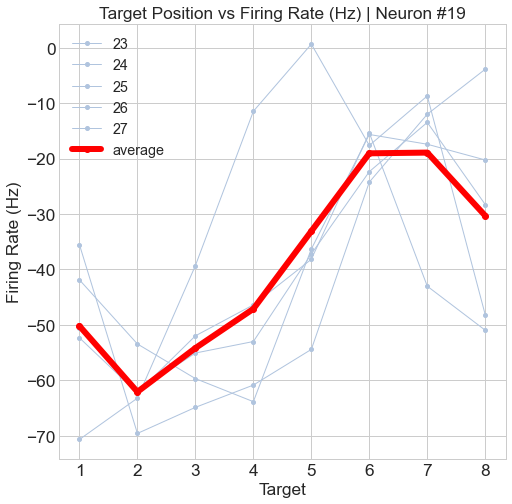

In [50]:
# 10 is the number of time bins
numTarg = 8
# numBins = np.arange(alignCue, numBins-1, 1)
n_bmiTargTime = np.zeros(numTarg)
n_bmiTargSum = np.zeros((numNeurons, numTarg))
# binsArray = np.arange(alignCue, numBins-1, 1) 

# binsArray = np.arange(alignCue, alignCue+10, 1) 
binsArray = np.arange(23, 23+5, 1) 


# plt.style.use(plt.style.available[24])


# going through each neuron
for iN in range(numNeurons):
    # for each time bin
    fig = plt.figure(figsize=(8,8))
#     plt.subplot(1, 2, 1)
    for iT in binsArray:
    # 40 x neurons x trials 
    
        n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime,'-o', color = 'lightsteelblue', markersize=4, linewidth= 1,label=iT)
        n_bmiTargSum[iN] = n_bmiTargSum[iN] + n_bmiTargTime  
        
#     plt.title("Go Cue: Neuron #" + str(iN+1))
#     plt.xlabel("Target")
#     plt.ylabel("Firing Rate (Hz)")
    plt.legend()
#     plt.subplot(1, 2, 2)
    plt.plot(np.arange(1,9,1), n_bmiTargSum[iN]/(len(binsArray)),'-o', color ='red', linewidth=6, label='average')
#     seaborn.heatmap(n_bmiTargTime, fmt='g')
    #     plt.plot(np.arange(1,9,1), n_bmiTargTime,'-o', color = colors[iT], label=iT)
# #                  color = '' + str(iT/numBins), label=iT)
# #         seaborn.lineplot(data=n_bmiTargTime, x="timepoint", y="signal", hue="event")
    plt.title("Target Position vs Firing Rate (Hz) | Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Firing Rate (Hz)")
    plt.legend()
#     pdf.savefig(fig)

In [51]:
binsArray = np.arange(alignCue, numBins-1, 1) 
binsArray
for iT in binsArray:
    print(iT)

20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38


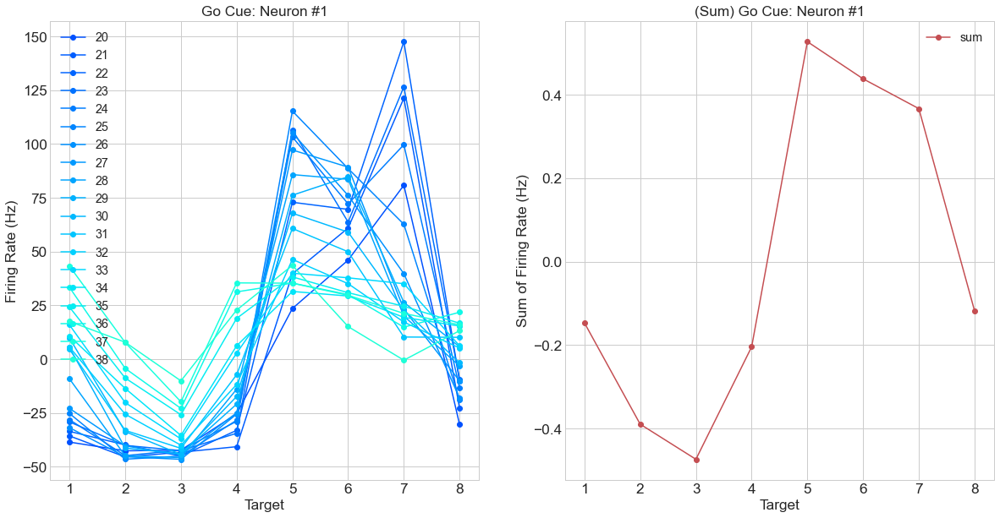

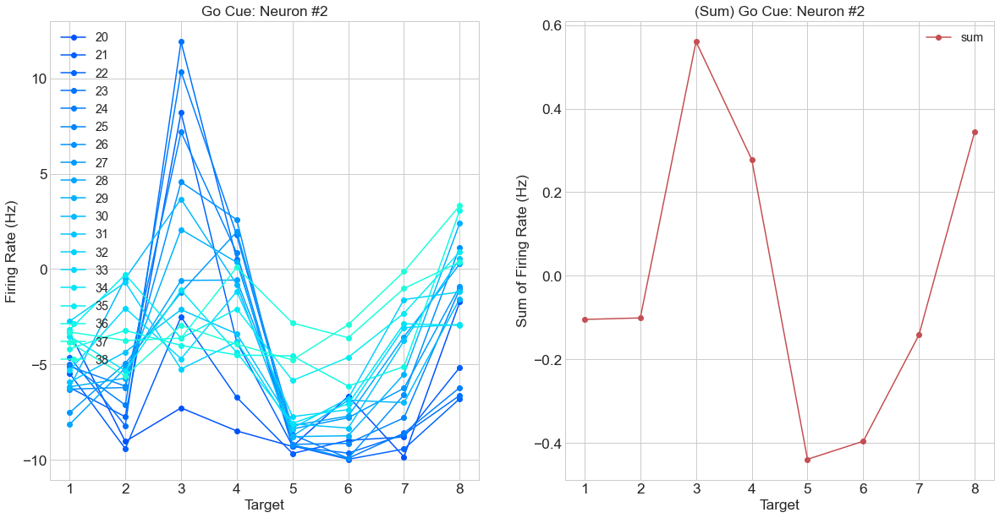

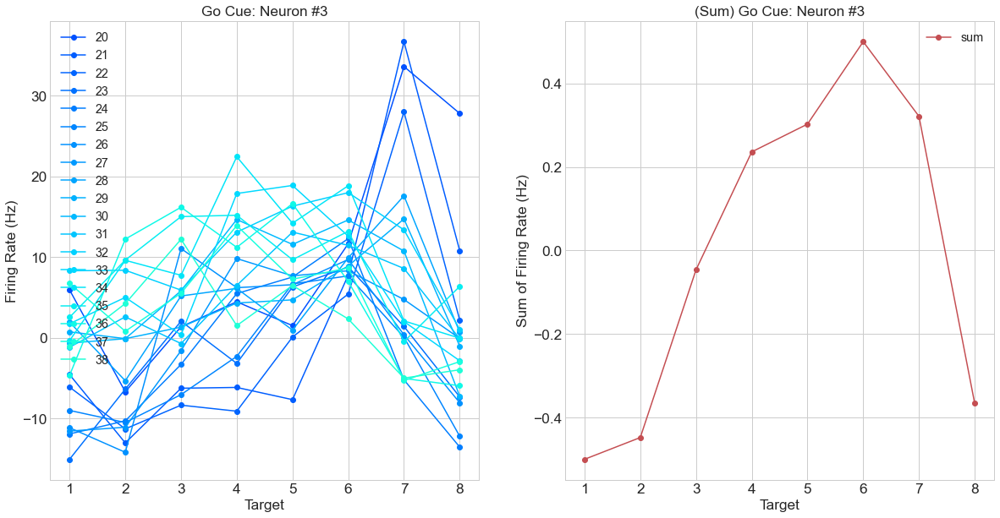

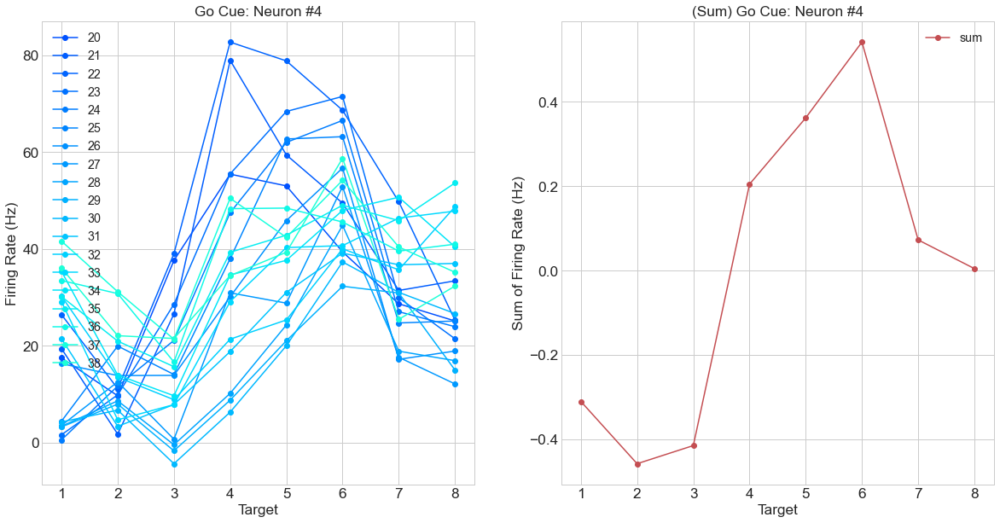

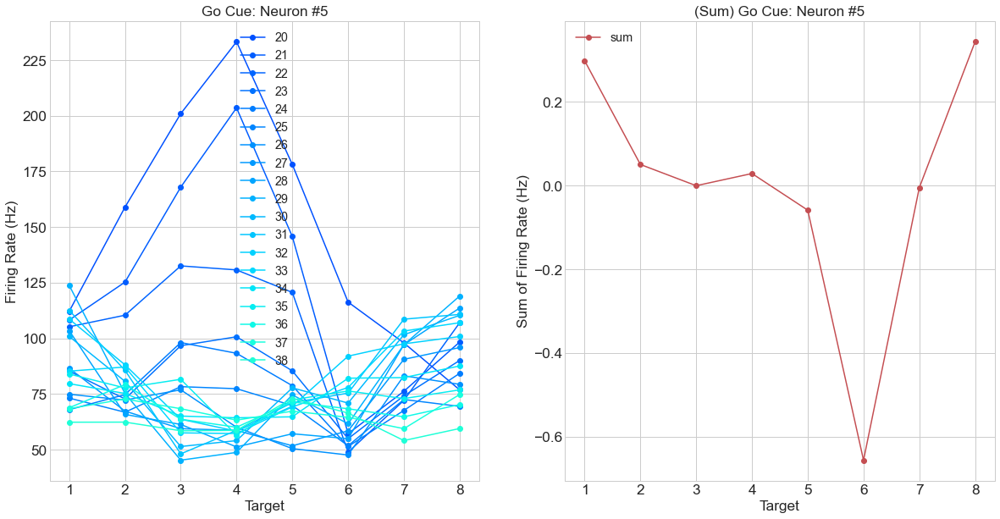

...

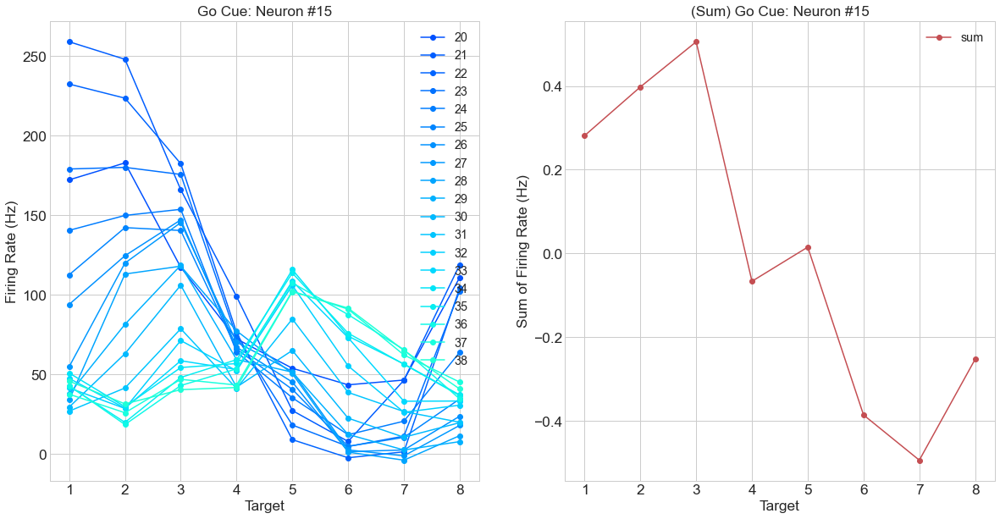

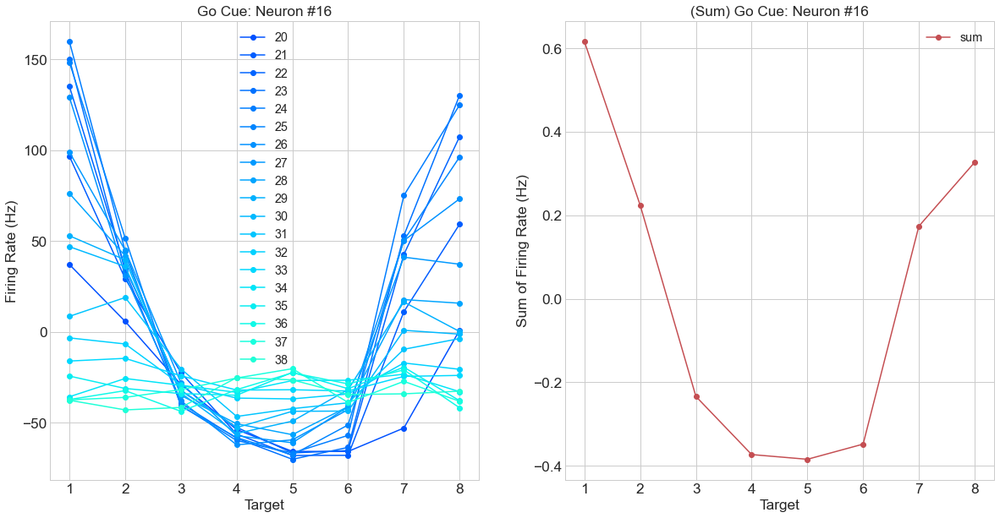

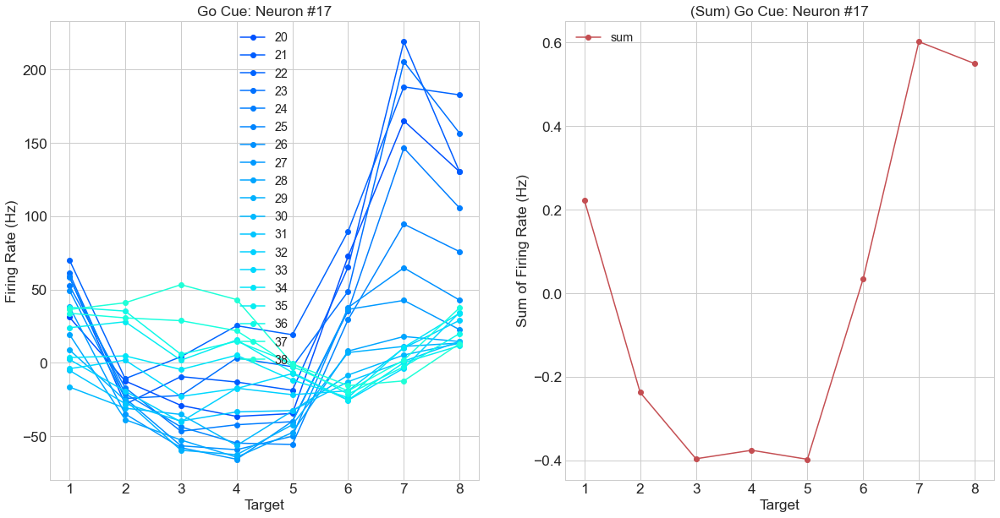

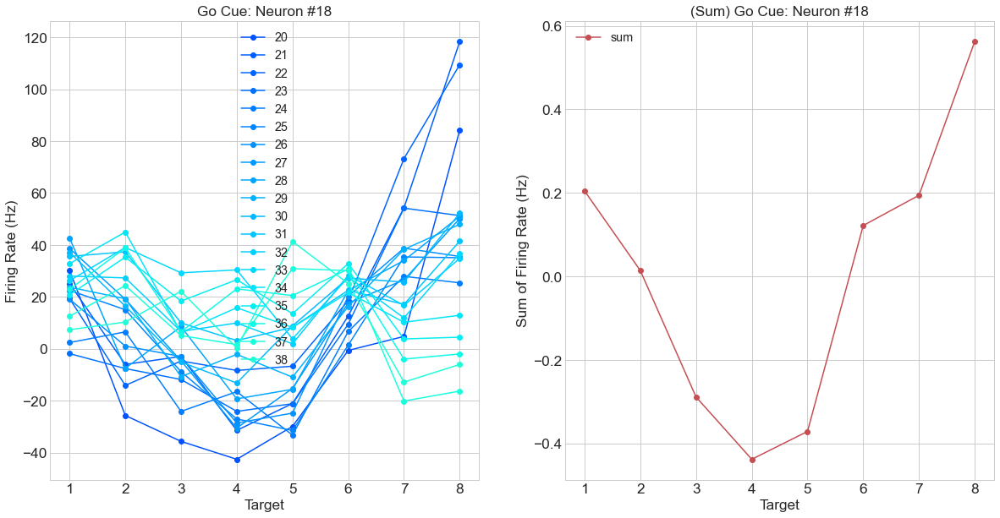

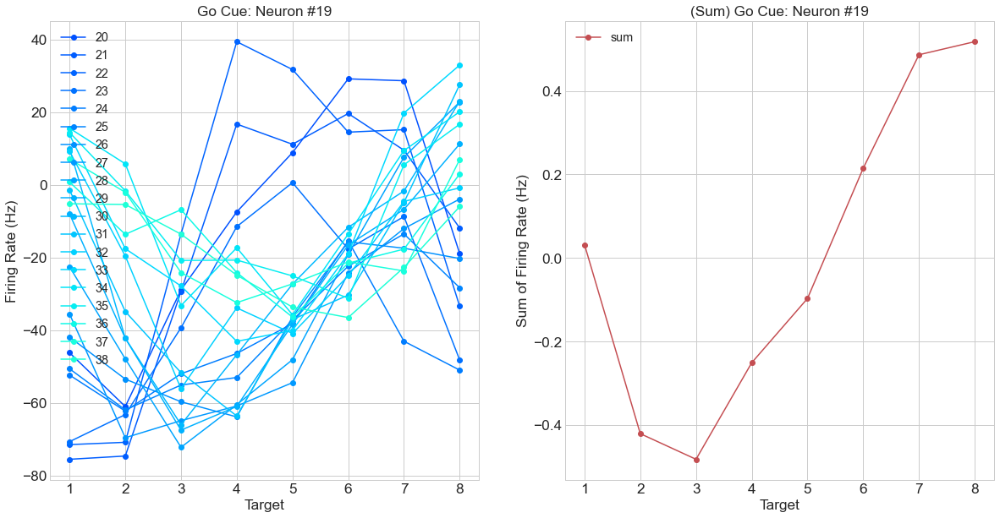

In [52]:
# 10 is the number of time bins
numTarg = 8
n_bmiTargTime = np.zeros(numTarg)
n_bmiTargSum = np.zeros((numNeurons, numTarg))

# plt.style.use(plt.style.available[24])


# going through each neuron
for iN in range(numNeurons):
    # for each time bin
    fig = plt.figure(figsize=(20,10))
    plt.subplot(1, 2, 1)
    for iT in range(alignCue, numBins-1, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime,'-o', color = colors[iT], label=iT)
        n_bmiTargSum[iN] = n_bmiTargSum[iN] + n_bmiTargTime  
        
    plt.title("Go Cue: Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Firing Rate (Hz)")
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.plot(np.arange(1,9,1), standardizeArray(n_bmiTargSum[iN]),'-o', color ='r', label='sum')
#     seaborn.heatmap(n_bmiTargTime, fmt='g')
    #     plt.plot(np.arange(1,9,1), n_bmiTargTime,'-o', color = colors[iT], label=iT)
# #                  color = '' + str(iT/numBins), label=iT)
# #         seaborn.lineplot(data=n_bmiTargTime, x="timepoint", y="signal", hue="event")
    plt.title("(Sum) Go Cue: Neuron #" + str(iN+1))
    plt.xlabel("Target")
    plt.ylabel("Sum of Firing Rate (Hz)")
    plt.legend()
#     pdf.savefig(fig)

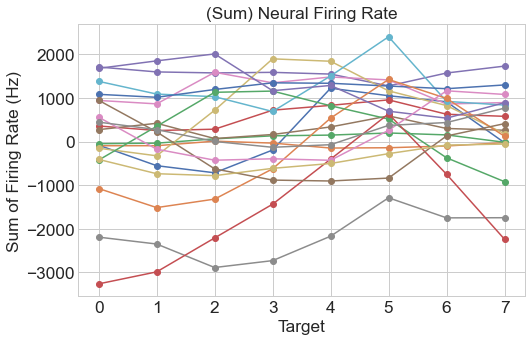

In [53]:
 # looking at the sum of firing rate
plt.title("(Sum) Neural Firing Rate")
plt.xlabel("Target")
plt.ylabel("Sum of Firing Rate (Hz)")
plt.plot(n_bmiTargSum.T,'-o')

normalization: x_norm = (x - x_min)/(x_max - x_min)

[0.         0.78539816 1.57079633 2.35619449 3.14159265 3.92699082
 4.71238898 5.49778714]


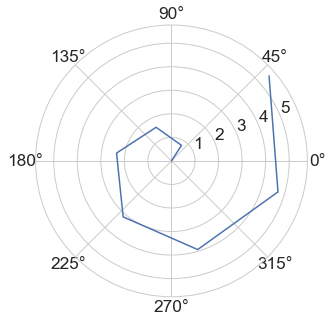

In [54]:
fig=plt.figure()
axe=fig.gca(polar=True)
thetas=np.linspace(0, (7/4)*np.pi, 8)
print(thetas)
# rhos=3+np.cos(5*thetas)
# rhos = np.ones((8,1))*1
axe.plot(thetas)

xT=plt.xticks()[0]
xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
    r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
# plt.xticks(xT, xL)


plt.show()



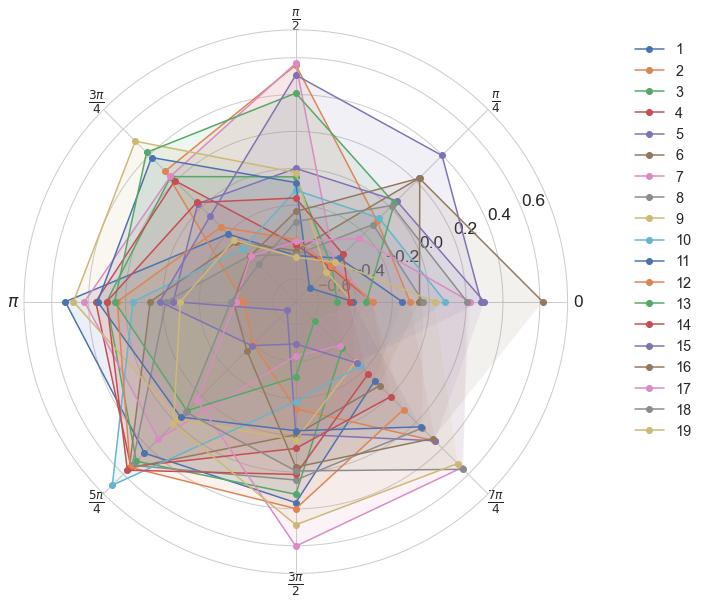

In [55]:
n_bmiTargNorm = np.zeros_like(n_bmiTargSum)


fig=plt.figure(figsize = (10, 10))
axe=fig.gca(polar=True)
thetas=np.linspace(0, (7/4)*np.pi, 8)

# per neuron
# fig = plt.figure(figsize = (10, 8))
for iN in range(numNeurons):
    test = n_bmiTargSum[iN]
#     n_bmiTargNorm[iN] = normalizeArray(test)
    n_bmiTargNorm[iN] = standardizeArray(test)
    axe.plot(thetas, n_bmiTargNorm[iN], '-o', label = iN + 1)
    axe.fill(thetas, n_bmiTargNorm[iN], alpha=0.1)

# xT=plt.xticks()[0]
xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
    r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
plt.xticks(xT, xL)
plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))

plt.show()

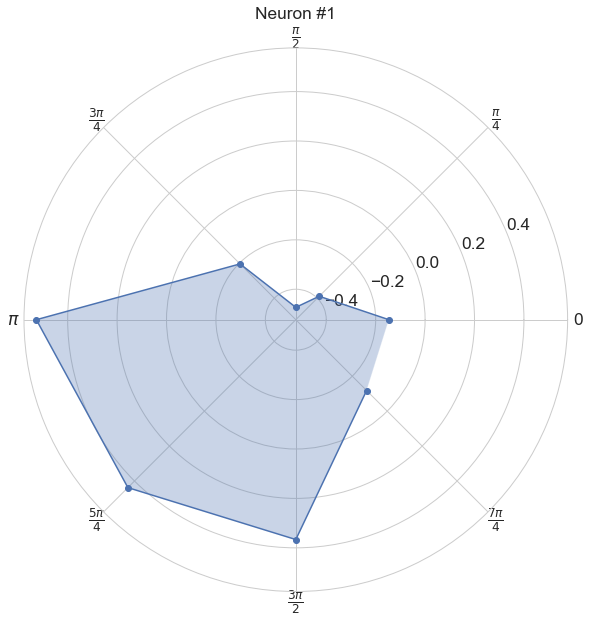

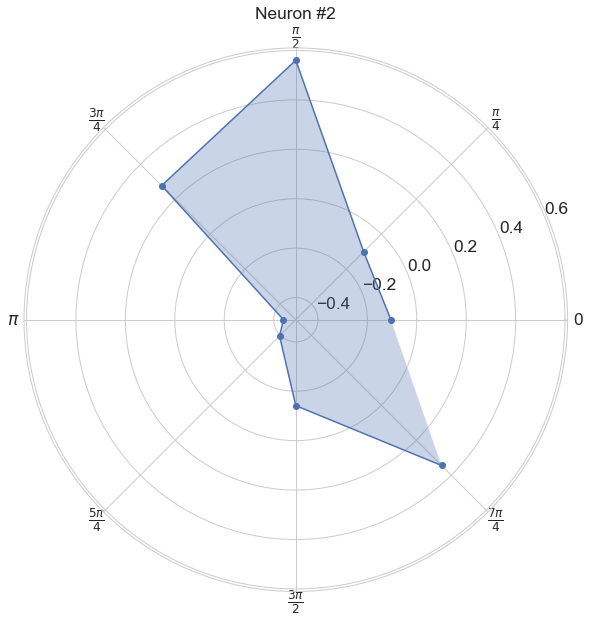

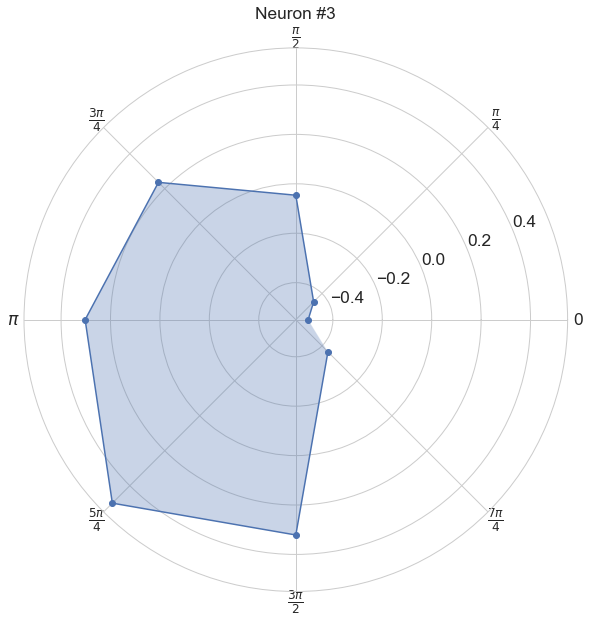

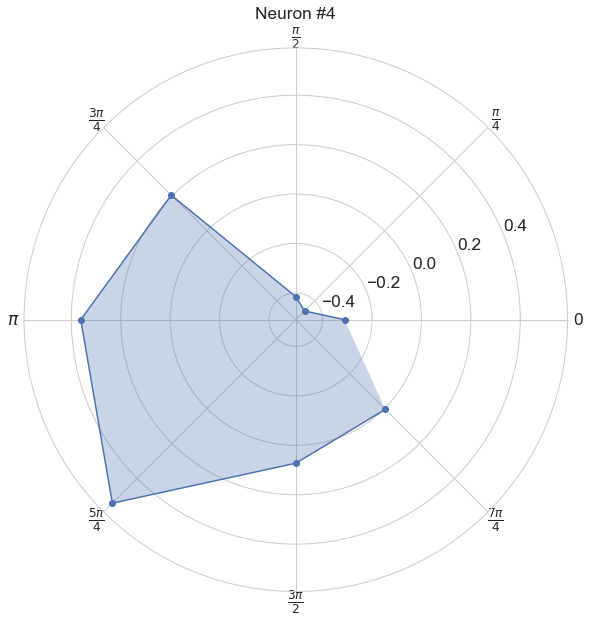

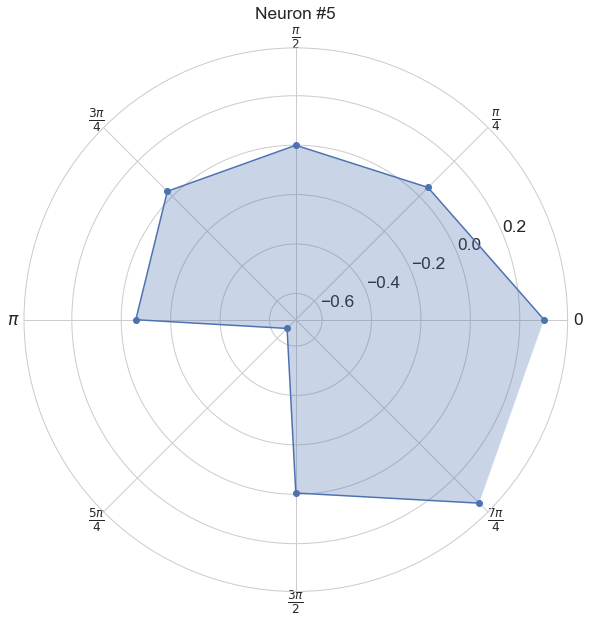

...

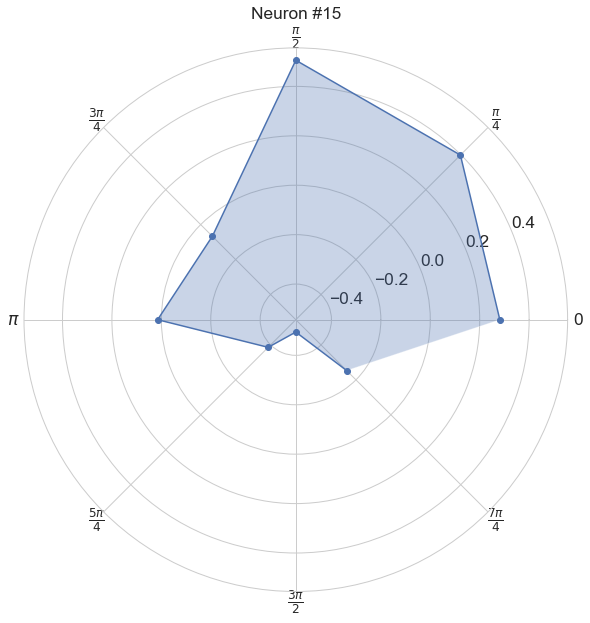

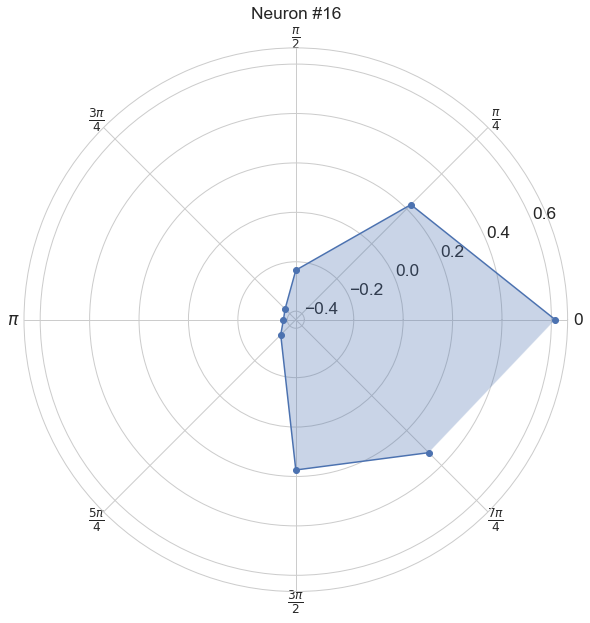

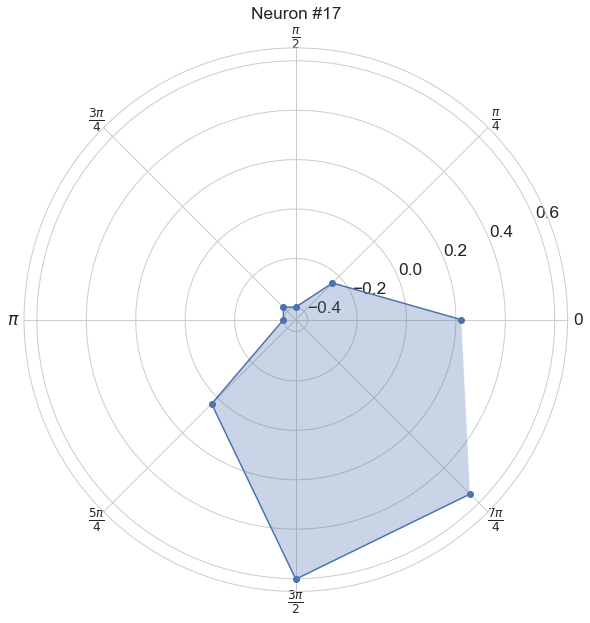

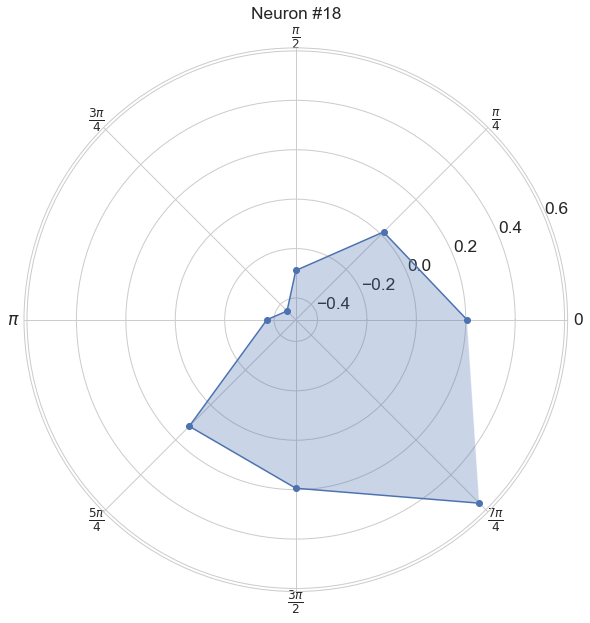

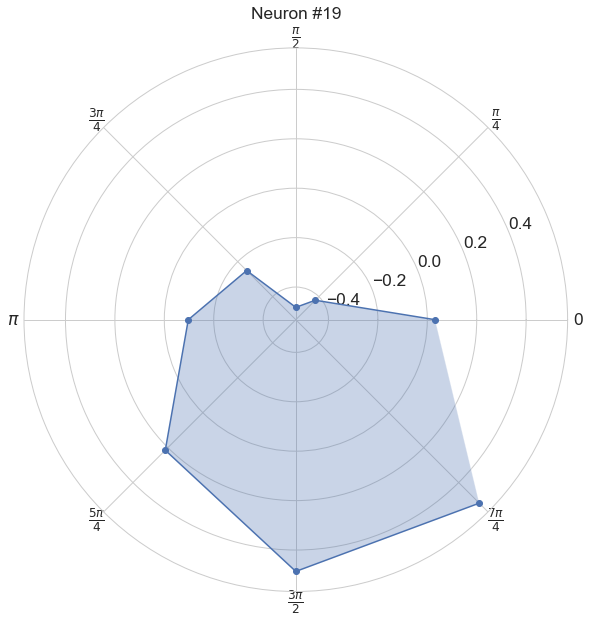

In [56]:
n_bmiTargNorm = np.zeros_like(n_bmiTargSum)


# per neuron
# fig = plt.figure(figsize = (10, 8))
for iN in range(numNeurons):
    fig=plt.figure(figsize = (10, 10))
    axe=fig.gca(polar=True)
    thetas=np.linspace(0, (7/4)*np.pi, 8)
    test = n_bmiTargSum[iN]    
#     n_bmiTargNorm[iN] = normalizeArray(test)
    n_bmiTargNorm[iN] = standardizeArray(test)
    axe.plot(thetas, n_bmiTargNorm[iN], '-o', label = iN + 1)
    axe.fill(thetas, n_bmiTargNorm[iN], alpha=0.3)

# xT=plt.xticks()[0]
    xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
        r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
    plt.xticks(xT, xL)
    plt.title("Neuron #" + str(iN + 1))
#     plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
    
    plt.show()

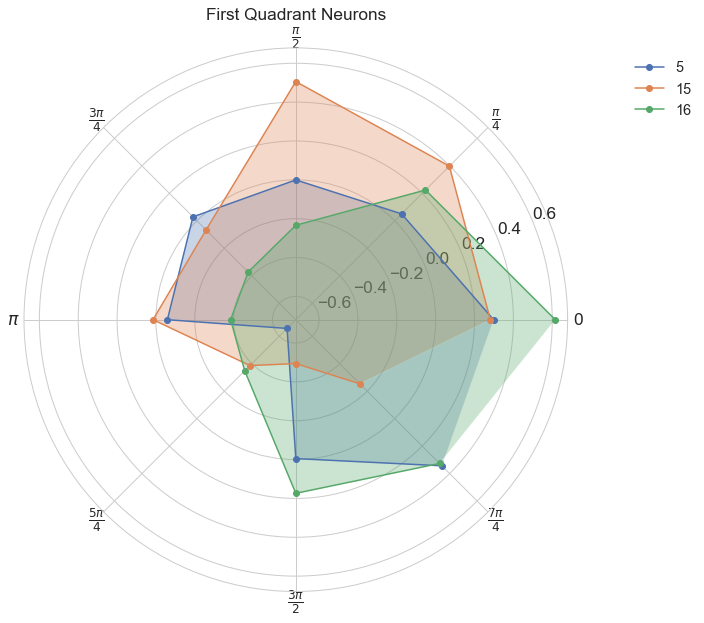

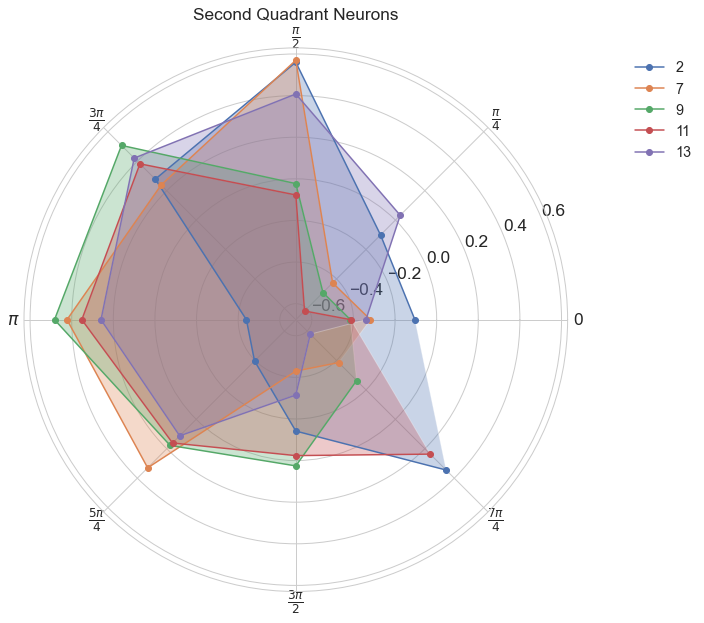

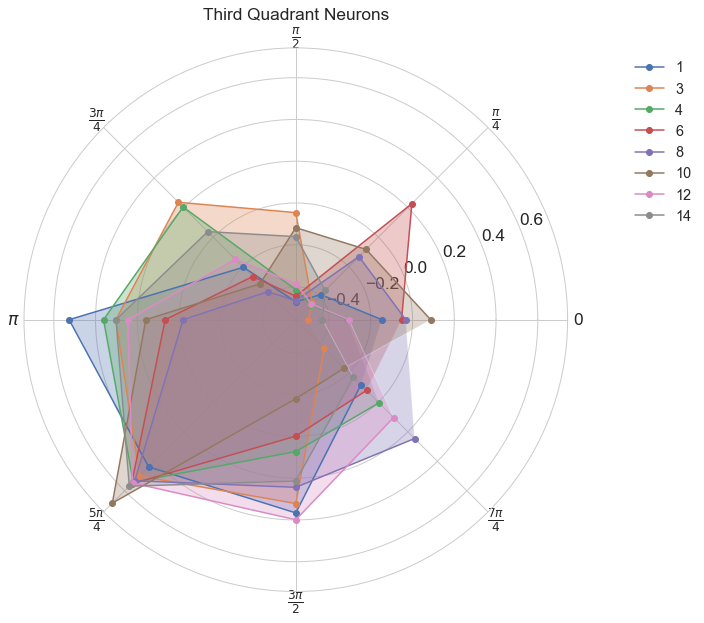

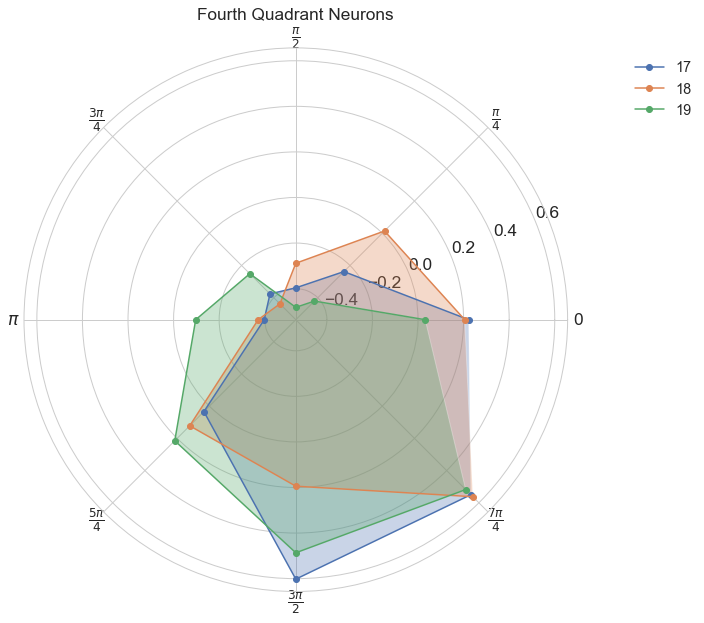

In [57]:
n_bmiTargNorm = np.zeros_like(n_bmiTargSum)

thetas=np.linspace(0, (7/4)*np.pi, 8)

# 0 to pi/2
fig=plt.figure(figsize = (10, 10))
axe=fig.gca(polar=True)
n_list = [4, 14, 15]
for iN in n_list:
#     n_array = normalizeArray(n_bmiTargSum[iN])
    n_array = standardizeArray(n_bmiTargSum[iN])
    axe.plot(thetas, n_array, '-o', label = iN + 1)
    axe.fill(thetas, n_array, alpha=0.3)

# xT=plt.xticks()[0]
xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
        r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
plt.xticks(xT, xL)
plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
plt.title("First Quadrant Neurons")    
plt.show()


# pi/2 to pi
fig=plt.figure(figsize = (10, 10))
axe=fig.gca(polar=True)
n_list = [1, 6, 8, 10, 12]
for iN in n_list:
#     n_array = normalizeArray(n_bmiTargSum[iN])
    n_array = standardizeArray(n_bmiTargSum[iN])
    axe.plot(thetas, n_array, '-o', label = iN + 1)
    axe.fill(thetas, n_array, alpha=0.3)

# xT=plt.xticks()[0]
xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
        r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
plt.xticks(xT, xL)
plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
plt.title("Second Quadrant Neurons")    
plt.show()


# pi to 3pi/2
fig=plt.figure(figsize = (10, 10))
axe=fig.gca(polar=True)
n_list = [0, 2, 3, 5, 7, 9, 11, 13]
for iN in n_list:
#     n_array = normalizeArray(n_bmiTargSum[iN])
    n_array = standardizeArray(n_bmiTargSum[iN])
    axe.plot(thetas, n_array, '-o', label = iN + 1)
    axe.fill(thetas, n_array, alpha=0.3)

# xT=plt.xticks()[0]
xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
        r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
plt.xticks(xT, xL)
plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
plt.title("Third Quadrant Neurons")    
plt.show()

# 3pi/2 to 2pi
fig=plt.figure(figsize = (10, 10))
axe=fig.gca(polar=True)
n_list = [16, 17, 18]
for iN in n_list:
#     n_array = normalizeArray(n_bmiTargSum[iN])
    n_array = standardizeArray(n_bmiTargSum[iN])
    axe.plot(thetas, n_array, '-o', label = iN + 1)
    axe.fill(thetas, n_array, alpha=0.3)

# xT=plt.xticks()[0]
xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
        r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
plt.xticks(xT, xL)
plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
plt.title("Fourth Quadrant Neurons")    
plt.show()

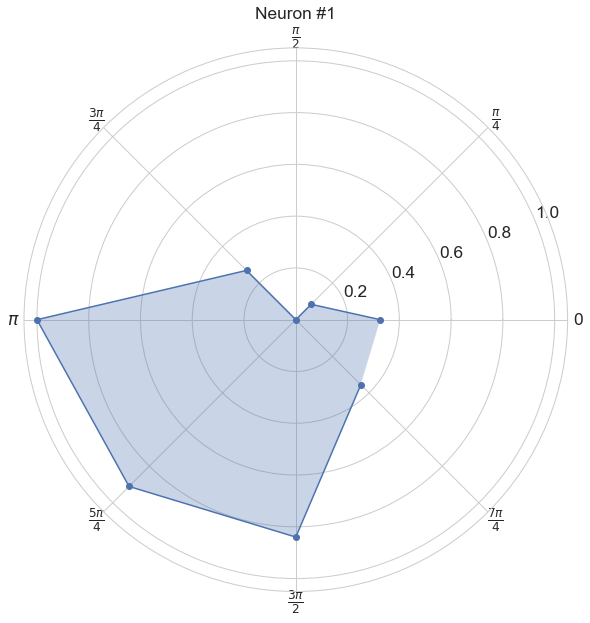

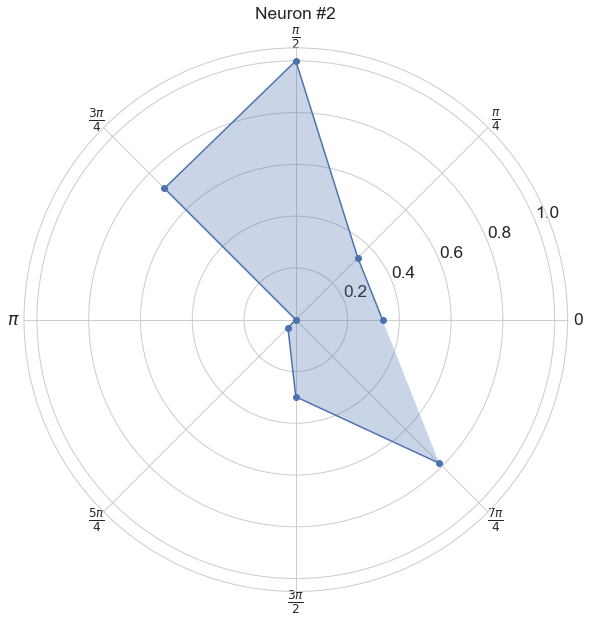

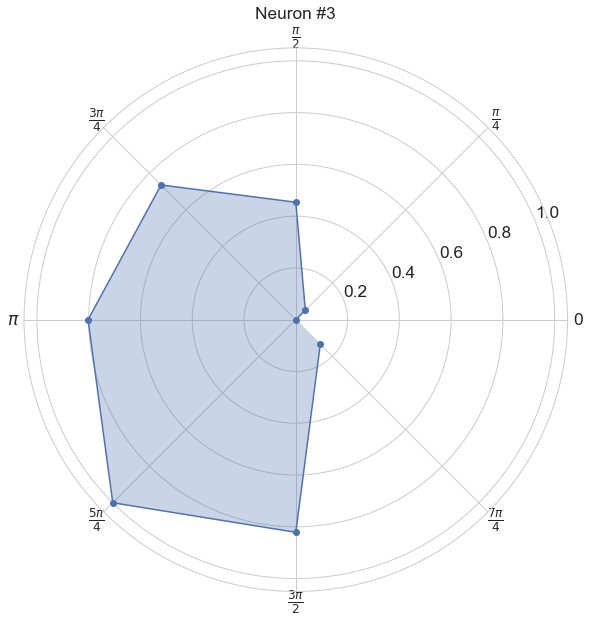

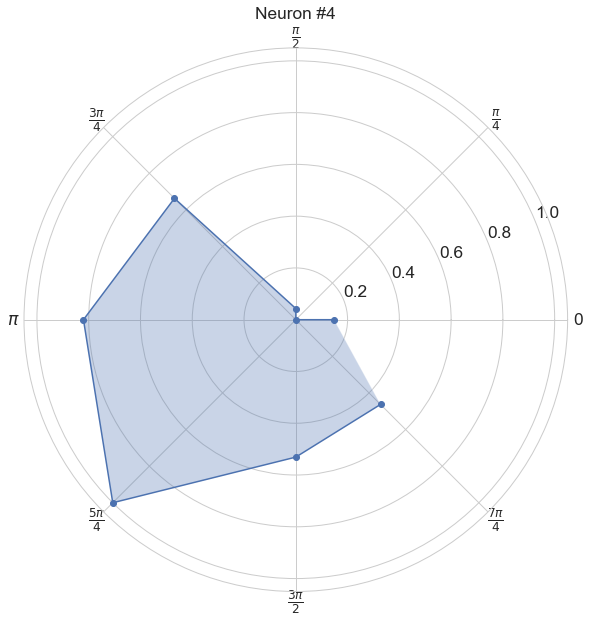

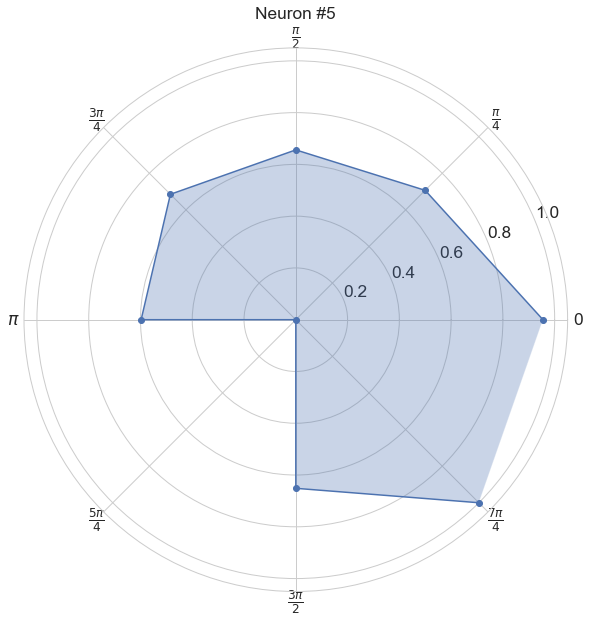

...

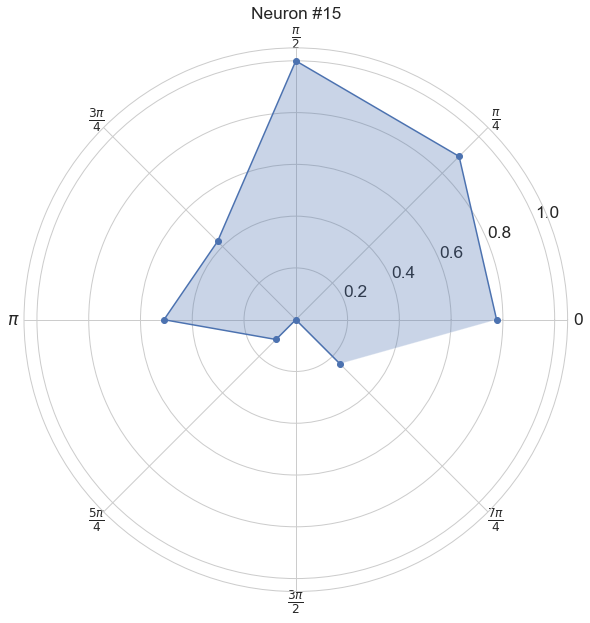

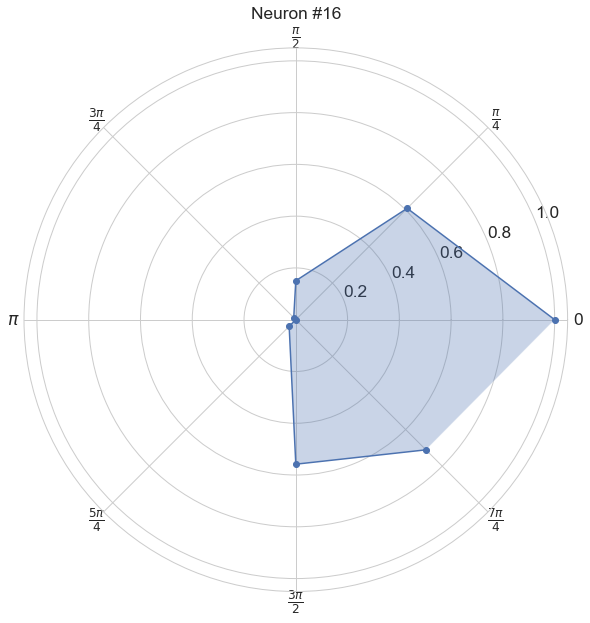

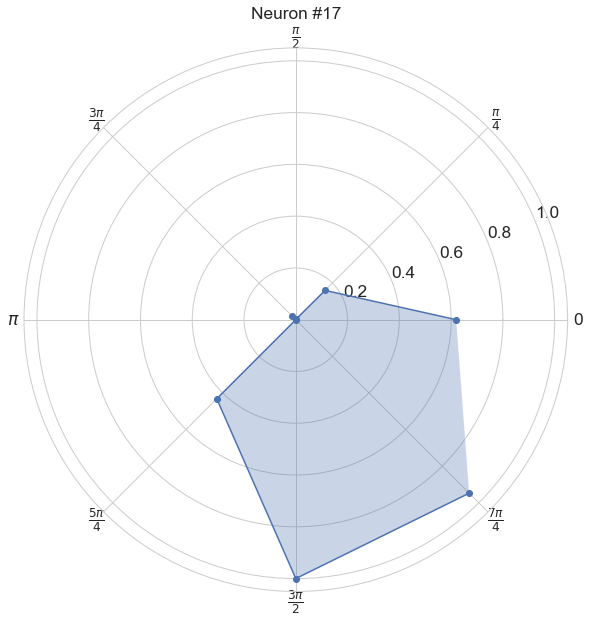

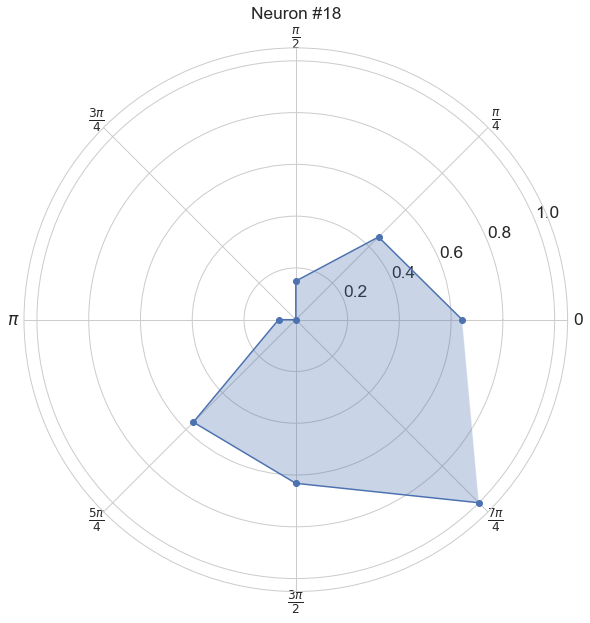

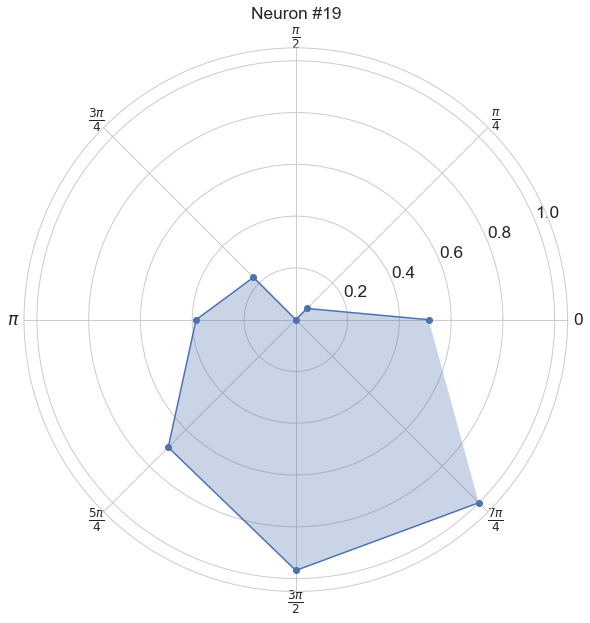

In [58]:
n_bmiTargNorm = np.zeros_like(n_bmiTargSum)


# per neuron
for iN in range(numNeurons):
    fig=plt.figure(figsize = (10, 10))
    axe=fig.gca(polar=True)
    thetas=np.linspace(0, (7/4)*np.pi, 8)
    idx = iN
    test = n_bmiTargSum[idx]    
    n_bmiTargNorm[iN] = normalizeArray(test)
    
    axe.plot(thetas, n_bmiTargNorm[idx], '-o', label = idx + 1)
    axe.fill(thetas, n_bmiTargNorm[idx], alpha=0.3)
    
    

# xT=plt.xticks()[0]
    xL=['0',r'$\frac{\pi}{4}$',r'$\frac{ \pi}{2}$',r'$\frac{3\pi}{4}$',\
        r'$\pi$',r'$\frac{5\pi}{4}$',r'$\frac{3\pi}{2}$',r'$\frac{7\pi}{4}$']
    plt.xticks(xT, xL)
    plt.title("Neuron #" + str(iN + 1))
#     plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
    
    plt.show()

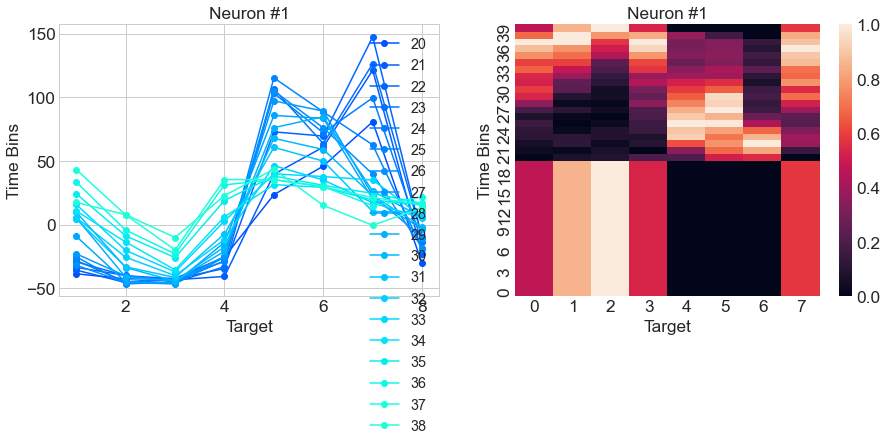

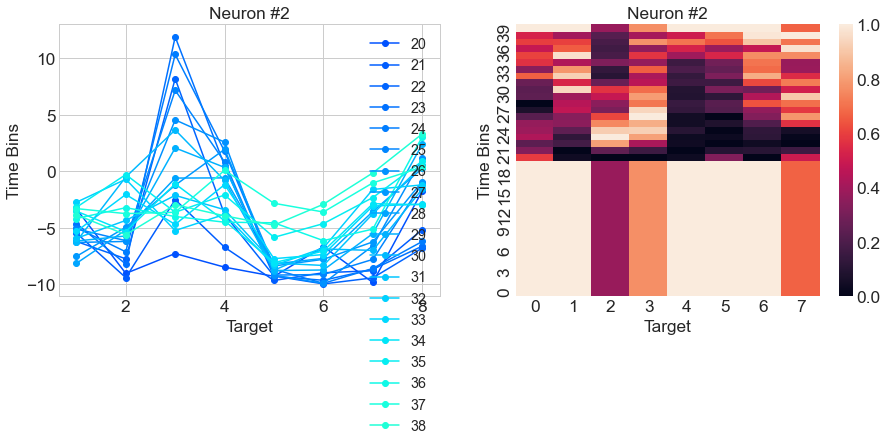

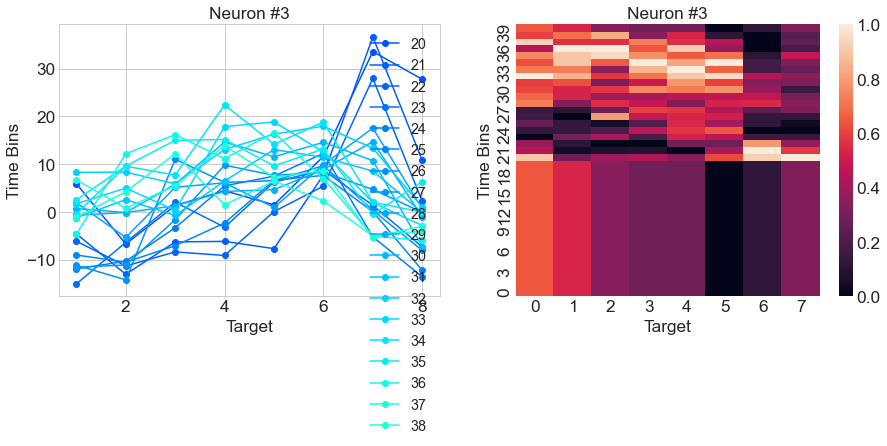

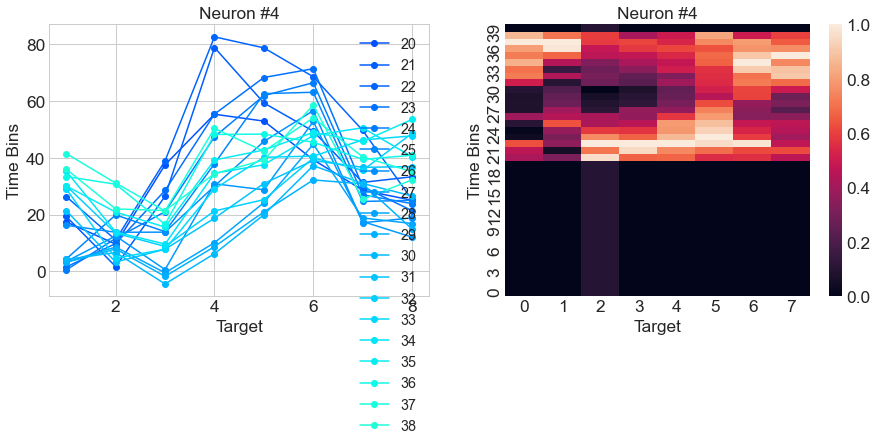

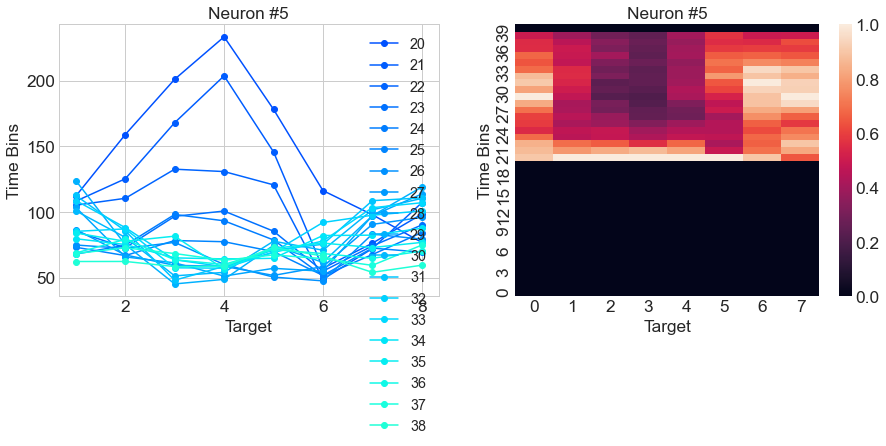

...

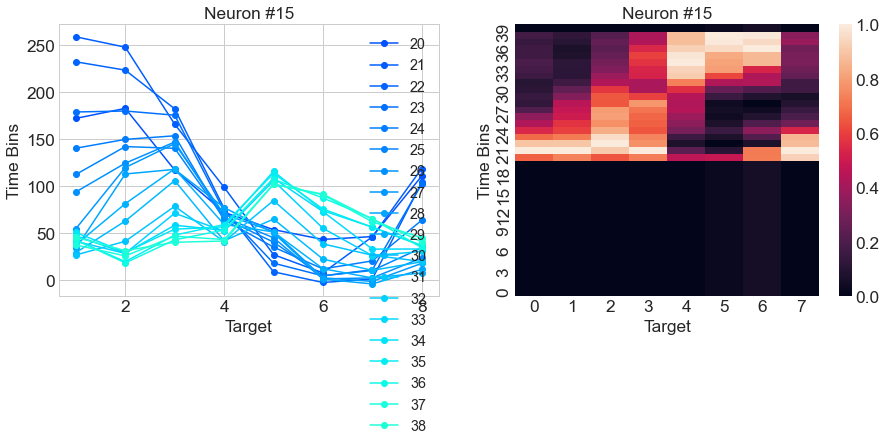

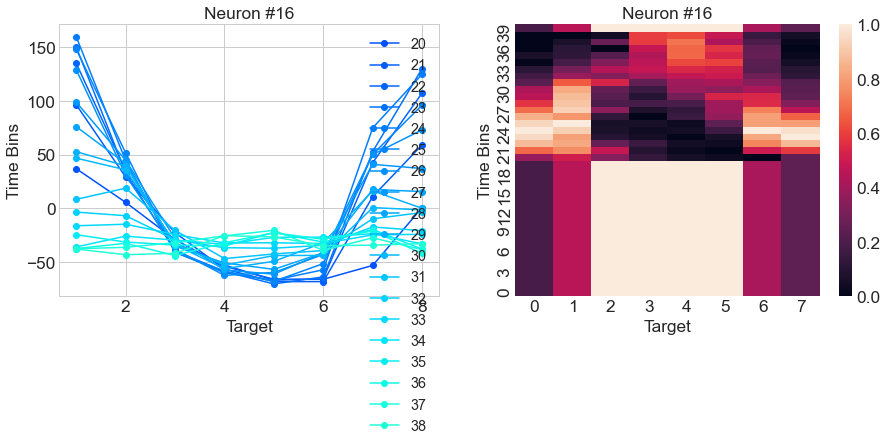

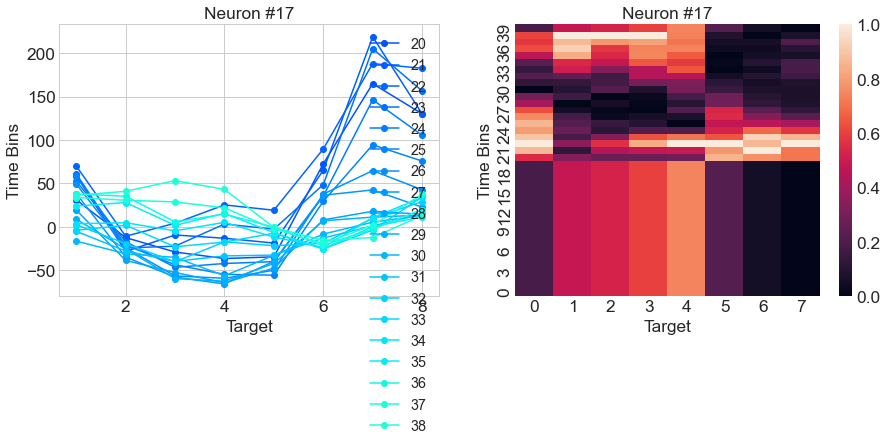

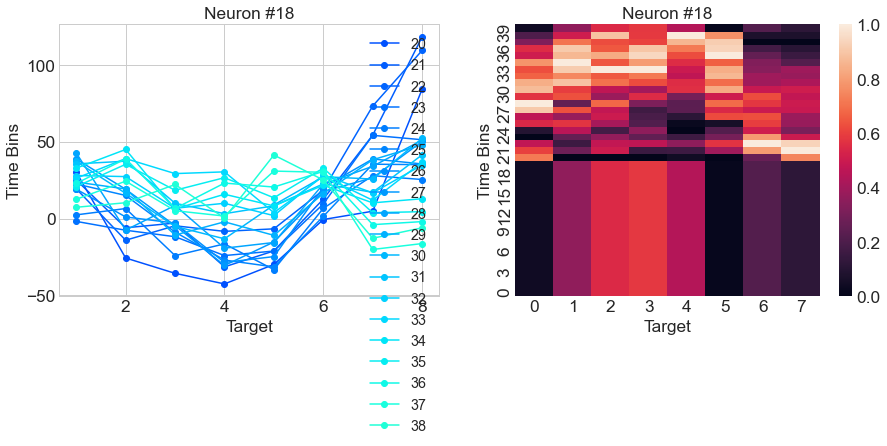

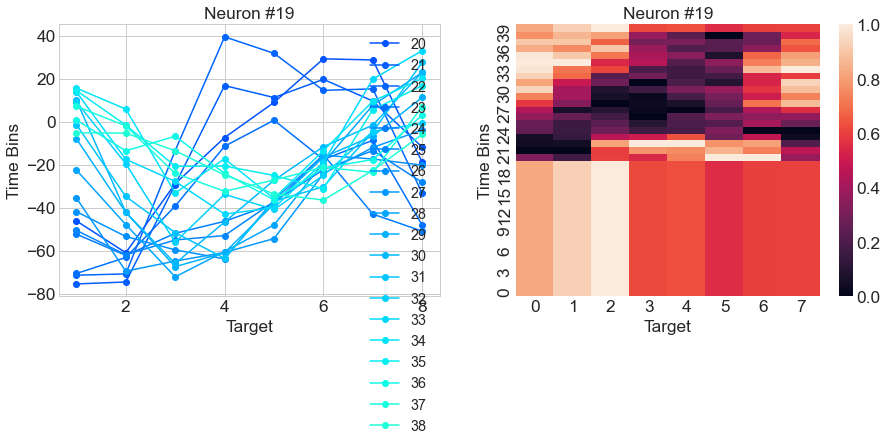

In [59]:
# 10 is the number of time bins
numTarg = 8
# numBins = 30
# plt.style.use(plt.style.available[24])

tStart = alignCue
tStop = numBins - 1

# going through each neuron
for iN in range(numNeurons):
    n_bmiTargTime = np.zeros((numBins, numTarg))
    n_bmiMin = np.zeros_like(n_bmiTargTime)
    # for each time bin
    fig = plt.figure(figsize=(15,5))
    plt.subplot(1, 2, 1)
    for iT in range(tStart, tStop, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[iT, 0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[iT, 1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[iT, 2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[iT, 3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[iT, 4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[iT, 5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[iT, 6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[iT, 7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime[iT], '-o', color = colors[iT], label=iT)
    plt.xlabel("Target")
    plt.ylabel("Time Bins")
    plt.legend()
    plt.title("Neuron #" + str(iN + 1))
      
    # time bins x target matrix
    # find the lowest number per target -- find np.min along column
    min_targ = np.min(n_bmiTargTime, axis=0)
#     print("min_targ", min_targ)
    # should substract minimum
    for iR in range(numTarg):
        n_bmiMin[:, iR] = n_bmiTargTime[:, iR] - min_targ[iR]
        max_nBmiMin = np.max(n_bmiMin[:, iR])
        n_bmiMin[:, iR] = n_bmiMin[:, iR]/max_nBmiMin
#     fig = plt.figure()
    plt.subplot(1, 2, 2)
    ax = seaborn.heatmap(n_bmiMin, fmt='g')
    ax.invert_yaxis()
    plt.xlabel("Target")
    plt.ylabel("Time Bins")
    plt.title("Neuron #" + str(iN + 1))
    
#     seaborn.heatmap(n_bmiMin, fmt='g')
    #     plt.plot(np.arange(1,9,1), n_bmiTargTime,'-o', color = colors[iT], label=iT)
# #                  color = '' + str(iT/numBins), label=iT)
# #         seaborn.lineplot(data=n_bmiTargTime, x="timepoint", y="signal", hue="event")
#     plt.title("After Enter Peripheral Target: Neuron #" + str(iN+1))
#     plt.xlabel("Target")
#     plt.ylabel("Firing Rate (Hz)")
#     plt.legend()
#     pdf.savefig(fig)

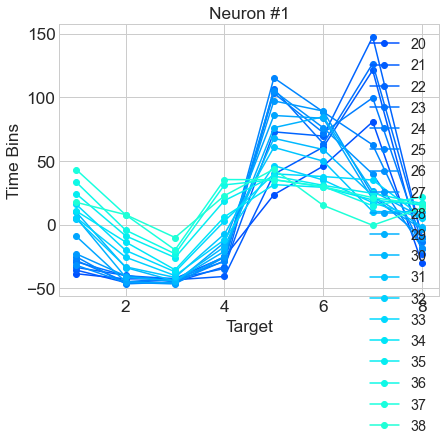

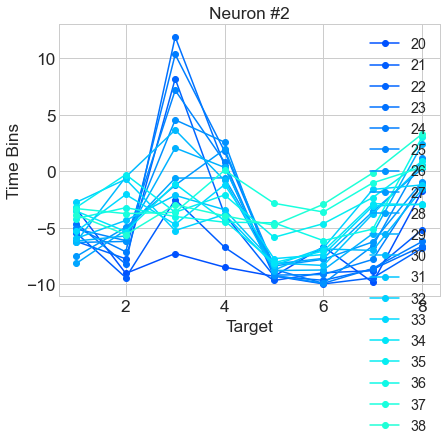

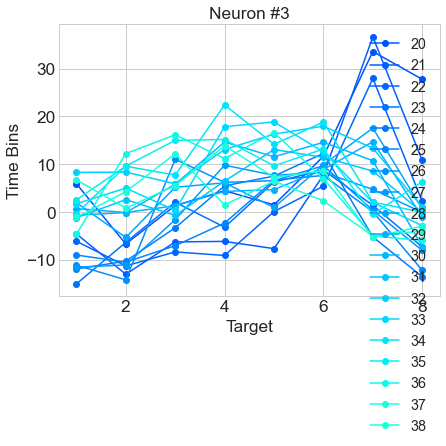

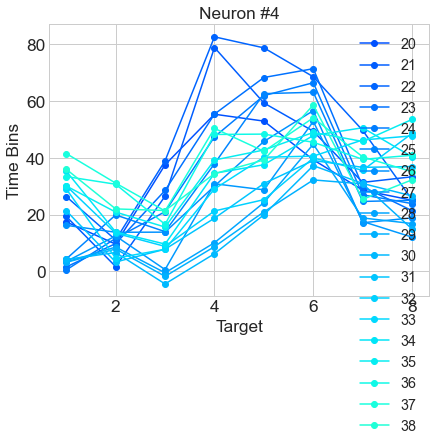

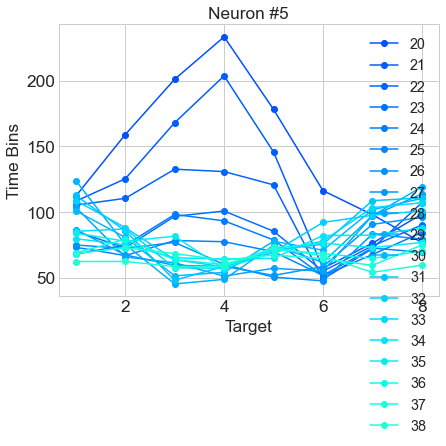

...

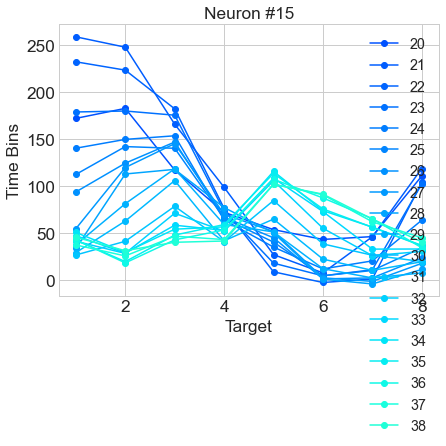

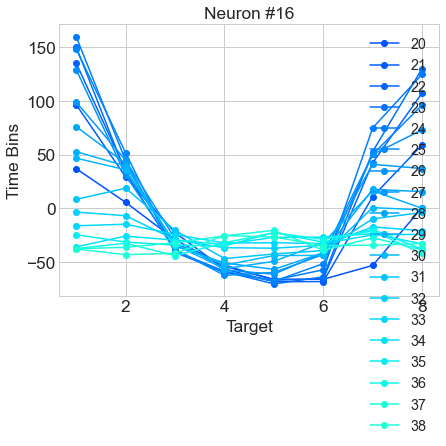

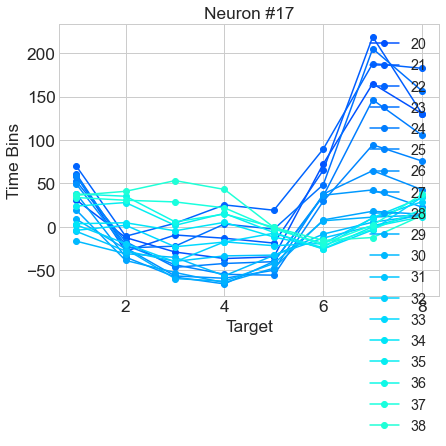

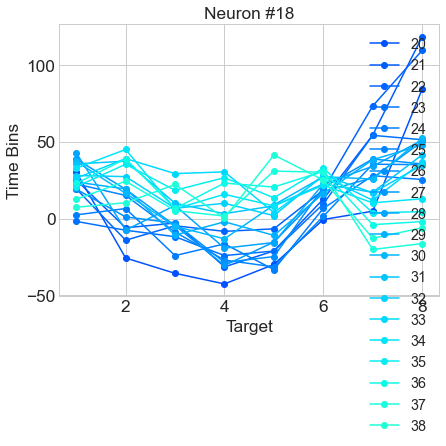

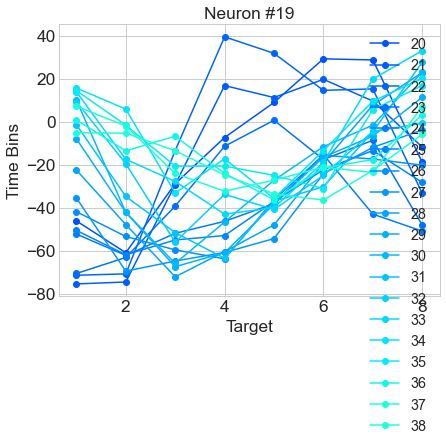

In [60]:
# 10 is the number of time bins
numTarg = 8
# numBins = 30
# plt.style.use(plt.style.available[24])

tStart = alignCue
tStop = numBins - 1

# going through each neuron
for iN in range(numNeurons):
    n_bmiTargTime = np.zeros((numBins, numTarg))
    n_bmiMin = np.zeros_like(n_bmiTargTime)
    # for each time bin
    fig = plt.figure(figsize=(15,5))
    plt.subplot(1, 2, 1)
    for iT in range(tStart, tStop, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[iT, 0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[iT, 1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[iT, 2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[iT, 3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[iT, 4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[iT, 5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[iT, 6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[iT, 7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime[iT], '-o', color = colors[iT], label=iT)
    plt.xlabel("Target")
    plt.ylabel("Time Bins")
    plt.legend()
    plt.title("Neuron #" + str(iN + 1))
      
#     # time bins x target matrix
#     # find the lowest number per target -- find np.min along column
#     min_targ = np.min(n_bmiTargTime, axis=0)

#     for iR in range(numTarg):
#         n_bmiMin[:, iR] = n_bmiTargTime[:, iR] - min_targ[iR]
#         max_nBmiMin = np.max(n_bmiMin[:, iR])
#         n_bmiMin[:, iR] = n_bmiMin[:, iR]/max_nBmiMin
# #     fig = plt.figure()
#     plt.subplot(1, 2, 2)
#     ax = seaborn.heatmap(n_bmiMin, fmt='g')
#     ax.invert_yaxis()
#     plt.xlabel("Target")
#     plt.ylabel("Time Bins")
#     plt.title("Neuron #" + str(iN + 1))


Try least-squares now with sum of firing rates

In [61]:
# n_bmiTargTime[0] = np.mean(n_bmiUnitsT1[iT, iN, :])
# n_bmiTargTime[1] = np.mean(n_bmiUnitsT2[iT, iN, :])
# n_bmiTargTime[2] = np.mean(n_bmiUnitsT3[iT, iN, :])
# n_bmiTargTime[3] = np.mean(n_bmiUnitsT4[iT, iN, :])
# n_bmiTargTime[4] = np.mean(n_bmiUnitsT5[iT, iN, :])
# n_bmiTargTime[5] = np.mean(n_bmiUnitsT6[iT, iN, :])
# n_bmiTargTime[6] = np.mean(n_bmiUnitsT7[iT, iN, :])
# n_bmiTargTime[7] = np.mean(n_bmiUnitsT8[iT, iN, :])

In [62]:
nBMI_decoder2.shape
# the shape is: bins x neurons x trials

(40, 19, 2047)

In [63]:
targVect.shape[0]

2047

In [64]:
n_targ = TargPositionVector(nBMI_decoder2, targVect)

Starting nData dims 3
target: 1
x: 1.0
y: 0.0
target: 2
x: 0.7071067811865476
y: 0.7071067811865475
target: 3
x: 6.123233995736766e-17
y: 1.0
target: 4
x: -0.7071067811865475
y: 0.7071067811865476
target: 5
x: -1.0
y: 1.2246467991473532e-16
target: 6
x: -0.7071067811865477
y: -0.7071067811865475
target: 7
x: -1.8369701987210297e-16
y: -1.0
target: 8
x: 0.7071067811865475
y: -0.7071067811865477


In [65]:
n_targ.shape

(3, 2047)

In [66]:
n_targ[:, 3]

array([3.000000e+00, 6.123234e-17, 1.000000e+00])

In [67]:
# how to index target:
n_targ[:, 3][1:]

array([6.123234e-17, 1.000000e+00])

## Summing up the neural data here

In [68]:
n_data = nBMI_decoder2
if (n_targ.shape[-1] != n_data.shape[-1]):
    print("check data, dimensions are wrong")

In [69]:
n_data.shape

(40, 19, 2047)

In [70]:
n_dict['binvector'][alignCue]

-2.220446049250313e-16

In [71]:
alignCue

20

In [72]:
# CHANGE THIS FOR CHANGING THE NEURAL DATA SUMMING
sumStart = 22
sumWindow = 5
sumEnd = sumStart + sumWindow
n_dataSum = np.sum(n_data[sumStart:sumEnd, :, :], axis=0)
print(n_dataSum.shape)
print(n_dataSum.shape[-1])

(19, 2047)
2047


In [73]:
# plot x - target vs firing rates

number of iter  51


Text(0.5, 1.0, 'R-squared of Firing Rates Estimate, # of trials =40')

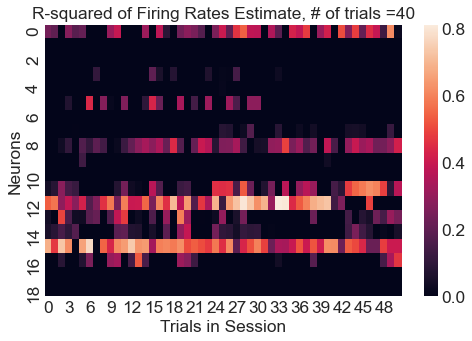

In [74]:
# do least squares here:
numNeurons = n_dataSum.shape[0]
n_tr = 40
iterations = int(n_dataSum.shape[-1]/n_tr)
print("number of iter ", iterations)
numDim = 2
rsquared_ = np.zeros((numNeurons, iterations))


for iT in range(iterations):
    iS = iT*n_tr
    iE = (iT+1)*n_tr
#     print("start", iS)
#     print("end", iE)
    fr = n_dataSum[:, iS:iE]
    targ = n_targ[:, iS:iE][1:]
#     targ = n_targ[:, iS:iE][:1]
    w_estimate, solve, resdVect = findW_leastSquares(fr, targ, numNeurons, numDim)
    w_estimate = w_estimate.value
    fs_estimate = w_estimate@targ
    (R2, SStot, SSres) = findRsquared(fr, fs_estimate, numNeurons) #, n_tr)
    R2[R2 < 0] = 0
    rsquared_[:, iT] = R2
    
seaborn.heatmap(rsquared_)
plt.ylabel("Neurons")
plt.xlabel("Trials in Session")
plt.title("R-squared of Firing Rates Estimate, # of trials =" + str(n_tr))

number of iter  20


Text(0.5, 1.0, 'R-squared of Firing Rates Estimate, # of trials =100')

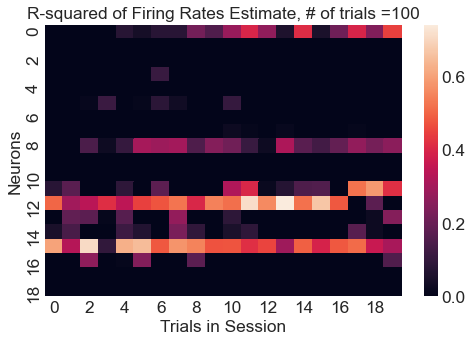

In [75]:
# do least squares here:
numNeurons = n_dataSum.shape[0]
n_tr = 100
iterations = int(n_dataSum.shape[-1]/n_tr)
print("number of iter ", iterations)
numDim = 2
rsquared_ = np.zeros((numNeurons, iterations))


for iT in range(iterations):
    iS = iT*n_tr
    iE = (iT+1)*n_tr
#     print("start", iS)
#     print("end", iE)
    fr = n_dataSum[:, iS:iE]
    targ = n_targ[:, iS:iE][1:]
#     targ = n_targ[:, iS:iE][:1]
    w_estimate, solve, resdVect = findW_leastSquares(fr, targ, numNeurons, numDim)
    w_estimate = w_estimate.value
    fs_estimate = w_estimate@targ
    (R2, SStot, SSres) = findRsquared(fr, fs_estimate, numNeurons) #, n_tr)
    R2[R2 < 0] = 0
    rsquared_[:, iT] = R2
    
seaborn.heatmap(rsquared_)
plt.ylabel("Neurons")
plt.xlabel("Trials in Session")
plt.title("R-squared of Firing Rates Estimate, # of trials =" + str(n_tr))

number of iter  20


Text(0.5, 1.0, 'R-squared of Firing Rates Estimate, # of trials =100')

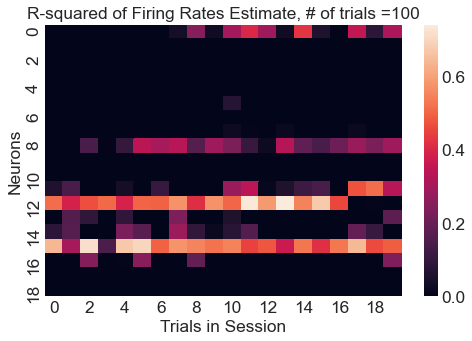

In [76]:
# do least squares here:
numNeurons = n_dataSum.shape[0]
n_tr = 100
iterations = int(n_dataSum.shape[-1]/n_tr)
print("number of iter ", iterations)
numDim = 2
rsquared_ = np.zeros((numNeurons, iterations))


for iT in range(iterations):
    iS = iT*n_tr
    iE = (iT+1)*n_tr
#     print("start", iS)
#     print("end", iE)
    fr = standardizeArray(n_dataSum[:, iS:iE])
    targ = n_targ[:, iS:iE][1:]
#     targ = n_targ[:, iS:iE][:1]
    w_estimate, solve, resdVect = findW_leastSquares(fr, targ, numNeurons, numDim)
    w_estimate = w_estimate.value
    fs_estimate = w_estimate@targ
    (R2, SStot, SSres) = findRsquared(fr, fs_estimate, numNeurons) #, n_tr)
    R2[R2 < 0] = 0
    rsquared_[:, iT] = R2
    
seaborn.heatmap(rsquared_)
plt.ylabel("Neurons")
plt.xlabel("Trials in Session")
plt.title("R-squared of Firing Rates Estimate, # of trials =" + str(n_tr))

Unit test code:

Let W = random matrix so that f_fake = Wt exactly

Then find W_est from f_fake and use that to solve for f_est_fake

Solve for r-squared of f_est_fake and f_fake --> expect r-squared = 1

number of iter  102
W fake: [[0.35714111 0.9764595 ]
 [0.7399592  0.08266878]
 [0.09486672 0.96970851]
 [0.79492048 0.11961097]
 [0.05939618 0.46445867]
 [0.77190218 0.27993511]
 [0.34169824 0.73179002]
 [0.86069834 0.82393464]
 [0.50293022 0.63883257]
 [0.97770278 0.26595454]
 [0.40437802 0.96058558]
 [0.94140796 0.4711488 ]
 [0.89419051 0.84670224]
 [0.13966435 0.19510486]
 [0.89839087 0.76890603]
 [0.1117769  0.2984505 ]
 [0.258453   0.11486253]
 [0.50120775 0.33438546]
 [0.33632283 0.29707253]]
average of R^2 per neuron: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
Number of Neurons: (19,)


Text(0.5, 1.0, 'UNIT TEST: R-squared of Firing Rates Estimate, # of trials =20')

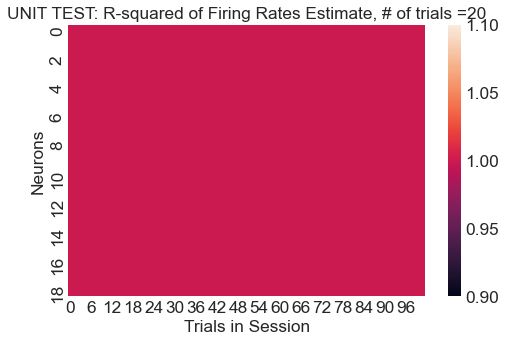

In [77]:
# do least squares here:
numNeurons = n_dataSum.shape[0]
n_tr = 20
iterations = int(n_dataSum.shape[-1]/n_tr)
print("number of iter ", iterations)
numDim = 2
rsquared_ = np.zeros((numNeurons, iterations))

# Assume W = matrix of ones
# W_fake = np.ones((numNeurons, numDim))
W_fake = np.random.rand(numNeurons, numDim)
print("W fake:", W_fake)


for iT in range(iterations):
    iS = iT*n_tr
    iE = (iT+1)*n_tr
    targ = n_targ[:, iS:iE][1:]
    fr_test = W_fake@targ
    w_estimate, solve, resdVect = findW_leastSquares(fr_test, targ, numNeurons, numDim)
    w_estimate = w_estimate.value
    fs_test_est = w_estimate@targ
    (R2, SStot, SSres) = findRsquared(fr_test, fs_test_est, numNeurons)
    R2[R2 < 0] = 0
    rsquared_[:, iT] = R2
    
print("average of R^2 per neuron:", np.mean(rsquared_, axis=1))
print("Number of Neurons:", np.mean(rsquared_, axis=1).shape)
seaborn.heatmap(rsquared_)
plt.ylabel("Neurons")
plt.xlabel("Trials in Session")
plt.title("UNIT TEST: R-squared of Firing Rates Estimate, # of trials =" + str(n_tr))


Test the # of trials vs r-squared analysis

In [78]:
n_dataSum.shape

(19, 2047)

In [79]:
# do least squares here:
numNeurons = n_dataSum.shape[0]
numTrials = n_dataSum.shape[1]
numDim = 2
n_tries = 30
tr_iter = np.linspace(10, numTrials/4, n_tries, dtype=int)
rsq_mean = np.zeros((numNeurons, n_tries))
rsq_max = np.zeros((numNeurons, n_tries))

for count, value in enumerate(tr_iter):
    n_tr = value
    iterations = int(numTrials/n_tr)
    print("number of iter ", iterations)
    
    rsquared_ = np.zeros((numNeurons, iterations))
    
    for iT in range(iterations):
        iS = iT*n_tr
        iE = (iT+1)*n_tr
        fr = standardizeArray(n_dataSum[:, iS:iE])
        targ = n_targ[:, iS:iE][1:]
        w_estimate, solve, resdVect = findW_leastSquares(fr, targ, numNeurons, numDim)
        w_estimate = w_estimate.value
        fs_estimate = w_estimate@targ
        (R2, SStot, SSres) = findRsquared(fr, fs_estimate, numNeurons)
        R2[R2 < 0] = 0
        rsquared_[:, iT] = R2

    rsq_mean[:, count] = np.mean(rsquared_, axis=1)
    rsq_max[:, count] = np.max(rsquared_, axis=1)

number of iter  204


<ipython-input-14-1ec6c2670c25>:17: RuntimeWarning: divide by zero encountered in true_divide
  R2 = 1 - SSres / SStot


number of iter  75
number of iter  46
number of iter  33
number of iter  25
number of iter  21
number of iter  18
number of iter  15
number of iter  13
number of iter  12
number of iter  11
number of iter  10
number of iter  9
number of iter  8
number of iter  8
number of iter  7
number of iter  7
number of iter  6
number of iter  6
number of iter  6
number of iter  5
number of iter  5
number of iter  5
number of iter  5
number of iter  4
number of iter  4
number of iter  4
number of iter  4
number of iter  4
number of iter  4


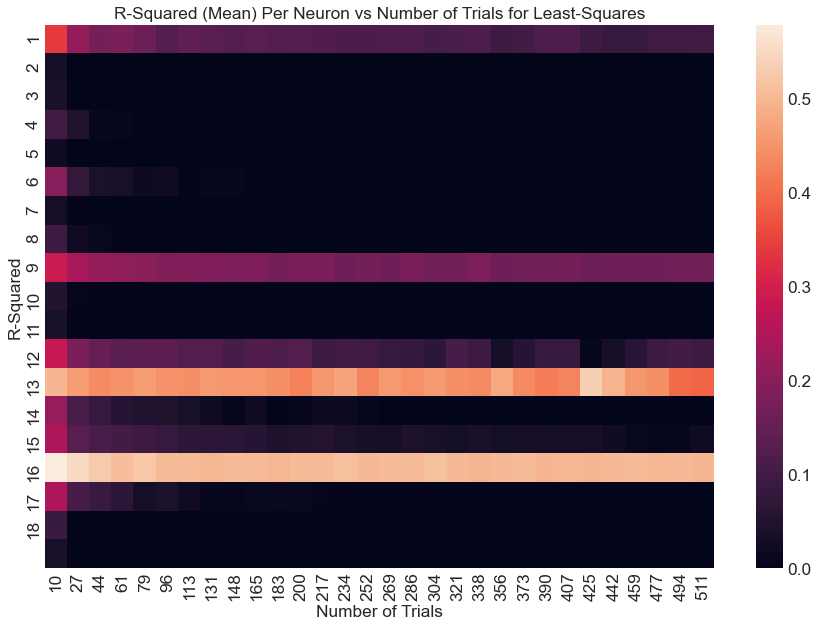

Neuron #: 1  Average r-squared: 0.13019842595142148
Neuron #: 2  Average r-squared: 0.0013304292382692313
Neuron #: 3  Average r-squared: 0.0013291774841346685
Neuron #: 4  Average r-squared: 0.005593996187144729
Neuron #: 5  Average r-squared: 0.0007387154228646141
Neuron #: 6  Average r-squared: 0.013721943625266908
Neuron #: 7  Average r-squared: 0.0012069980021905467
Neuron #: 8  Average r-squared: 0.004575109802850688
Neuron #: 9  Average r-squared: 0.18288525148351764
Neuron #: 10  Average r-squared: 0.001928330995821582
Neuron #: 11  Average r-squared: 0.0013334408289320545
Neuron #: 12  Average r-squared: 0.10407513852827359
Neuron #: 13  Average r-squared: 0.4513262662876737
Neuron #: 14  Average r-squared: 0.02395690636506959
Neuron #: 15  Average r-squared: 0.05635482473424978
Neuron #: 16  Average r-squared: 0.5099546509873906
Neuron #: 17  Average r-squared: 0.022303838484595457
Neuron #: 18  Average r-squared: 0.002905542088462779
Neuron #: 19  Average r-squared: 0.001254

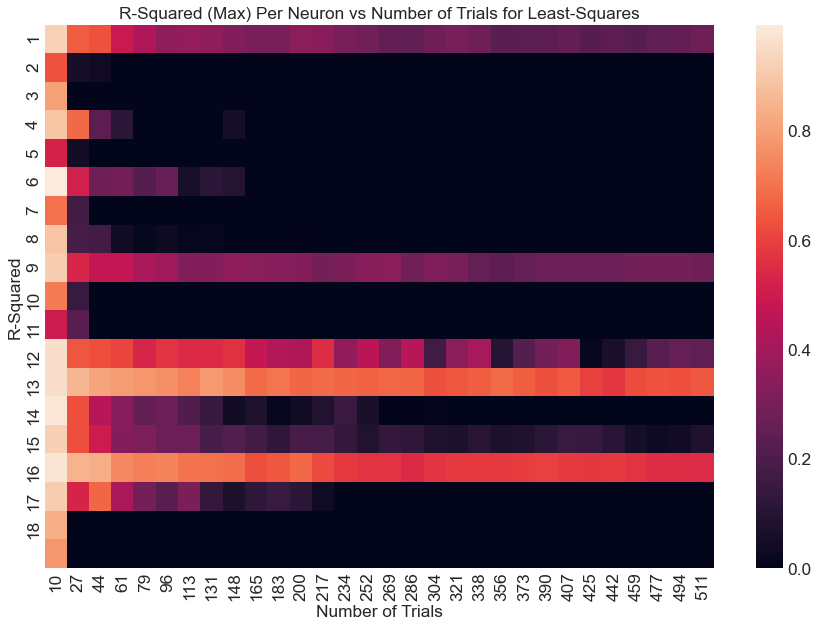

In [80]:
f,ax = plt.subplots(figsize=(15, 10))

ax = seaborn.heatmap(rsq_mean, xticklabels=tr_iter, yticklabels = np.arange(1, numNeurons, 1))
plt.ylabel("R-Squared")
plt.xlabel("Number of Trials")
plt.title("R-Squared (Mean) Per Neuron vs Number of Trials for Least-Squares")
plt.show()

for count, value in enumerate(np.mean(rsq_mean, axis=1)):
    print("Neuron #:", count+1, " Average r-squared:", value) 
    
f,ax = plt.subplots(figsize=(15, 10))
ax = seaborn.heatmap(rsq_max, xticklabels=tr_iter, yticklabels = np.arange(1, numNeurons, 1))
plt.ylabel("R-Squared")
plt.xlabel("Number of Trials")
plt.title("R-Squared (Max) Per Neuron vs Number of Trials for Least-Squares")
plt.show()

In [81]:
for count, value in enumerate(np.mean(rsq_mean, axis=1)):
    print("Neuron #:", count+1, " Average r-squared:", value) 

Neuron #: 1  Average r-squared: 0.13019842595142148
Neuron #: 2  Average r-squared: 0.0013304292382692313
Neuron #: 3  Average r-squared: 0.0013291774841346685
Neuron #: 4  Average r-squared: 0.005593996187144729
Neuron #: 5  Average r-squared: 0.0007387154228646141
Neuron #: 6  Average r-squared: 0.013721943625266908
Neuron #: 7  Average r-squared: 0.0012069980021905467
Neuron #: 8  Average r-squared: 0.004575109802850688
Neuron #: 9  Average r-squared: 0.18288525148351764
Neuron #: 10  Average r-squared: 0.001928330995821582
Neuron #: 11  Average r-squared: 0.0013334408289320545
Neuron #: 12  Average r-squared: 0.10407513852827359
Neuron #: 13  Average r-squared: 0.4513262662876737
Neuron #: 14  Average r-squared: 0.02395690636506959
Neuron #: 15  Average r-squared: 0.05635482473424978
Neuron #: 16  Average r-squared: 0.5099546509873906
Neuron #: 17  Average r-squared: 0.022303838484595457
Neuron #: 18  Average r-squared: 0.002905542088462779
Neuron #: 19  Average r-squared: 0.001254

# n train/n test 

In [82]:
n_dataSum.shape

(19, 2047)

In [83]:
numTrials = n_dataSum.shape[-1]
# note: 250 and 500 take a long time
n_array = np.array([20, 40, 60, 80, 90, 100])
n_step = 10
# n_step_max = np.arange(start = 0, stop = numTrials - np.min(n_array), step = n_step , dtype = int)

# n_rsqd = neurons x length of train window x offset of data x number of time steps in the data
n_rsqd = np.zeros((numNeurons, len(n_array), int(numTrials/np.min(n_array))*2 - 1) ) 

# n_rsqd_mean_size = np.zeros((numNeurons, len(n_array), len(off_array)))
# n_rsqd_max_size = np.zeros((numNeurons, len(n_array), len(off_array)))

In [84]:
for idx_n, val_n in enumerate(n_array):
    n_size = val_n
    print("N SIZE: ", n_size)
    
    # t_array goes from the start of the data window to the n_size before the training window starts and increments in n_step
    # t_array is supposed to mark the start of the training data
    n_st_array = np.arange(start = 0, stop = numTrials - n_size, step = n_step , dtype = int)
#     print("t array: ", t_array.shape)
    
#     rsquared_ = np.zeros((numNeurons, len(n_start)))

    for idx_st, val_st in enumerate(n_st_array):
        # training window starts at different element of n
        n_start = val_st     

        # train and test on n_
        fr_train = standardizeArray(n_dataSum[:, n_start:n_start+n_size])
        targ_train = n_targ[:, n_start:n_start+n_size][1:]
        
        # tested: training data size matched n_size
        w_estimate, solve, resdVect = findW_leastSquares(fr_train, targ_train, numNeurons, numDim)
        w_estimate = w_estimate.value

        # tested: test data size is k_size
        fr_estimate = w_estimate@targ_train
        (R2, SStot, SSres) = findRsquared(fr_train, fr_estimate, numNeurons)
        R2[R2 < 0] = 0
        n_rsqd[:, idx_n, idx_st] = R2


#         f,ax = plt.subplots(figsize=(15, 10))

#         ax = seaborn.heatmap(rsquared_, xticklabels=test_array+data_offset, yticklabels = np.arange(1, numNeurons, 1))
#         plt.ylabel("Neurons")
#         plt.xlabel("Start of Training Data Within Window (n_start)")
#         plt.title("R-squared of Firing Rates Estimate (Random Test/Train), Train Size = " + str(n_size))

N SIZE:  20
N SIZE:  40
N SIZE:  60
N SIZE:  80
N SIZE:  90
N SIZE:  100


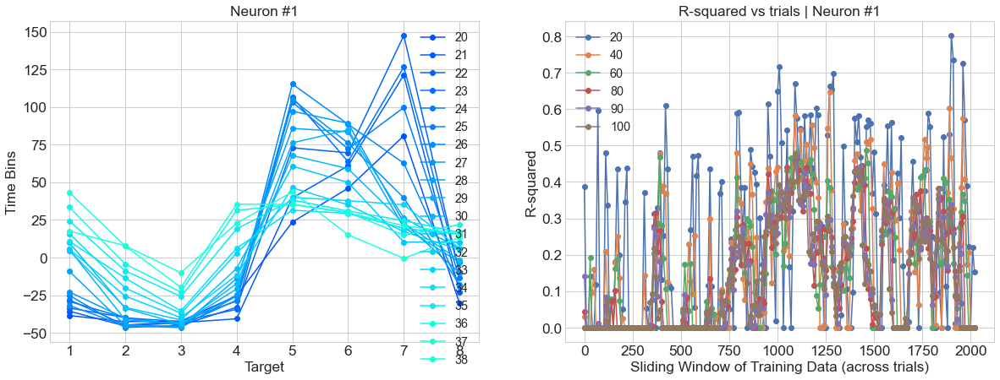

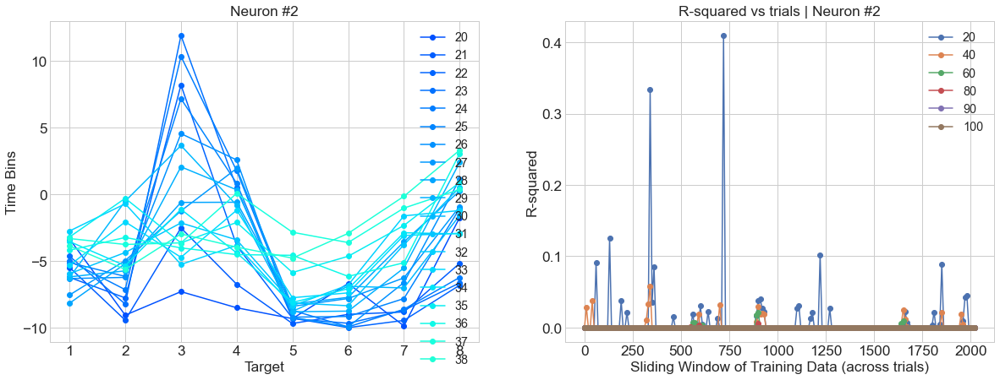

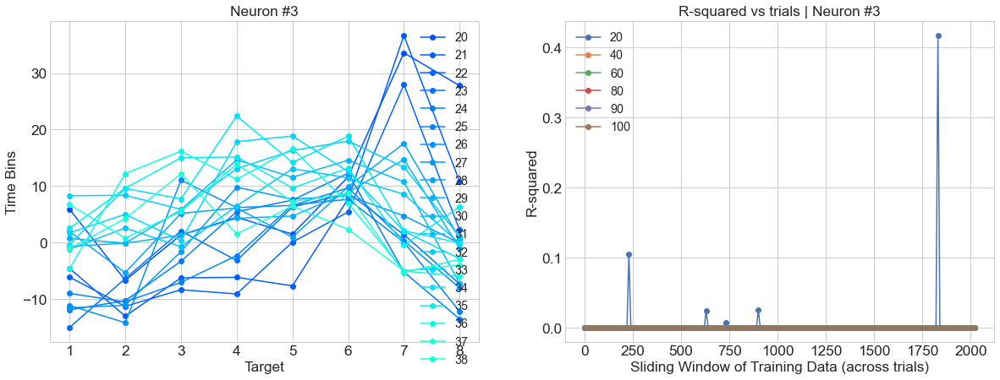

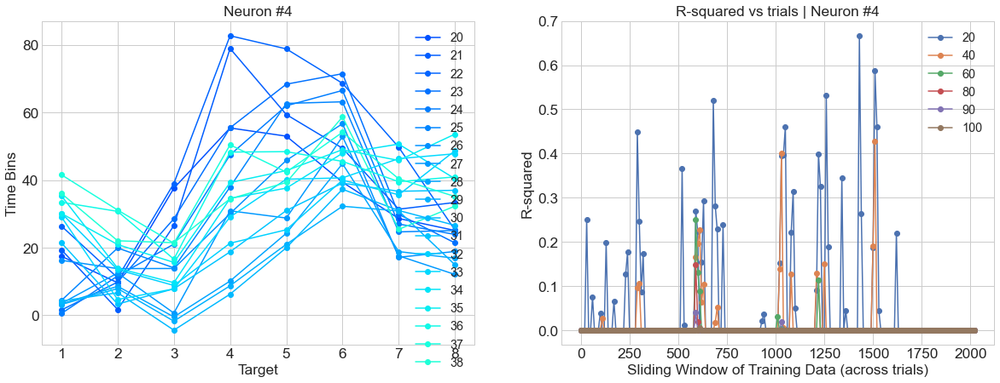

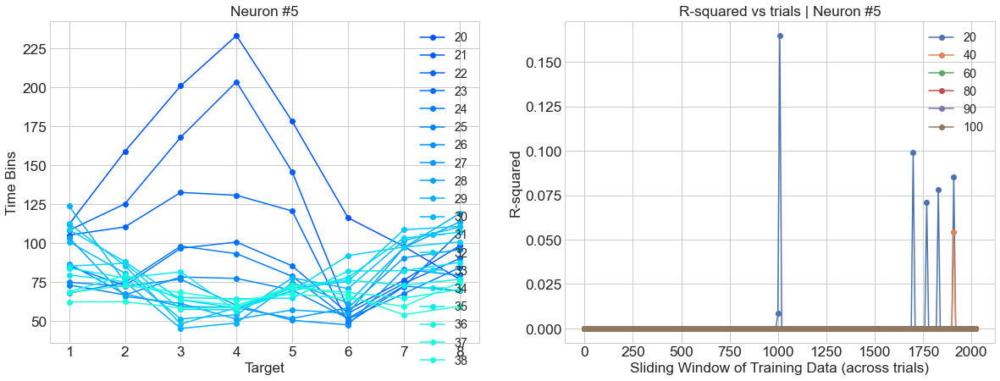

...

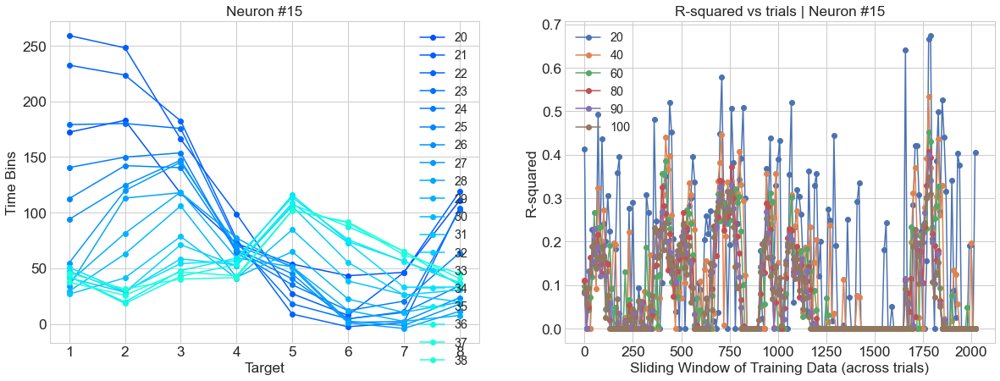

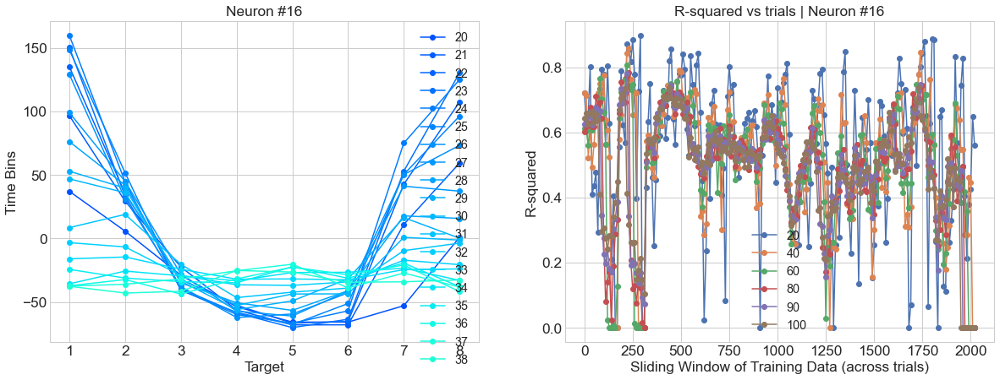

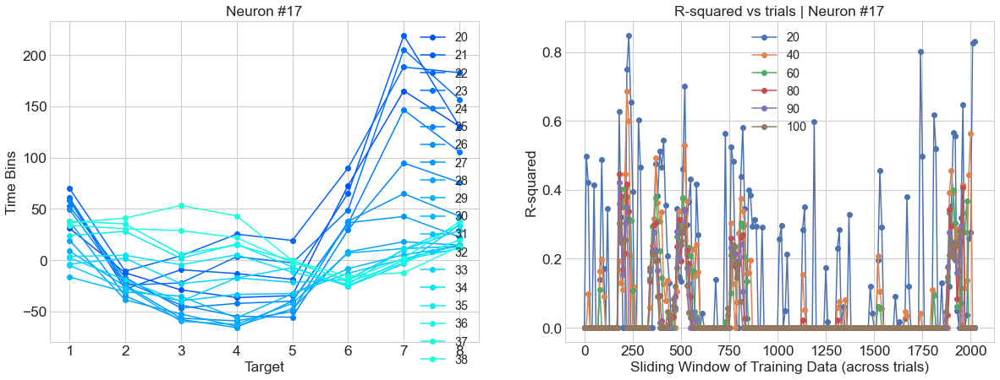

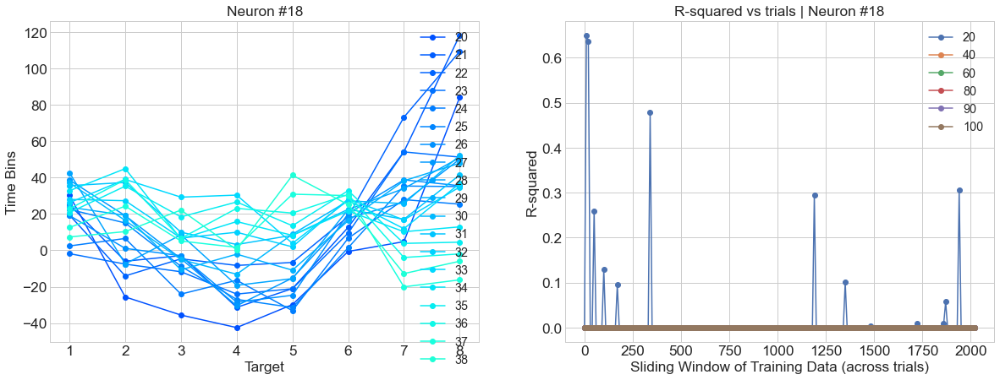

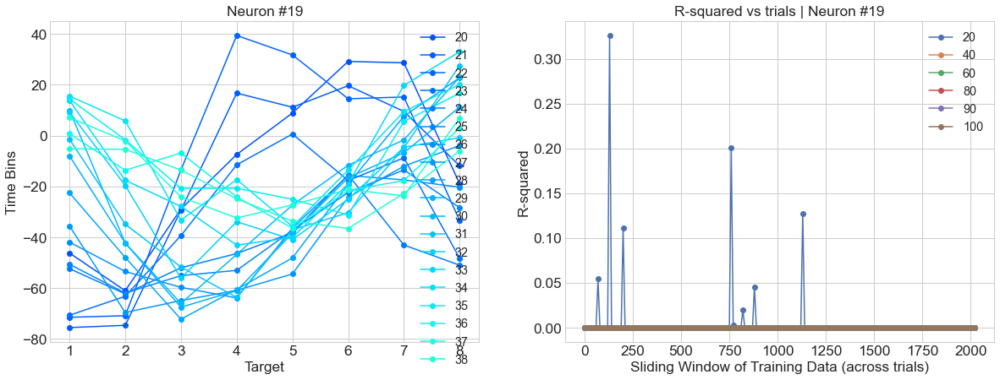

In [85]:
# 10 is the number of time bins
numTarg = 8

# tStart = alignCue
# tStop = numBins - 1


# going through each neuron
for iN in range(numNeurons):
    n_bmiTargTime = np.zeros((numBins, numTarg))
    n_bmiMin = np.zeros_like(n_bmiTargTime)
    # for each time bin
    fig = plt.figure(figsize=(20, 7))
    plt.subplot(1, 2, 1)
    for iT in range(tStart, tStop, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[iT, 0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[iT, 1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[iT, 2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[iT, 3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[iT, 4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[iT, 5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[iT, 6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[iT, 7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime[iT], '-o', color = colors[iT], label=iT)
    plt.xlabel("Target")
    plt.ylabel("Time Bins")
    plt.legend()
    plt.title("Neuron #" + str(iN + 1))
    
    
    plt.subplot(1, 2, 2)
    for idx_n, val_n in enumerate(n_array):
        plt.plot(np.arange(start = 0, stop = numTrials - np.min(n_array), step = n_step , dtype = int), n_rsqd[iN,idx_n,:], '-o', label=val_n)
    plt.legend()
    plt.ylabel("R-squared")
    plt.xlabel("Sliding Window of Training Data (across trials)")
    plt.title("R-squared vs trials | Neuron #" + str(iN + 1))
    plt.show()
    

In [86]:
n_array[::3]

array([20, 80])

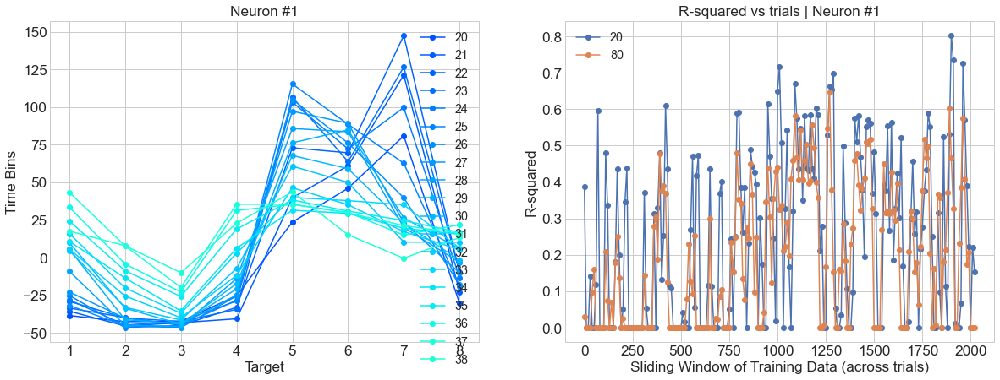

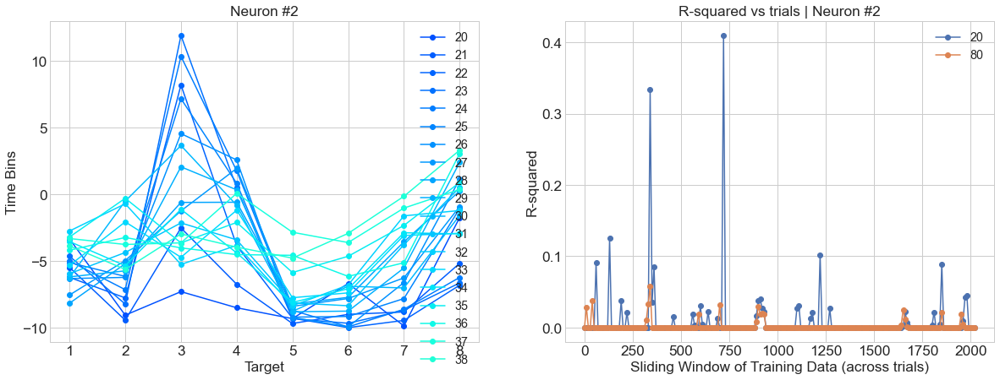

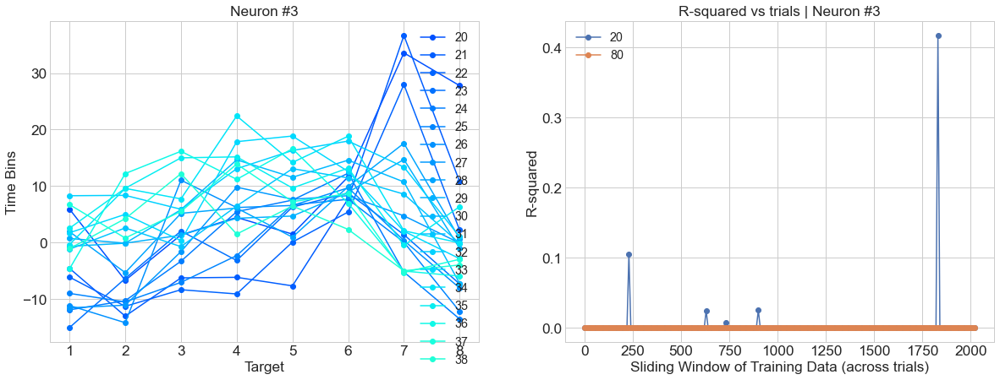

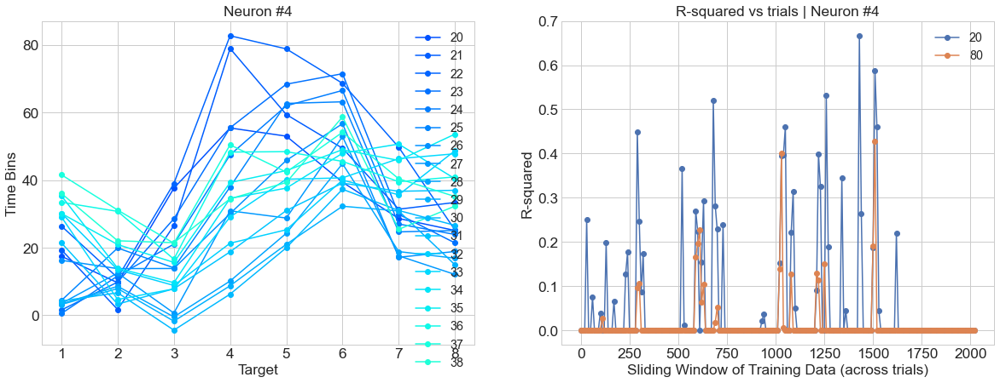

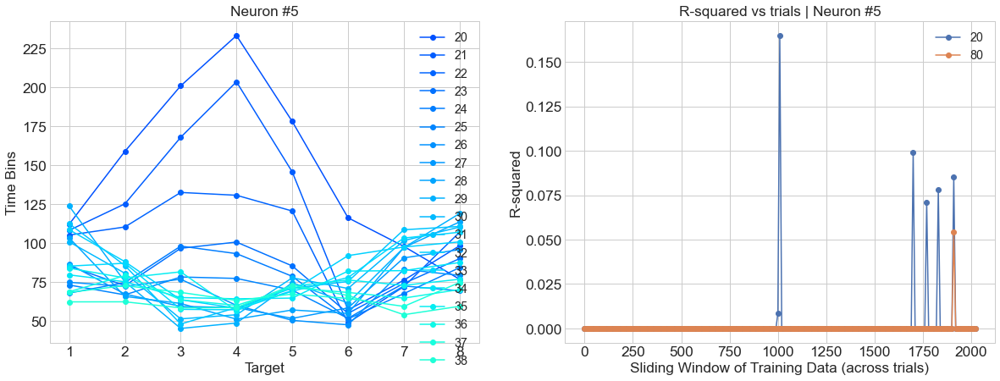

...

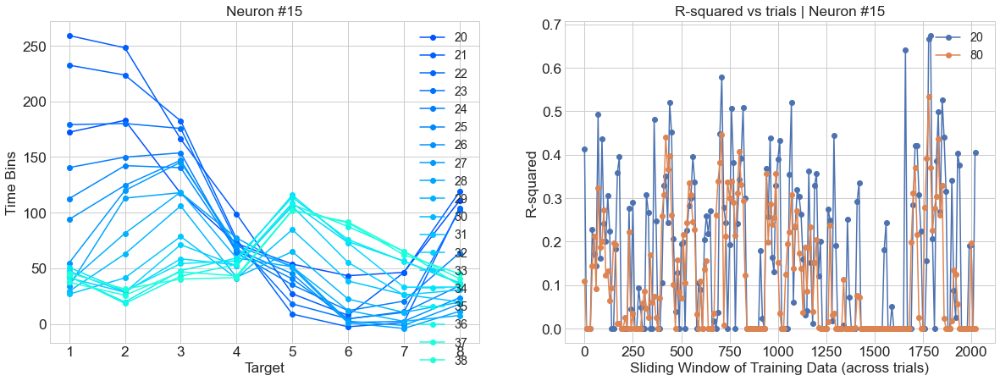

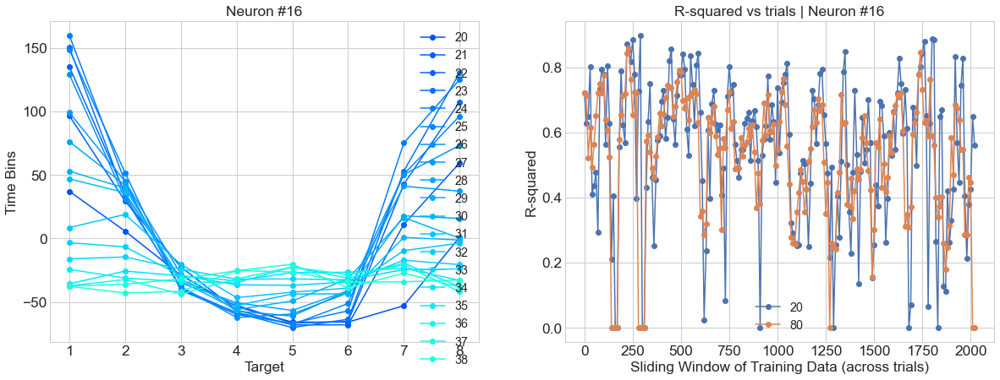

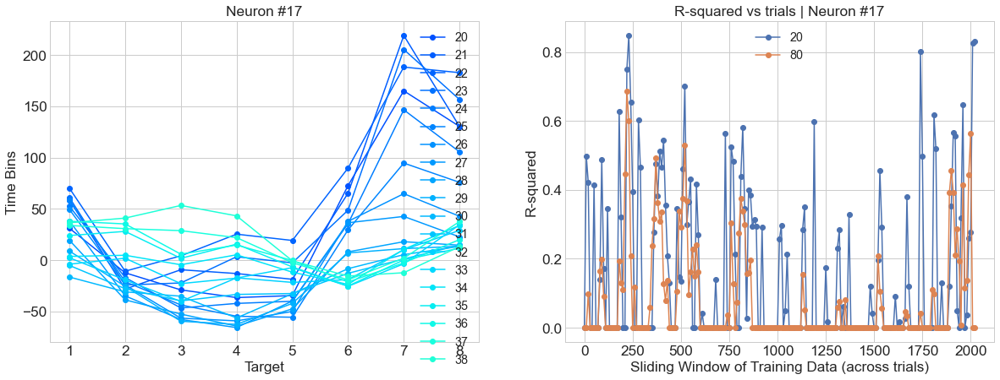

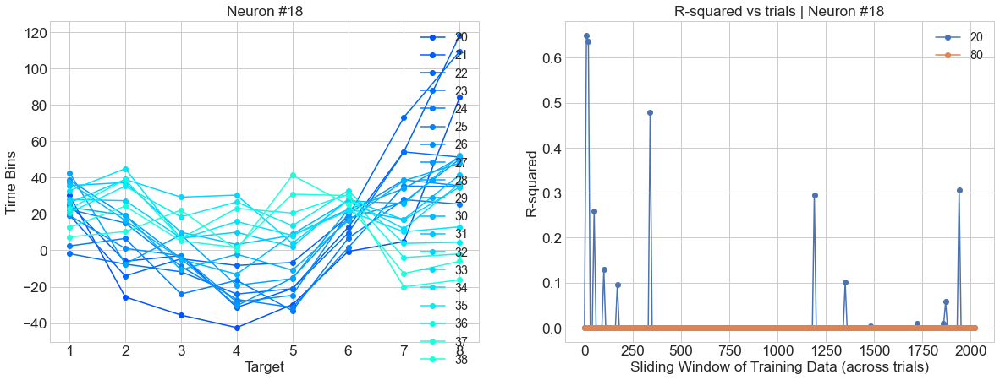

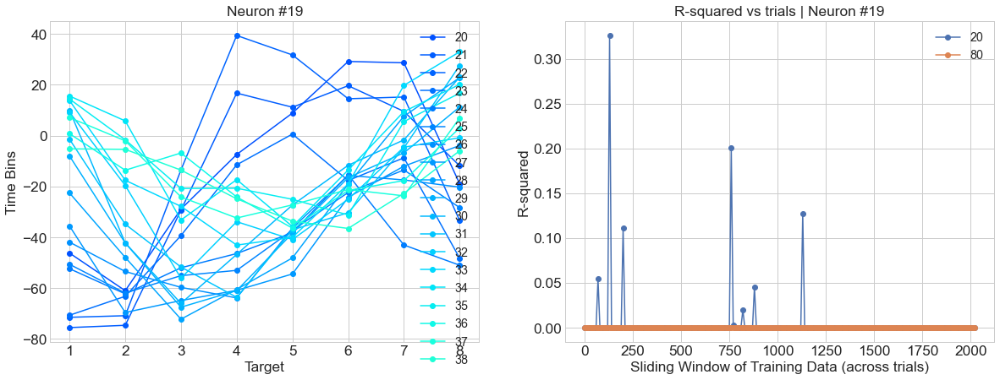

In [87]:
# 10 is the number of time bins
numTarg = 8

tStart = alignCue
tStop = numBins - 1


# going through each neuron
for iN in range(numNeurons):
    n_bmiTargTime = np.zeros((numBins, numTarg))
    n_bmiMin = np.zeros_like(n_bmiTargTime)
    # for each time bin
    fig = plt.figure(figsize=(20, 7))
    plt.subplot(1, 2, 1)
    for iT in range(tStart, tStop, 1):
    # 40 x neurons x trials 
        n_bmiTargTime[iT, 0] = np.mean(n_bmiUnitsT1[iT, iN, :])
        n_bmiTargTime[iT, 1] = np.mean(n_bmiUnitsT2[iT, iN, :])
        n_bmiTargTime[iT, 2] = np.mean(n_bmiUnitsT3[iT, iN, :])
        n_bmiTargTime[iT, 3] = np.mean(n_bmiUnitsT4[iT, iN, :])
        n_bmiTargTime[iT, 4] = np.mean(n_bmiUnitsT5[iT, iN, :])
        n_bmiTargTime[iT, 5] = np.mean(n_bmiUnitsT6[iT, iN, :])
        n_bmiTargTime[iT, 6] = np.mean(n_bmiUnitsT7[iT, iN, :])
        n_bmiTargTime[iT, 7] = np.mean(n_bmiUnitsT8[iT, iN, :])
        plt.plot(np.arange(1,9,1), n_bmiTargTime[iT], '-o', color = colors[iT], label=iT)
    plt.xlabel("Target")
    plt.ylabel("Time Bins")
    plt.legend()
    plt.title("Neuron #" + str(iN + 1))
    
    
    plt.subplot(1, 2, 2)
    for idx_n, val_n in enumerate(n_array[::3]):
        plt.plot(np.arange(start = 0, stop = numTrials - np.min(n_array), step = n_step , dtype = int), n_rsqd[iN,idx_n,:], '-o', label=val_n)
    plt.legend()
    plt.ylabel("R-squared")
    plt.xlabel("Sliding Window of Training Data (across trials)")
    plt.title("R-squared vs trials | Neuron #" + str(iN + 1))
    plt.show()
    

# n, k number of trials testing 

In [88]:
# input:  nData, nTargData, numNeurons, numTargDim, trialWindow)
# output: return (rsquared_, w_estimate)
# rsqd_, w_est = findWfromNeuralData(nData, nTargData, numNeurons, numTargDim, trialWindow):

# take window of 500 data samples
windowSize = 500
inS = 0
inE = inS + windowSize
fr_window = standardizeArray(n_dataSum[:, inS:inE])
print(fr_window.shape)
targ_window = n_targ[:, inS:inE][1:]
print(targ_window.shape)
print("Num Neurons: ", numNeurons)
print("Num Targ Dim: ", numDim)

(19, 500)
(2, 500)
Num Neurons:  19
Num Targ Dim:  2


In [89]:
# randomly select n + k samples
n_vect = np.arange(10, 260, 10)
k_vect = 250
n_vect

n_array = np.arange(0, 500)

In [90]:
x = np.random.choice(n_array, 10)
x

array([294, 337, 299,  83, 225, 333,  51, 457, 225, 166])

In [91]:
x[2:]

array([299,  83, 225, 333,  51, 457, 225, 166])

 ## n/k test/train with random samples -- to see different test windows sizes

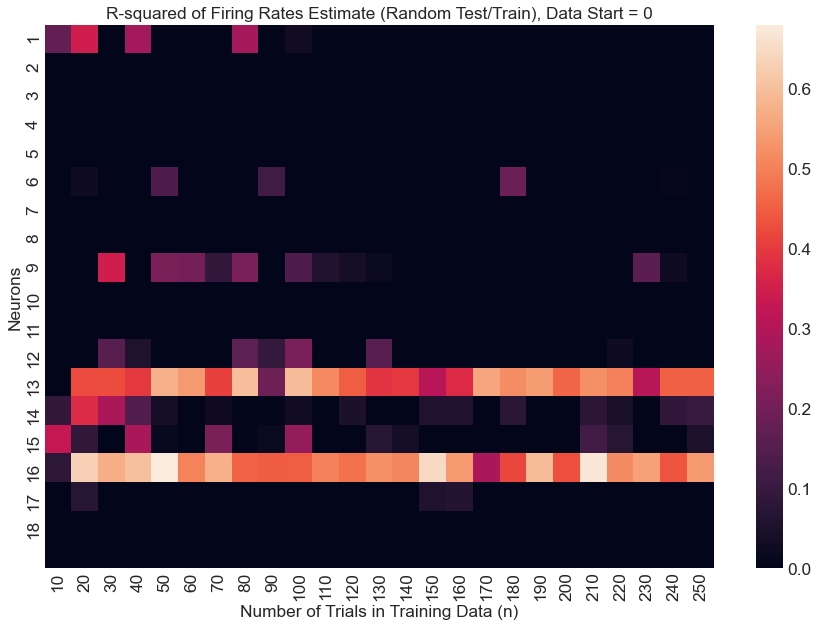

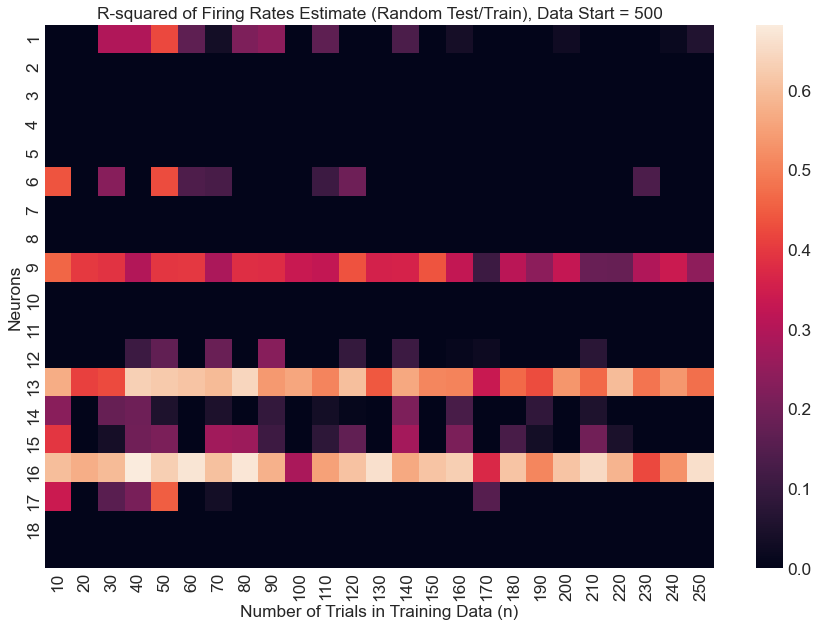

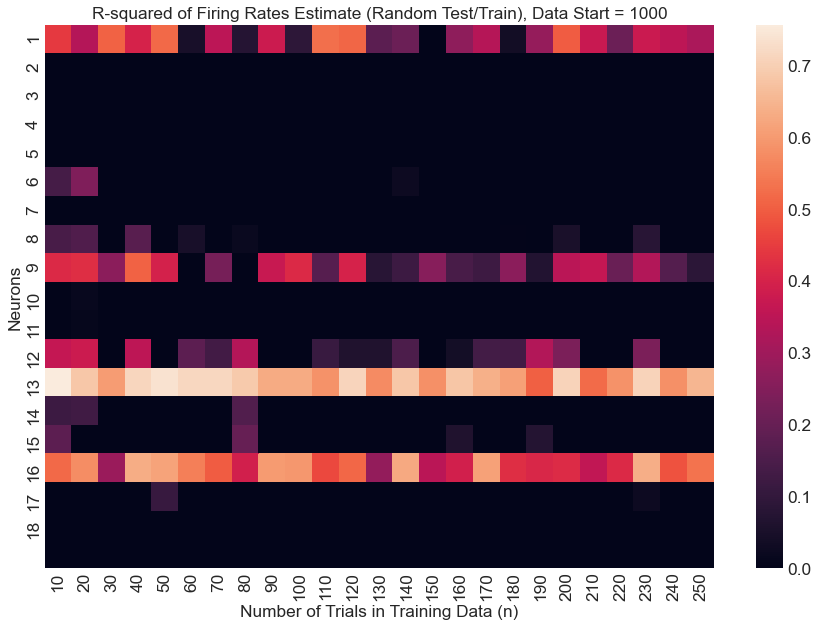

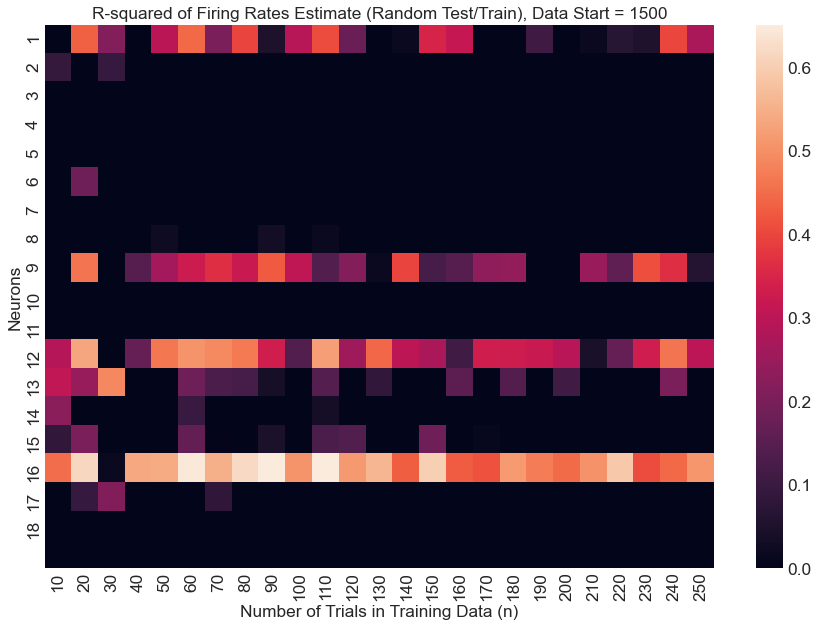

In [92]:
k_size = int(windowSize/2)
off_array = np.array([0, 500, 1000, 1500])
for idx_off, val_off in enumerate(off_array):
    data_offset = val_off
    
    idx_array = np.arange(0, 500)
    test_array = np.arange(10, k_size + 10, 10)
    rsquared_ = np.zeros((numNeurons, len(test_array)))
     
    for idx, val in enumerate(test_array):
        n_size = val

        # returns array of iD size of random indices in idx_array
        randIndx = np.random.choice(idx_array, n_size + k_size) 

        # separate into k and n indices
        n_ = randIndx[:n_size]
        k_ = randIndx[n_size:]

        # train on n_
        fr_train = standardizeArray(n_dataSum[:, n_ + data_offset])
        targ_train = n_targ[:, n_ + data_offset][1:]
        w_estimate, solve, resdVect = findW_leastSquares(fr_train, targ_train, numNeurons, numDim)
        w_estimate = w_estimate.value

        # test with k_
        fr_test = standardizeArray(n_dataSum[:, k_ + data_offset])
        targ_test =  n_targ[:, k_ + data_offset][1:]
        fr_estimate = w_estimate@targ_test
        (R2, SStot, SSres) = findRsquared(fr_test, fr_estimate, numNeurons)
        R2[R2 < 0] = 0
        rsquared_[:, idx] = R2

    f,ax = plt.subplots(figsize=(15, 10))

    ax = seaborn.heatmap(rsquared_, xticklabels=test_array, yticklabels = np.arange(1, numNeurons, 1))
    plt.ylabel("Neurons")
    plt.xlabel("Number of Trials in Training Data (n)")
    plt.title("R-squared of Firing Rates Estimate (Random Test/Train), Data Start = " + str(data_offset))

## n/k test/train with sliding window -- to determine where to start the test window data

Sweep across window

Starting at 0 to 250, choose an n and sweep across - overlap by 5 each time

Find r^squared


In [93]:
start = 0
n_size = 100
k_size = 250
t = np.arange(start = 100, stop = k_size + 100 - n_size, step = 50 , dtype = int)
t.shape

(3,)

In [94]:
# CHANGE THIS FOR CHANGING THE NEURAL DATA SUMMING
sumStart = 22
sumWindow = 5
sumEnd = sumStart + sumWindow
n_dataSum = np.sum(n_data[sumStart:sumEnd, :, :], axis=0)
print(n_dataSum.shape)
print(n_dataSum.shape[-1])

(19, 2047)
2047


In [95]:
windowSize = 500
k_size = int(windowSize/2)
off_array = np.array([0, 500, 1000, 1500])
n_array = np.array([20, 30, 40, 50, 60, 70, 80, 90, 100])
n_step = 10
test_array = np.arange(10, k_size + 10, 10)

In [96]:
n_dataSum[:, k_size:windowSize].shape
len(n_array)
rsquared_.shape
n_rsqd_mean = np.zeros((numNeurons, len(n_array), len(off_array)))
n_rsqd_mean.shape

(19, 9, 4)

In [97]:
t_max = np.arange(start = 0, stop = k_size - np.min(n_array), step = n_step , dtype = int)

# n_rsqd = neurons x length of train window x offset of data x number of time steps in the data
n_rsqd = np.zeros((numNeurons, len(n_array), len(off_array), len(t_max))) 

# n_rsqd_mean_size = np.zeros((numNeurons, len(n_array), len(off_array)))
# n_rsqd_max_size = np.zeros((numNeurons, len(n_array), len(off_array)))

In [98]:
for idx_n, val_n in enumerate(n_array):
    n_size = val_n
    print("N SIZE: ", n_size)
    
    for idx_off, val_off in enumerate(off_array):
        data_offset = val_off
        # t_array goes from the start of the data window to the n_size before the training window starts and increments in n_step
        # t_array is supposed to mark the start of the training data
        t_array = np.arange(start = data_offset, stop = k_size + data_offset - n_size, step = n_step , dtype = int)
        print("t array: ", t_array.shape)
        rsquared_ = np.zeros((numNeurons, len(test_array)))

        for idx, val in enumerate(t_array):
            # training window starts at different element of n
            n_start = val     

            # train on n_
            fr_train = standardizeArray(n_dataSum[:, n_start:n_start+n_size])
            targ_train = n_targ[:, n_start:n_start+n_size][1:]
            # tested: training data size matched n_size
            w_estimate, solve, resdVect = findW_leastSquares(fr_train, targ_train, numNeurons, numDim)
            w_estimate = w_estimate.value

            # test with k_
            fr_test = standardizeArray(n_dataSum[:, k_size + data_offset : windowSize + data_offset])
            targ_test =  n_targ[:, k_size + data_offset : windowSize + data_offset][1:]
            # tested: test data size is k_size
            fr_estimate = w_estimate@targ_test
            (R2, SStot, SSres) = findRsquared(fr_test, fr_estimate, numNeurons)
            R2[R2 < 0] = 0
            rsquared_[:, idx] = R2
#             print(rsquared_.shape)
#             print("mean: ", np.mean(rsquared_, axis=1))
#             print("max: ", np.percentile(rsquared_, 75, axis=1))
#             n_rsqd_mean[:, idx_n, idx_off] = np.mean(rsquared_, axis=1)
#             n_rsqd_max[:, idx_n, idx_off] = np.percentile(rsquared_, 75, axis=1)
            n_rsqd[:, idx_n, idx_off, idx] = R2
            
        
#         f,ax = plt.subplots(figsize=(15, 10))

#         ax = seaborn.heatmap(rsquared_, xticklabels=test_array+data_offset, yticklabels = np.arange(1, numNeurons, 1))
#         plt.ylabel("Neurons")
#         plt.xlabel("Start of Training Data Within Window (n_start)")
#         plt.title("R-squared of Firing Rates Estimate (Random Test/Train), Train Size = " + str(n_size))

N SIZE:  20
t array:  (23,)
t array:  (23,)
t array:  (23,)
t array:  (23,)
N SIZE:  30
t array:  (22,)
t array:  (22,)
t array:  (22,)
t array:  (22,)
N SIZE:  40
t array:  (21,)
t array:  (21,)
t array:  (21,)
t array:  (21,)
N SIZE:  50
t array:  (20,)
t array:  (20,)
t array:  (20,)
t array:  (20,)
N SIZE:  60
t array:  (19,)
t array:  (19,)
t array:  (19,)
t array:  (19,)
N SIZE:  70
t array:  (18,)
t array:  (18,)
t array:  (18,)
t array:  (18,)
N SIZE:  80
t array:  (17,)
t array:  (17,)
t array:  (17,)
t array:  (17,)
N SIZE:  90
t array:  (16,)
t array:  (16,)
t array:  (16,)
t array:  (16,)
N SIZE:  100
t array:  (15,)
t array:  (15,)
t array:  (15,)
t array:  (15,)


In [99]:
# n_rsqd = neurons x length of train window x offset of data x number of time steps in the data
n_rsqd.shape

(19, 9, 4, 23)

Which n_size has the best r_squared?

In [100]:
# n_rsqd_mean is the mean of the r-squared values across starting position
n_rsqd_mean = np.mean(n_rsqd, axis=3)

# n_rsqd_max is the max (75%) of the r-squared values across starting position
n_rsqd_max = np.percentile(n_rsqd, 75, axis=3)
print(n_rsqd_mean.shape)
print(n_rsqd_max.shape)

(19, 9, 4)
(19, 9, 4)


In [101]:
n_rsqd_mean[1, :, 0].shape

(9,)

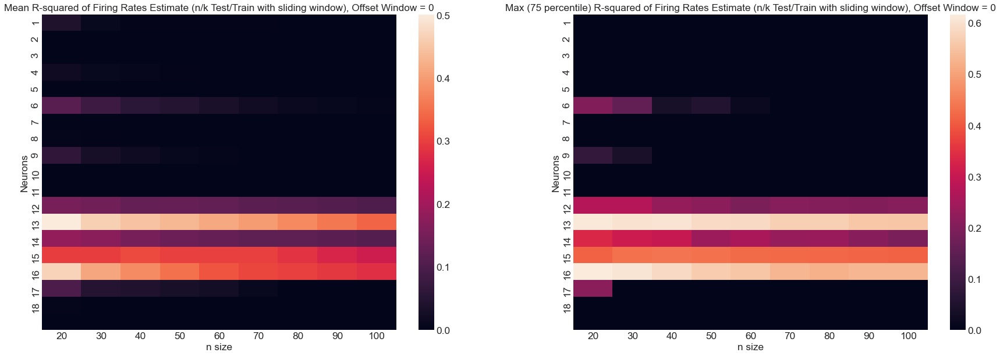

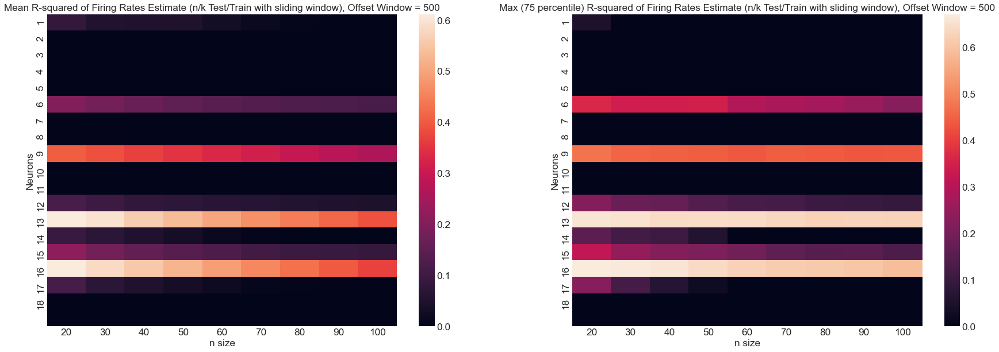

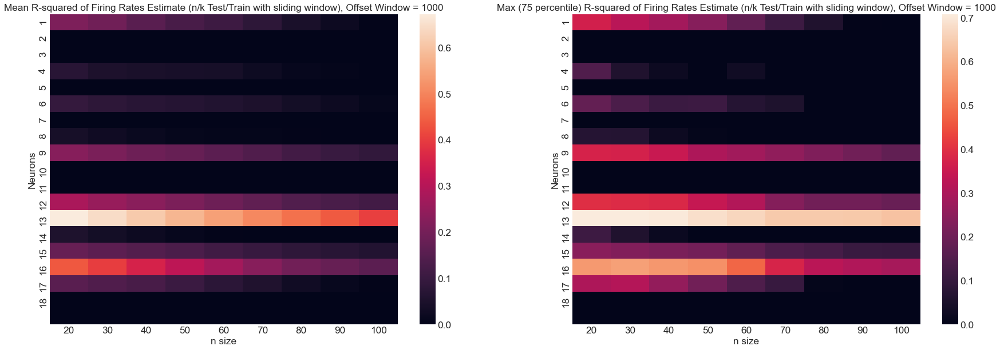

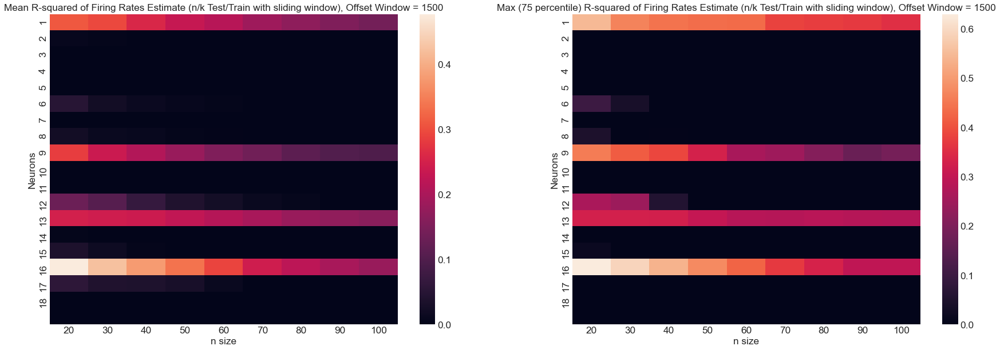

In [102]:
 for idx_off, val_off in enumerate(off_array):
        f,ax = plt.subplots(figsize=(30, 10))
        plt.subplot(1, 2, 1)
        ax = seaborn.heatmap(n_rsqd_mean[:, :, idx_off], xticklabels=n_array, yticklabels = np.arange(1, numNeurons, 1))
        plt.ylabel("Neurons")
        plt.xlabel("n size")
        plt.title("Mean R-squared of Firing Rates Estimate (n/k Test/Train with sliding window), Offset Window = " + str(val_off))
        
#         f,ax = plt.subplots(figsize=(15, 10))
        plt.subplot(1, 2, 2)
        ax = seaborn.heatmap(n_rsqd_max[:, :, idx_off], xticklabels=n_array, yticklabels = np.arange(1, numNeurons, 1))
        plt.ylabel("Neurons")
        plt.xlabel("n size")
        plt.title("Max (75 percentile) R-squared of Firing Rates Estimate (n/k Test/Train with sliding window), Offset Window = " + str(val_off))   
        
#         print("Offset Window =", val_off)
#         for iN in range(numNeurons):
#             print("Neuron #", iN, "Argmax of Mean r-squared (Train Size): ", n_array[np.argmax(n_rsqd_mean[iN, :, idx_off])] )
#             print("Neuron #", iN, "Argmax of Max Percentile r-squared (Train Size): ", n_array[np.argmax(n_rsqd_max[iN, :, idx_off])] )
#             print("")

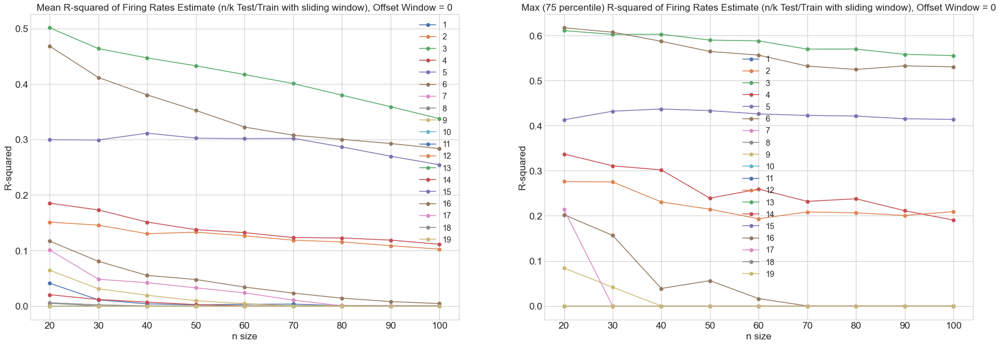

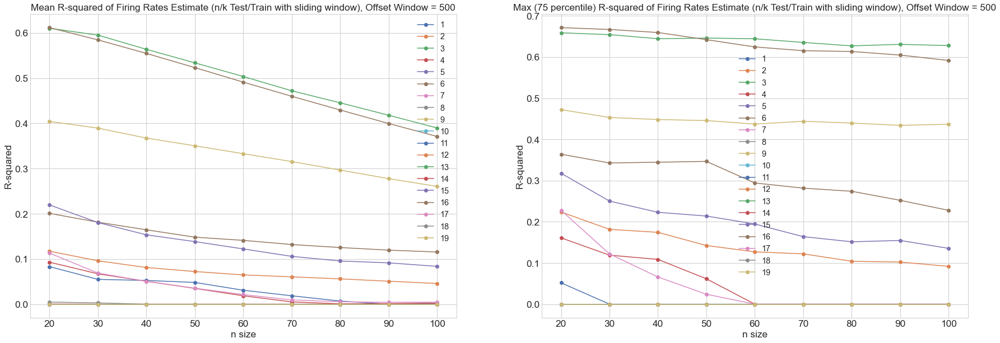

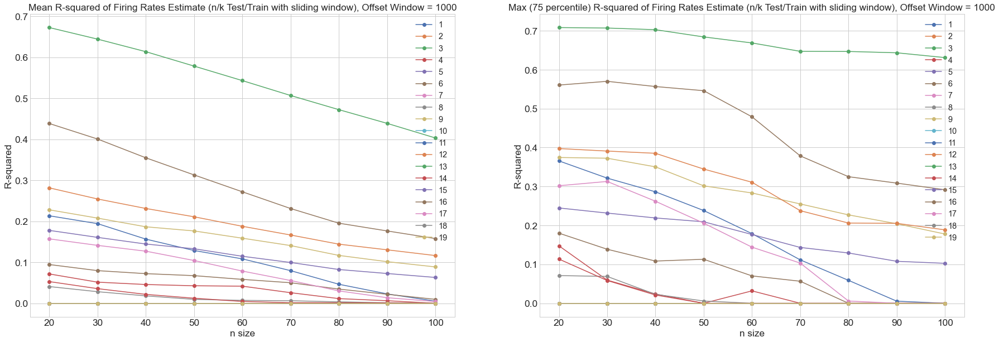

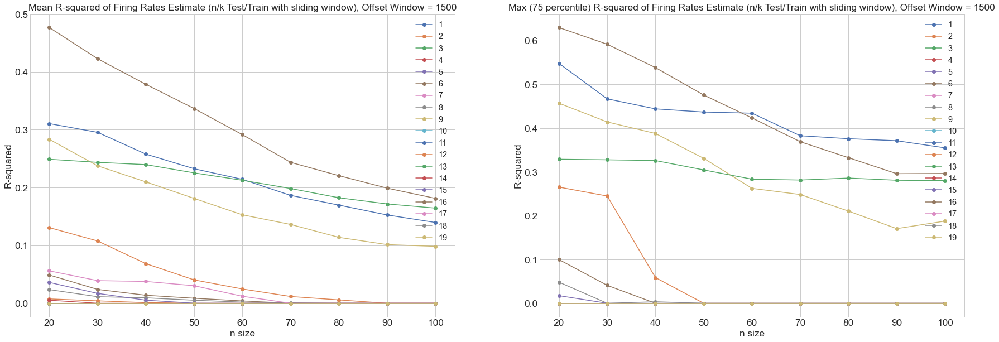

In [103]:
 for idx_off, val_off in enumerate(off_array):
        f,ax = plt.subplots(figsize=(30, 10))
        plt.subplot(1, 2, 1)
        
        for iN in range(numNeurons):
            ax = plt.plot(n_array, n_rsqd_mean[iN, :, idx_off].T, '-o', label=iN+1) # , xticklabels=n_array, yticklabels = np.arange(1, numNeurons, 1))
        
        plt.ylabel("R-squared")
        plt.xlabel("n size")
        plt.title("Mean R-squared of Firing Rates Estimate (n/k Test/Train with sliding window), Offset Window = " + str(val_off))
        plt.legend()
        
#         f,ax = plt.subplots(figsize=(15, 10))
        plt.subplot(1, 2, 2)
        for iN in range(numNeurons):
            ax = plt.plot(n_array, n_rsqd_max[iN, :, idx_off].T, '-o', label=iN+1) #, xticklabels=n_array, yticklabels = np.arange(1, numNeurons, 1))
        
        plt.ylabel("R-squared")
        plt.xlabel("n size")
        plt.title("Max (75 percentile) R-squared of Firing Rates Estimate (n/k Test/Train with sliding window), Offset Window = " + str(val_off))   
        plt.legend()
        
#         print("Offset Window =", val_off)
#         for iN in range(numNeurons):
#             print("Neuron #", iN, "Argmax of Mean r-squared (Train Size): ", n_array[np.argmax(n_rsqd_mean[iN, :, idx_off])] )
#             print("Neuron #", iN, "Argmax of Max Percentile r-squared (Train Size): ", n_array[np.argmax(n_rsqd_max[iN, :, idx_off])] )
#             print("")

## Try separating by target

In [104]:
n_dataSum.shape

(19, 2047)

In [105]:
(n_sumT1, n_sumT2, n_sumT3, n_sumT4, n_sumT5, n_sumT6, n_sumT7, n_sumT8) = sortTargetNeuralData(n_dataSum, targVect)

Starting nData dims 2
nData shape (1, 19, 2047)


In [106]:
# print(n_sumT1.shape)
# print(n_sumT2.shape)
# print(n_sumT3.shape)
# print(n_sumT4.shape)
# print(n_sumT5.shape)
# print(n_sumT6.shape)
# print(n_sumT7.shape)
# print(n_sumT8.shape)

In [107]:
# dict_n_sum = {"n_sumT1": np.squeeze(n_sumT1), 
#               "n_sumT2": np.squeeze(n_sumT2),
#               "n_sumT3": np.squeeze(n_sumT3),
#               "n_sumT4": np.squeeze(n_sumT4), 
#               "n_sumT5": np.squeeze(n_sumT5),
#               "n_sumT6": np.squeeze(n_sumT6),
#               "n_sumT7": np.squeeze(n_sumT7), 
#               "n_sumT8": np.squeeze(n_sumT8)
#              }

In [108]:
# for iTn in range(1, 9, 1):
#     print(dict_n_sum["n_sumT"+ str(iTn)].shape)

In [109]:
# close files to save
pdf.close()